###  Repeat Buyer Prediction
Predict the probability that these new buyers would purchase items from the same merchants again within 6 months.
(which new buyers for given merchants will become loyal customers in the future.)

train data set contains anonymized users' shopping logs **in the past 6 months before and on the "Double 11" day.**


In [3]:
import pandas as pd
import numpy as np
import datetime as dt
import matplotlib.pyplot as plt
# import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from matplotlib.font_manager import FontProperties
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from tqdm import tqdm

fontproperties = FontProperties(fname = 'font_ch.ttf', size = 14)
font = 'font_ch.ttf'


#### import data


In [2]:
fm1_train = pd.read_csv('data_format1/train_format1.csv')  # label=1: user_id is a repeat buyer for that merchant_id; label=0 is the opposite; -1: user_id is not a new customer of that merchant
len(fm1_train)
fm1_train.head()
fm1_test = pd.read_csv('data_format1/test_format1.csv')
len(fm1_test)
fm1_test.head()
fm1_user = pd.read_csv('data_format1/user_info_format1.csv')
len(fm1_user)
fm1_user.head()
fm1_userLog = pd.read_csv('data_format1/user_log_format1.csv')  # 0 is for click, 1 is for add-to-cart, 2 is for purchase and 3 is for add-to-favourite
fm1_userLog.rename(columns={'seller_id': 'merchant_id'}, inplace=True)
len(fm1_userLog)
fm1_userLog.head()
fm2_train = pd.read_csv('data_format2/train_format2.csv')
len(fm2_train)
fm2_train.head()
fm2_test = pd.read_csv('data_format2/test_format2.csv')
len(fm2_test)
fm2_test.head()


260864

,user_id,merchant_id,label
0,34176,3906,0
1,34176,121,0
2,34176,4356,1
3,34176,2217,0
4,230784,4818,0


261477

,user_id,merchant_id,prob
0,163968,4605,NaN
1,360576,1581,NaN
2,98688,1964,NaN
3,98688,3645,NaN
4,295296,3361,NaN


424170

,user_id,age_range,gender
0,376517,6.0,1.0
1,234512,5.0,0.0
2,344532,5.0,0.0
3,186135,5.0,0.0
4,30230,5.0,0.0


54925330

,user_id,item_id,cat_id,merchant_id,brand_id,time_stamp,action_type
0,328862,323294,833,2882,2661.0,829,0
1,328862,844400,1271,2882,2661.0,829,0
2,328862,575153,1271,2882,2661.0,829,0
3,328862,996875,1271,2882,2661.0,829,0
4,328862,1086186,1271,1253,1049.0,829,0


7030723

,user_id,age_range,gender,merchant_id,label,activity_log
0,34176,6.0,0.0,944,-1,408895:1505:7370:1107:0
1,34176,6.0,0.0,412,-1,17235:1604:4396:0818:0#954723:1604:4396:0818:0...
2,34176,6.0,0.0,1945,-1,231901:662:2758:0818:0#231901:662:2758:0818:0#...
3,34176,6.0,0.0,4752,-1,174142:821:6938:1027:0
4,34176,6.0,0.0,643,-1,716371:1505:968:1024:3


7027943

,user_id,age_range,gender,merchant_id,label,activity_log
0,163968,0.0,0.0,4378,-1.0,101206:812:6968:0614:0
1,163968,0.0,0.0,2300,-1.0,588758:844:3833:0618:0#71782:844:3833:1111:2#7...
2,163968,0.0,0.0,1551,-1.0,312747:243:1954:0627:0#312747:243:1954:0627:0#...
3,163968,0.0,0.0,4343,-1.0,932390:1612:3201:0628:0
4,163968,0.0,0.0,4911,-1.0,957657:662:3089:0612:0


In [17]:
# merge label data 
df = pd.merge(fm1_userLog, fm1_train, on=['user_id', 'merchant_id'], how='left')
df = pd.merge(df, fm1_user, on='user_id', how='left')
df.shape
df.head()
df.isnull().sum() / len(df)
# -> label 缺失值太多，但目前只有要做 sequence clustering，這個問題先放
df['brand_id'] = df['brand_id'].fillna('unknown')
df['age_range'] = df['age_range'].fillna(df.groupby(['age_range']).size().argmax())
df['gender'] = df['gender'].fillna(df.groupby(['gender']).size().argmax())
df['label'] = df['label'].fillna('-')
df.isnull().sum() / len(df)
# df.drop(['label'],axis=1,inplace=True)
df.to_pickle('TMall_for_user_states_define.pkl')


(54925330, 10)

,user_id,item_id,cat_id,merchant_id,brand_id,time_stamp,action_type,label,age_range,gender
0,328862,323294,833,2882,2661.0,829,0,NaN,6.0,1.0
1,328862,844400,1271,2882,2661.0,829,0,NaN,6.0,1.0
2,328862,575153,1271,2882,2661.0,829,0,NaN,6.0,1.0
3,328862,996875,1271,2882,2661.0,829,0,NaN,6.0,1.0
4,328862,1086186,1271,1253,1049.0,829,0,NaN,6.0,1.0


user_id        0.000000
item_id        0.000000
cat_id         0.000000
merchant_id    0.000000
brand_id       0.001657
time_stamp     0.000000
action_type    0.000000
label          0.948580
age_range      0.002334
gender         0.007674
dtype: float64

user_id        0.0
item_id        0.0
cat_id         0.0
merchant_id    0.0
brand_id       0.0
time_stamp     0.0
action_type    0.0
label          0.0
age_range      0.0
gender         0.0
dtype: float64

In [17]:
# #看各類別的數量
# for c in ['merchant_id','label','item_id','cat_id','seller_id','brand_id','action_type']:
#     fm1_train.groupby([c]).size().reset_index()


In [9]:
#action_type分成意圖動作(0,1,3)和購買動作(2)，add-to-favorite加權2倍，add-to-cart加權3倍(暫時)
df_click = df[df['action_type'] != 2]
df_purchase = df[df['action_type'] == 2]
df_click['action_score'] = 0
def type_to_score(x):
    if x == 0:
        return 1
    elif x == 1:
        return 3
    else:
        return 2
df_click['action_score'] = df['action_type'].apply(lambda x: type_to_score(x))

#cat_id維度爆大，只留下前37個資訊較多的cat
t1 = df.groupby(['cat_id'])['user_id'].count().reset_index().sort_values('user_id')
selected_catID = t1[t1['user_id'] > 500000].cat_id.unique()
df_ = df[df['cat_id'].isin(selected_catID)]
# df_click_ = df_click[df_click['cat_id'].isin(selected_catID)]
df_purchase_ = df_purchase[df_purchase['cat_id'].isin(selected_catID)]

#最多人購買的時間點: 1111 => 用它當作目標預測時間點 => 得出目標所有 buyers => 製作每人的矩陣
df_purchase_.groupby(['time_stamp'])['action_type'].count().reset_index().sort_values('action_type')
df_purchase_ = df_purchase_[df_purchase_['time_stamp'] == 1111]
df_purchase_g = df_purchase_.groupby(['user_id','cat_id','time_stamp'])['action_type'].count().reset_index()
df_purchase_pivot = df_purchase_g.pivot(columns='cat_id', index='user_id', values='action_type').fillna(0.0)
buyers = df_purchase_pivot.index
catIDs = df_purchase_pivot.columns


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


,time_stamp,action_type
70,720,3351
85,804,3424
91,810,3470
77,727,3595
84,803,3639
...,...,...
109,828,11738
163,1021,12342
121,909,18224
46,626,23131


In [5]:
#511–1112

#更新 df_click 包含的cat_id 資訊 及 time_stamp(511–1110)
df_click_ = df_click[(df_click['cat_id'].isin(catIDs)) & (df_click['time_stamp']<1111)]
nonBuyers = df_click_[~df_click_['user_id'].isin(buyers)]['user_id'].unique()[:1000]
print(f'len of nonBuyers: {len(nonBuyers)}')
tot = list(nonBuyers)+list(buyers[:1000])

#產生所有訓練對象的 click window (用.py run)

# tmall_rep1 = []
# for u in tqdm(tot):
#     tmp = df_click_[df_click_['user_id'] == u]
#     tmp = tmp.groupby(['user_id', 'time_stamp', 'cat_id']).sum()['action_score'].reset_index()
#     tmp = tmp.pivot(columns='cat_id', index='time_stamp', values='action_score').fillna(0.0)

#     for cat in df_click_['cat_id'].unique():
#         if cat not in tmp.columns:
#             tmp.insert(0, cat, 0.0)
#     for i in range(511, 1110):
#         if i not in tmp.index:
#             tmp.loc[i] = np.zeros(37)

#     tmp = tmp.sort_values('time_stamp')
#     tmp = tmp.to_numpy()
#     tmall_rep1.append(tmp)

# np.savez('v1_200501_click_window_511_1110.npz', *tmall_rep1)


len of nonBuyers: 1000


In [14]:
tmallo_rep1 = []
for u in tqdm(tot):
    try:
        tmpo = df_purchase_pivot[df_purchase_pivot.index == u].values[0]
        print(tmpo)
    except:
        tmpo = pd.DataFrame(np.zeros((1, 37)), columns=df_purchase_pivot.columns).reset_index()
        tmpo = tmpo.to_numpy()
    
    tmallo_rep1.append(tmpo)

tmallo_rep1

 60%|██████    | 1201/2000 [00:01<00:00, 932.61it/s]

[0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 2. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 1. 0. 0. 0. 0.

 71%|███████   | 1415/2000 [00:01<00:00, 997.00it/s]

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0.]
[0. 0. 0. 0. 6. 0. 0. 0. 6. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 2. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 1. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 2. 0. 2.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0.

 82%|████████▏ | 1638/2000 [00:01<00:00, 1051.58it/s]

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 3. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 3. 0. 0.]
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 1.

 93%|█████████▎| 1856/2000 [00:02<00:00, 1068.22it/s]

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[0. 4. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0.

100%|██████████| 2000/2000 [00:02<00:00, 931.20it/s] 


[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0.
 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0.

[array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0.]]),
 array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0.]]),
 array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0.]]),
 array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0.]]),
 array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 0., 0., 0., 0.]]),
 array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0., 0., 

In [21]:
np.savez('v1_200501_purchase_window_1111_size1000fortest.npz', *tmallo_rep1)


### EDA


In [4]:
# df_origin = pd.read_pickle('TMall_for_user_states_define.pkl')
df = pd.read_pickle('TMall_for_user_states_define_transformed.pkl')
# df_origin.shape
# df_origin.head()
# df_origin.groupby(['time_stamp','action_type'])['item_id'].count().reset_index().rename(columns={'item_id': 'count'})


(array([84937., 90540., 68086., 48532., 34508., 24644., 17884., 13148.,
         9730.,  7152.,  5626.,  4126.,  3175.,  2404.,  1944.,  1535.,
         1130.,   903.,   779.,   583.]),
 array([ 1.  ,  2.95,  4.9 ,  6.85,  8.8 , 10.75, 12.7 , 14.65, 16.6 ,
        18.55, 20.5 , 22.45, 24.4 , 26.35, 28.3 , 30.25, 32.2 , 34.15,
        36.1 , 38.05, 40.  ]),
 <a list of 20 Patch objects>)

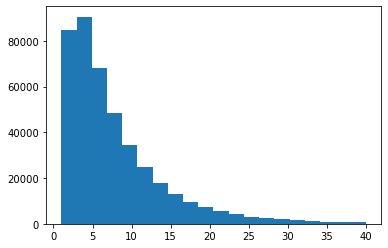

In [5]:
tmp = df.groupby(['user_id'])['purchase'].sum().reset_index()
plt.hist(tmp.purchase, bins=20, range=[1, 40])


In [37]:
df[(df['day_stamp']==184)&(df['purchase']>0)]#.user_id.unique().shape  # 雙11當天購買



,user_id,item_id,cat_id,merchant_id,brand_id,time_stamp,label,age_range,gender,click,add_to_cart,purchase,add_to_favorite,day,month,dayOfWeek,day_stamp
174,328862,406349,1280,2700,5476,1111,-,6.0,1.0,0,0,1,0,11,11,1,184
429,234512,240182,81,3018,4144,1111,0,5.0,0.0,0,0,1,0,11,11,1,184
430,234512,137298,1432,3271,6957,1111,0,5.0,0.0,0,0,1,0,11,11,1,184
432,234512,179830,1208,546,2276,1111,-,5.0,0.0,0,0,1,0,11,11,1,184
601,356311,964080,664,1783,5041,1111,-,5.0,0.0,0,0,1,0,11,11,1,184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54925253,128038,1022583,883,2031,2446,1111,-,2.0,0.0,0,0,1,0,11,11,1,184
54925254,128038,1083994,748,2002,3940,1111,-,2.0,0.0,0,0,1,0,11,11,1,184
54925273,34885,490526,1620,3444,5308,1111,0,0.0,1.0,0,0,1,0,11,11,1,184
54925276,208016,51712,898,3763,8434,1111,0,3.0,0.0,0,0,1,0,11,11,1,184


In [5]:
### date table 
date_table = df[['day_stamp','time_stamp','month','day','dayOfWeek']].drop_duplicates().sort_values('day_stamp').reset_index().drop('index', axis=1)
date_table.head(30)


,day_stamp,time_stamp,month,day,dayOfWeek
0,0,511,5,11,6
1,1,512,5,12,7
2,2,513,5,13,1
3,3,514,5,14,2
4,4,515,5,15,3
5,5,516,5,16,4
6,6,517,5,17,5
7,7,518,5,18,6
8,8,519,5,19,7
9,9,520,5,20,1


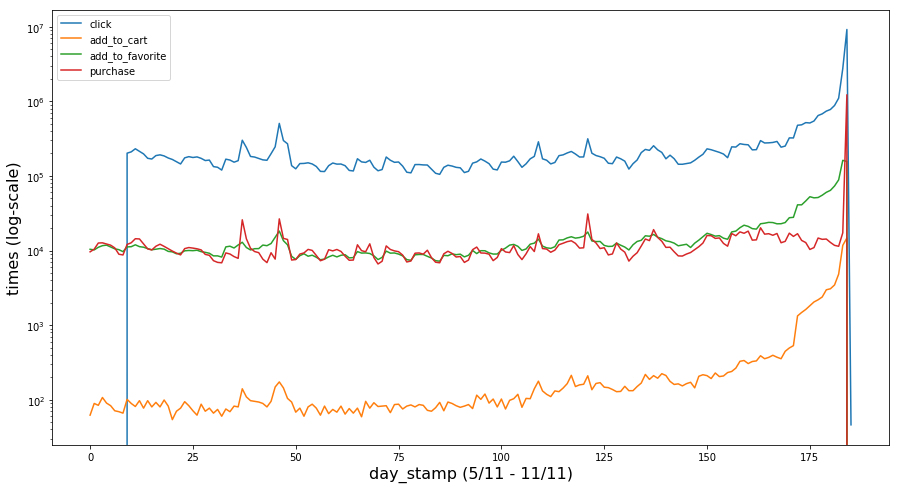

In [8]:
### 0. 整個時間軸的流量及銷售消長

action_list = ['click','add_to_cart','add_to_favorite','purchase']
tmp_0 = df.groupby(['day_stamp'])['click','add_to_cart','add_to_favorite','purchase'].sum().reset_index()
tmp_0 = pd.concat([date_table[['month','day','dayOfWeek']], tmp_0], axis=1)
tmp_0.head(10)

plt.figure(figsize=(15,8))
plt.plot(tmp_0['day_stamp'], tmp_0[action_list])
plt.yscale('log')
plt.ylabel('times (log-scale)', fontsize=16)
plt.xlabel('day_stamp (5/11 - 11/11)', fontsize=16)
plt.legend(action_list)
plt.show();


### Missing Click Values Imputation

In [55]:
###Use logistic regression to impute the missing click values in time-series
from sklearn.linear_model import LogisticRegression

X_relatedtoClick = tmp_0.iloc[9:186, 5:8].values
y_click = tmp_0.iloc[9:186, 4].values
X_needPredict = tmp_0.iloc[:9, 5:8].values
lr = LogisticRegression(random_state=98).fit(X_relatedtoClick, y_click)
y_predclick = lr.predict(X_needPredict)

tmp_0.iloc[:9, 4] = y_predclick
tmp_0

lr.score(X_relatedtoClick, y_click)
lr.coef_.shape

0.1864406779661017

(177, 3)

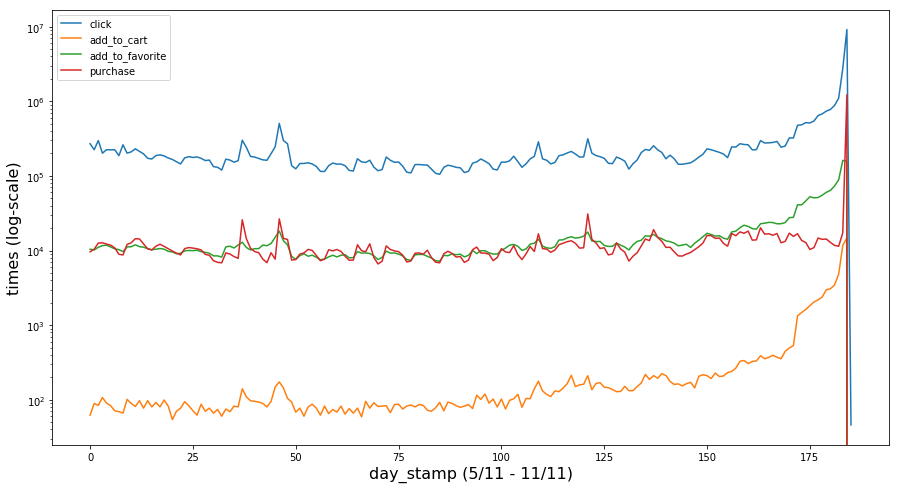

In [56]:
plt.figure(figsize=(15,8))
plt.plot(tmp_0['day_stamp'], tmp_0[action_list])
plt.yscale('log')
plt.ylabel('times (log-scale)', fontsize=16)
plt.xlabel('day_stamp (5/11 - 11/11)', fontsize=16)
plt.legend(action_list)
plt.show();


In [57]:
### 類別資料不重複數

df_1111 = df[df['time_stamp']==1111].reset_index().drop(['day','month','dayOfWeek','day_stamp','time_stamp','index'], axis=1)
df_1111.head(10)
print('Unique users on 11/11: ', len(df_1111.user_id.unique()))
print('Unique items viewed on 11/11: ', len(df_1111.item_id.unique()))
print('Unique categories viewed on 11/11: ', len(df_1111.cat_id.unique()))
print('Unique merchants viewed on 11/11: ', len(df_1111.merchant_id.unique()))
print('Unique brands viewed on 11/11: ', len(df_1111.brand_id.unique()))

df_non1111 = df[df['time_stamp']!=1111].reset_index().drop(['day','month','dayOfWeek','day_stamp','time_stamp','index'], axis=1)
df_non1111.head(10)
print('Unique users before 11/11: ', len(df_non1111.user_id.unique()))
print('Unique items viewed before 11/11: ', len(df_non1111.item_id.unique()))
print('Unique categories viewed before 11/11: ', len(df_non1111.cat_id.unique()))
print('Unique merchants viewed before 11/11: ', len(df_non1111.merchant_id.unique()))
print('Unique brands viewed before 11/11: ', len(df_non1111.brand_id.unique()))


,user_id,item_id,cat_id,merchant_id,brand_id,label,age_range,gender,click,add_to_cart,purchase,add_to_favorite
0,328862,406349,1280,2700,5476,-,6.0,1.0,1,0,0,0
1,328862,406349,1280,2700,5476,-,6.0,1.0,1,0,0,0
2,328862,807126,1181,1963,6109,-,6.0,1.0,1,0,0,0
3,328862,406349,1280,2700,5476,-,6.0,1.0,0,0,1,0
4,328862,406349,1280,2700,5476,-,6.0,1.0,1,0,0,0
5,328862,406349,1280,2700,5476,-,6.0,1.0,1,0,0,0
6,328862,406349,1280,2700,5476,-,6.0,1.0,1,0,0,0
7,328862,406349,1280,2700,5476,-,6.0,1.0,1,0,0,0
8,328862,406349,1280,2700,5476,-,6.0,1.0,1,0,0,0
9,234512,399860,962,305,6300,-,5.0,0.0,1,0,0,0


Unique users on 11/11:  424170
Unique items viewed on 11/11:  436634
Unique categories viewed on 11/11:  1389
Unique merchants viewed on 11/11:  4993
Unique brands viewed on 11/11:  6985


,user_id,item_id,cat_id,merchant_id,brand_id,label,age_range,gender,click,add_to_cart,purchase,add_to_favorite
0,328862,323294,833,2882,2661,-,6.0,1.0,1,0,0,0
1,328862,844400,1271,2882,2661,-,6.0,1.0,1,0,0,0
2,328862,575153,1271,2882,2661,-,6.0,1.0,1,0,0,0
3,328862,996875,1271,2882,2661,-,6.0,1.0,1,0,0,0
4,328862,1086186,1271,1253,1049,-,6.0,1.0,1,0,0,0
5,328862,623866,1271,2882,2661,-,6.0,1.0,1,0,0,0
6,328862,542871,1467,2882,2661,-,6.0,1.0,1,0,0,0
7,328862,536347,1095,883,1647,-,6.0,1.0,1,0,0,0
8,328862,364513,1271,2882,2661,-,6.0,1.0,1,0,0,0
9,328862,575153,1271,2882,2661,-,6.0,1.0,1,0,0,0


Unique users before 11/11:  424170
Unique items viewed before 11/11:  1053994
Unique categories viewed before 11/11:  1652
Unique merchants viewed before 11/11:  4995
Unique brands viewed before 11/11:  8400


In [58]:
### 1. 雙11當天的事件數在 品類／商家／品牌／用戶屬性 中的分布
dimensions = ['user_id','item_id','cat_id','merchant_id','brand_id','label','age_range','gender']
for dimension in dimensions:
    for action in action_list:
        tmp_1 = df_1111.groupby([dimension])[action].sum().reset_index().sort_values(action, ascending=False)
        tmp_1['percentage'] = tmp_1[action] / tmp_1[action].sum() *100
        tmp_1['compare_to_avg'] = tmp_1['percentage'] - np.mean(tmp_1['percentage'].values)  # 高(+)/低(-)於平均值多少
        tmp_1.head(10)
        
for dimension in dimensions:
    for action in action_list:
        tmp_1 = df_non1111.groupby([dimension])[action].sum().reset_index().sort_values(action, ascending=False)
        tmp_1['percentage'] = tmp_1[action] / tmp_1[action].sum() *100
        tmp_1['compare_to_avg'] = tmp_1['percentage'] - np.mean(tmp_1['percentage'].values)  # 高(+)/低(-)於平均值多少
        tmp_1.head(10)


,user_id,click,percentage,compare_to_avg
112080,112081,7044.0,0.076664,0.076429
83652,83653,4139.0,0.045047,0.044812
391187,391188,3963.0,0.043132,0.042896
177384,177385,3571.0,0.038865,0.038630
349576,349577,3545.0,0.038582,0.038347
980,981,3368.0,0.036656,0.036420
313933,313934,3190.0,0.034719,0.034483
96723,96724,2558.0,0.027840,0.027605
163406,163407,2419.0,0.026328,0.026092
296477,296478,2349.0,0.025566,0.025330


,user_id,add_to_cart,percentage,compare_to_avg
343416,343417,24,0.162988,0.162752
44567,44568,13,0.088285,0.088049
194875,194876,12,0.081494,0.081258
377919,377920,12,0.081494,0.081258
109391,109392,11,0.074703,0.074467
265032,265033,11,0.074703,0.074467
334762,334763,11,0.074703,0.074467
94805,94806,11,0.074703,0.074467
220434,220435,11,0.074703,0.074467
162741,162742,11,0.074703,0.074467


,user_id,add_to_favorite,percentage,compare_to_avg
249364,249365,85,0.054330,0.054095
312981,312982,79,0.050495,0.050260
299514,299515,61,0.038990,0.038754
65999,66000,57,0.036433,0.036198
233003,233004,56,0.035794,0.035558
159884,159885,54,0.034516,0.034280
5005,5006,51,0.032598,0.032363
41427,41428,49,0.031320,0.031084
27354,27355,48,0.030681,0.030445
4296,4297,48,0.030681,0.030445


,user_id,purchase,percentage,compare_to_avg
265989,265990,126,0.010300,0.010064
306029,306030,62,0.005068,0.004832
135730,135731,58,0.004741,0.004505
306685,306686,55,0.004496,0.004260
221132,221133,51,0.004169,0.003933
216130,216131,49,0.004005,0.003770
261495,261496,48,0.003924,0.003688
390033,390034,47,0.003842,0.003606
198207,198208,44,0.003597,0.003361
408134,408135,42,0.003433,0.003197


,item_id,click,percentage,compare_to_avg
26462,67897,291475.0,3.172308,3.172079
307155,783997,148250.0,1.613499,1.613270
249564,636863,69304.0,0.754280,0.754051
301862,770668,19922.0,0.216824,0.216595
246470,628774,19188.0,0.208835,0.208606
401908,1024557,17382.0,0.189179,0.188950
36901,94609,11398.0,0.124052,0.123823
272830,696384,11066.0,0.120438,0.120209
138623,353560,9680.0,0.105354,0.105125
105764,269715,8486.0,0.092359,0.092130


,item_id,add_to_cart,percentage,compare_to_avg
138623,353560,29,0.196944,0.196715
242169,617878,23,0.156197,0.155968
123616,315345,18,0.122241,0.122012
75110,191499,16,0.108659,0.108430
307216,784134,15,0.101868,0.101639
331941,846908,15,0.101868,0.101639
430515,1097522,15,0.101868,0.101639
201802,514725,15,0.101868,0.101639
35080,89953,14,0.095076,0.094847
360090,918348,13,0.088285,0.088056


,item_id,add_to_favorite,percentage,compare_to_avg
371069,946001,1013.0,0.647491,0.647262
285682,729259,1007.0,0.643656,0.643427
178498,454937,670.0,0.428252,0.428023
26462,67897,613.0,0.391818,0.391589
192002,489523,374.0,0.239054,0.238825
31808,81550,363.0,0.232023,0.231794
256949,655904,342.0,0.218600,0.218371
307155,783997,330.0,0.210930,0.210701
161917,413046,287.0,0.183445,0.183216
297042,758374,239.0,0.152764,0.152535


,item_id,purchase,percentage,compare_to_avg
75110,191499,2332.0,0.190623,0.190394
138623,353560,2018.0,0.164956,0.164727
415749,1059899,1851.0,0.151305,0.151076
279572,713695,1659.0,0.135611,0.135382
407845,1039919,1467.0,0.119916,0.119687
86989,221663,1444.0,0.118036,0.117807
256949,655904,1325.0,0.108309,0.108080
31739,81360,1254.0,0.102505,0.102276
367135,936203,1202.0,0.098254,0.098025
41924,107407,1200.0,0.098091,0.097862


,cat_id,click,percentage,compare_to_avg
1127,1349,633403.0,6.893729,6.821735
555,656,424744.0,4.622760,4.550766
330,389,392985.0,4.277107,4.205112
954,1142,373732.0,4.067564,3.995570
560,662,334926.0,3.645213,3.573219
625,737,242319.0,2.637312,2.565318
1014,1208,207044.0,2.253392,2.181398
507,602,203200.0,2.211555,2.139561
1294,1553,189806.0,2.065780,1.993786
146,177,173042.0,1.883327,1.811332


,cat_id,add_to_cart,percentage,compare_to_avg
555,656,711.0,4.828523,4.756529
330,389,595.0,4.040747,3.968753
954,1142,542.0,3.680815,3.608821
625,737,522.0,3.544992,3.472997
560,662,477.0,3.239389,3.167395
1014,1208,379.0,2.573854,2.501860
994,1188,362.0,2.458404,2.386410
1294,1553,324.0,2.200340,2.128345
797,946,317.0,2.152801,2.080807
146,177,296.0,2.010187,1.938193


,cat_id,add_to_favorite,percentage,compare_to_avg
555,656,9947.0,6.357942,6.285948
330,389,8509.0,5.438798,5.366804
954,1142,7711.0,4.928731,4.856737
560,662,6974.0,4.457654,4.385660
915,1095,5398.0,3.450304,3.378309
625,737,5042.0,3.222755,3.150761
1294,1553,3975.0,2.540748,2.468754
797,946,2902.0,1.854906,1.782911
994,1188,2769.0,1.769895,1.697900
1014,1208,2648.0,1.692554,1.620559


,cat_id,purchase,percentage,compare_to_avg
555,656,48687.0,3.979797,3.907802
1014,1208,41951.0,3.429179,3.357185
507,602,29531.0,2.413937,2.341943
560,662,28883.0,2.360968,2.288974
625,737,28530.0,2.332113,2.260119
954,1142,28097.0,2.296719,2.224724
330,389,27372.0,2.237455,2.165461
146,177,26264.0,2.146885,2.074890
1019,1213,25851.0,2.113125,2.041131
1198,1438,23519.0,1.922502,1.850507


,merchant_id,click,percentage,compare_to_avg
183,184,489149.0,5.323721,5.303693
4042,4044,122651.0,1.334889,1.314861
3758,3760,110327.0,1.200759,1.180731
4171,4173,96541.0,1.050717,1.030689
3826,3828,90086.0,0.980463,0.960435
1101,1102,88331.0,0.961363,0.941335
0,1,73496.0,0.799904,0.779876
3489,3491,73463.0,0.799545,0.779517
3676,3678,69749.0,0.759123,0.739095
4255,4257,52113.0,0.567179,0.547151


,merchant_id,add_to_cart,percentage,compare_to_avg
4042,4044,164,1.113752,1.093724
3826,3828,145,0.984720,0.964692
0,1,122,0.828523,0.808495
3758,3760,120,0.814941,0.794913
4171,4173,114,0.774194,0.754166
3489,3491,97,0.658744,0.638716
4973,4976,93,0.631579,0.611551
3732,3734,83,0.563667,0.543639
4216,4218,81,0.550085,0.530057
1891,1892,67,0.455008,0.434980


,merchant_id,add_to_favorite,percentage,compare_to_avg
2386,2387,2813.0,1.798019,1.777990
3758,3760,2616.0,1.672100,1.652072
4042,4044,2459.0,1.571748,1.551720
3203,3205,1853.0,1.184404,1.164376
3826,3828,1550.0,0.990732,0.970704
1392,1393,1419.0,0.906999,0.886971
4171,4173,1384.0,0.884628,0.864600
3489,3491,1257.0,0.803452,0.783424
183,184,1186.0,0.758070,0.738042
1101,1102,1027.0,0.656440,0.636412


,merchant_id,purchase,percentage,compare_to_avg
3826,3828,10105.0,0.826008,0.805980
4042,4044,10075.0,0.823556,0.803528
1891,1892,8108.0,0.662768,0.642740
0,1,7537.0,0.616093,0.596065
1101,1102,7311.0,0.597619,0.577591
421,422,6780.0,0.554214,0.534186
4171,4173,6541.0,0.534678,0.514650
3758,3760,6519.0,0.532879,0.512851
1534,1535,6108.0,0.499283,0.479255
2384,2385,5585.0,0.456532,0.436504


,brand_id,click,percentage,compare_to_avg
1107,1360,497283.0,5.412248,5.397932
66,82,122651.0,1.334889,1.320573
3063,3738,112484.0,1.224235,1.209919
4416,5376,96541.0,1.050717,1.036401
1871,2276,93973.0,1.022768,1.008452
1176,1446,90086.0,0.980463,0.966147
6781,8235,88401.0,0.962125,0.947808
986,1214,88331.0,0.961363,0.947046
3259,3969,76383.0,0.831325,0.817009
5123,6215,70907.0,0.771726,0.757410


,brand_id,add_to_cart,percentage,compare_to_avg
6984,unknown,14698.0,99.816638,99.802322
4996,6066,2.0,0.013582,-0.000734
4773,5795,2.0,0.013582,-0.000734
1621,1981,1.0,0.006791,-0.007525
3530,4290,1.0,0.006791,-0.007525
6026,7319,1.0,0.006791,-0.007525
5153,6257,1.0,0.006791,-0.007525
1846,2240,1.0,0.006791,-0.007525
3171,3866,1.0,0.006791,-0.007525
566,721,1.0,0.006791,-0.007525


,brand_id,add_to_favorite,percentage,compare_to_avg
4976,6040,2813.0,1.798019,1.783702
3063,3738,2662.0,1.701502,1.687186
66,82,2459.0,1.571748,1.557432
1866,2270,1853.0,1.184404,1.170088
1176,1446,1550.0,0.990732,0.976415
3861,4705,1419.0,0.906999,0.892683
4416,5376,1384.0,0.884628,0.870311
3259,3969,1292.0,0.825823,0.811507
1107,1360,1282.0,0.819431,0.805115
1871,2276,1115.0,0.712688,0.698371


,brand_id,purchase,percentage,compare_to_avg
1871,2276,21895.0,1.789752,1.775435
6781,8235,12909.0,1.055214,1.040897
1176,1446,10105.0,0.826008,0.811691
66,82,10075.0,0.823556,0.809239
5423,6585,9272.0,0.757916,0.743600
986,1214,7311.0,0.597619,0.583303
1357,1662,7242.0,0.591979,0.577663
3530,4290,6862.0,0.560917,0.546601
3063,3738,6640.0,0.542770,0.528454
143,187,6586.0,0.538356,0.524040


,label,click,percentage,compare_to_avg
2,-,7903723.0,86.021262,52.687929
0,0,1172755.0,12.763841,-20.569492
1,1,111626.0,1.214897,-32.118436


,label,add_to_cart,percentage,compare_to_avg
2,-,12727.0,86.431239,53.097906
0,0,1906.0,12.943973,-20.389360
1,1,92.0,0.624788,-32.708546


,label,add_to_favorite,percentage,compare_to_avg
2,-,139144.0,88.938319,55.604986
0,0,15744.0,10.063279,-23.270054
1,1,1562.0,0.998402,-32.334931


,label,purchase,percentage,compare_to_avg
2,-,874009.0,71.443670,38.110337
0,0,323452.0,26.439771,-6.893562
1,1,25893.0,2.116558,-31.216775


,age_range,click,percentage,compare_to_avg
3,3.0,2618629.0,28.500211,17.389100
4,4.0,1967548.0,21.414081,10.302970
0,0.0,1735227.0,18.885583,7.774472
2,2.0,980796.0,10.674629,-0.436482
5,5.0,955971.0,10.404443,-0.706669
6,6.0,749948.0,8.162163,-2.948948
7,7.0,153206.0,1.667439,-9.443672
8,8.0,26498.0,0.288395,-10.822716
1,1.0,281.0,0.003058,-11.108053


,age_range,add_to_cart,percentage,compare_to_avg
0,0.0,4534.0,30.791171,19.680060
3,3.0,3846.0,26.118846,15.007734
4,4.0,2450.0,16.638370,5.527259
2,2.0,1324.0,8.991511,-2.119600
5,5.0,1271.0,8.631579,-2.479532
6,6.0,1089.0,7.395586,-3.715525
7,7.0,183.0,1.242784,-9.868327
8,8.0,28.0,0.190153,-10.920958
1,1.0,0.0,0.000000,-11.111111


,age_range,add_to_favorite,percentage,compare_to_avg
3,3.0,46227.0,29.547459,18.436348
0,0.0,30329.0,19.385746,8.274635
4,4.0,28994.0,18.532438,7.421327
2,2.0,23097.0,14.763183,3.652072
5,5.0,13312.0,8.508789,-2.602322
6,6.0,11831.0,7.562160,-3.548951
7,7.0,2306.0,1.473953,-9.637158
8,8.0,344.0,0.219879,-10.891233
1,1.0,10.0,0.006392,-11.104719


,age_range,purchase,percentage,compare_to_avg
3,3.0,332439.0,27.174391,16.063280
4,4.0,268549.0,21.951863,10.840752
0,0.0,237582.0,19.420544,8.309433
5,5.0,133480.0,10.910987,-0.200124
2,2.0,124637.0,10.188139,-0.922973
6,6.0,103774.0,8.482745,-2.628366
7,7.0,19363.0,1.582780,-9.528331
8,8.0,3476.0,0.284137,-10.826974
1,1.0,54.0,0.004414,-11.106697


,gender,click,percentage,compare_to_avg
0,0.0,6319190.0,68.775778,35.442445
1,1.0,2574516.0,28.020101,-5.313233
2,2.0,294398.0,3.204121,-30.129212


,gender,add_to_cart,percentage,compare_to_avg
0,0.0,9771.0,66.356537,33.023203
1,1.0,4724.0,32.081494,-1.251839
2,2.0,230.0,1.561969,-31.771364


,gender,add_to_favorite,percentage,compare_to_avg
0,0.0,120128.0,76.783637,43.450304
1,1.0,31301.0,20.007031,-13.326302
2,2.0,5021.0,3.209332,-30.124001


,gender,purchase,percentage,compare_to_avg
0,0.0,860482.0,70.337940,37.004606
1,1.0,323725.0,26.462087,-6.871246
2,2.0,39147.0,3.199973,-30.133360


,user_id,click,percentage,compare_to_avg
254262,254263,13539.0,0.034396,0.034160
276886,276887,11540.0,0.029317,0.029081
109250,109251,8684.0,0.022062,0.021826
23105,23106,7927.0,0.020138,0.019903
179073,179074,7600.0,0.019308,0.019072
421795,421796,6081.0,0.015449,0.015213
269578,269579,5700.0,0.014481,0.014245
64658,64659,5649.0,0.014351,0.014115
131475,131476,5429.0,0.013792,0.013557
356652,356653,5266.0,0.013378,0.013142


,user_id,add_to_cart,percentage,compare_to_avg
330086,330087,26,0.041919,0.041683
147570,147571,26,0.041919,0.041683
243960,243961,22,0.035470,0.035234
37875,37876,22,0.035470,0.035234
271182,271183,21,0.033857,0.033622
233697,233698,20,0.032245,0.032009
229394,229395,20,0.032245,0.032009
242458,242459,20,0.032245,0.032009
13181,13182,19,0.030633,0.030397
49046,49047,19,0.030633,0.030397


,user_id,add_to_favorite,percentage,compare_to_avg
241877,241878,1812.0,0.063595,0.063359
120343,120344,1679.0,0.058927,0.058692
65086,65087,1143.0,0.040115,0.039880
356493,356494,1125.0,0.039484,0.039248
236398,236399,1079.0,0.037869,0.037634
217354,217355,876.0,0.030745,0.030509
195586,195587,856.0,0.030043,0.029807
305452,305453,824.0,0.028920,0.028684
131475,131476,822.0,0.028849,0.028614
1639,1640,803.0,0.028183,0.027947


,user_id,purchase,percentage,compare_to_avg
382315,382316,897.0,0.043359,0.043123
265989,265990,437.0,0.021123,0.020888
153822,153823,345.0,0.016676,0.016441
77456,77457,337.0,0.016290,0.016054
404460,404461,271.0,0.013099,0.012864
278594,278595,267.0,0.012906,0.012670
122848,122849,261.0,0.012616,0.012380
55304,55305,248.0,0.011988,0.011752
68321,68322,234.0,0.011311,0.011075
212440,212441,221.0,0.010683,0.010447


,item_id,click,percentage,compare_to_avg
64328,67897,48580.0,0.123417,0.123322
598378,631714,36478.0,0.092672,0.092577
530299,559967,28041.0,0.071238,0.071143
58286,61518,26957.0,0.068484,0.068389
742414,783997,25439.0,0.064627,0.064532
938489,991126,18699.0,0.047504,0.047410
544381,574783,16103.0,0.040909,0.040815
214063,225941,13963.0,0.035473,0.035378
851770,899607,13402.0,0.034048,0.033953
950765,1004098,12875.0,0.032709,0.032614


,item_id,add_to_cart,percentage,compare_to_avg
1003618,1059899,53,0.085449,0.085355
729829,770668,51,0.082225,0.082130
801481,846404,42,0.067715,0.067620
418288,441588,41,0.066102,0.066008
334890,353560,40,0.064490,0.064395
101777,107407,38,0.061266,0.061171
176602,186456,36,0.058041,0.057946
636305,671759,36,0.058041,0.057946
14360,15173,36,0.058041,0.057946
886463,936203,35,0.056429,0.056334


,item_id,add_to_favorite,percentage,compare_to_avg
64328,67897,4256.0,0.149371,0.149277
742414,783997,2953.0,0.103640,0.103546
463661,489523,2037.0,0.071492,0.071397
77265,81550,1983.0,0.069597,0.069502
430967,454937,1787.0,0.062718,0.062623
615354,649596,1497.0,0.052540,0.052445
603262,636863,1495.0,0.052470,0.052375
719255,759459,1366.0,0.047942,0.047847
598378,631714,1314.0,0.046117,0.046022
851770,899607,1190.0,0.041765,0.041670


,item_id,purchase,percentage,compare_to_avg
598378,631714,4823.0,0.233131,0.233037
14392,15207,3095.0,0.149604,0.149509
778688,822352,2444.0,0.118137,0.118042
185398,195714,2413.0,0.116638,0.116543
150927,159310,2084.0,0.100735,0.100640
632951,668220,1973.0,0.095370,0.095275
418288,441588,1904.0,0.092034,0.091940
764021,806876,1880.0,0.090874,0.090779
900477,951042,1844.0,0.089134,0.089039
986233,1041507,1683.0,0.081352,0.081257


,cat_id,click,percentage,compare_to_avg
656,662,3639417.0,9.245873,9.185341
1486,1505,1434414.0,3.644103,3.583570
731,737,1315409.0,3.341773,3.281240
385,389,1090162.0,2.769537,2.709004
1558,1577,975588.0,2.478464,2.417931
650,656,937883.0,2.382675,2.322142
596,602,916565.0,2.328517,2.267984
1083,1095,890507.0,2.262317,2.201784
1130,1142,783324.0,1.990021,1.929488
813,821,726692.0,1.846148,1.785615


,cat_id,add_to_cart,percentage,compare_to_avg
656,662,3453.0,5.567110,5.506577
650,656,2606.0,4.201532,4.140999
385,389,2232.0,3.598549,3.538016
731,737,2207.0,3.558243,3.497710
1130,1142,1774.0,2.860137,2.799604
1175,1188,1431.0,2.307134,2.246602
1486,1505,1330.0,2.144297,2.083764
1421,1438,1287.0,2.074970,2.014437
1534,1553,1175.0,1.894397,1.833865
1083,1095,1125.0,1.813785,1.753252


,cat_id,add_to_favorite,percentage,compare_to_avg
656,662,264113.0,9.269487,9.208955
731,737,118347.0,4.153586,4.093053
1486,1505,98704.0,3.464182,3.403649
650,656,97976.0,3.438632,3.378099
385,389,92330.0,3.240476,3.179943
1558,1577,71924.0,2.524293,2.463760
1083,1095,71379.0,2.505165,2.444633
1130,1142,65038.0,2.282617,2.222085
175,177,62222.0,2.183785,2.123252
1450,1467,56336.0,1.977206,1.916673


,cat_id,purchase,percentage,compare_to_avg
264,267,75018.0,3.626178,3.565645
1200,1213,69502.0,3.359548,3.299016
656,662,60782.0,2.938046,2.877513
403,407,54326.0,2.625979,2.565447
1486,1505,52844.0,2.554343,2.493811
596,602,43859.0,2.120032,2.059499
1372,1389,41381.0,2.000251,1.939719
1421,1438,40971.0,1.980433,1.919900
1195,1208,40618.0,1.963370,1.902837
731,737,37377.0,1.806708,1.746176


,merchant_id,click,percentage,compare_to_avg
3827,3828,577870.0,1.468068,1.448048
3759,3760,569376.0,1.446489,1.426469
1101,1102,406392.0,1.032432,1.012412
4172,4173,390229.0,0.991370,0.971350
4043,4044,337876.0,0.858368,0.838348
1392,1393,277504.0,0.704994,0.684974
3676,3677,266902.0,0.678060,0.658040
3697,3698,244002.0,0.619883,0.599863
0,1,234740.0,0.596353,0.576333
605,606,222822.0,0.566075,0.546055


,merchant_id,add_to_cart,percentage,compare_to_avg
3827,3828,755.0,1.217251,1.197231
4172,4173,639.0,1.030230,1.010210
3759,3760,562.0,0.906086,0.886066
4043,4044,421.0,0.678759,0.658739
3490,3491,372.0,0.599758,0.579738
4975,4976,331.0,0.533656,0.513636
0,1,322.0,0.519146,0.499125
3697,3698,311.0,0.501411,0.481391
3733,3734,288.0,0.464329,0.444309
4256,4257,274.0,0.441757,0.421737


,merchant_id,add_to_favorite,percentage,compare_to_avg
3759,3760,42285.0,1.484063,1.464043
3827,3828,41172.0,1.445000,1.424980
1101,1102,32981.0,1.157523,1.137503
4172,4173,29042.0,1.019278,0.999258
4043,4044,28070.0,0.985164,0.965144
1392,1393,24327.0,0.853797,0.833777
3697,3698,20963.0,0.735732,0.715712
605,606,16727.0,0.587062,0.567042
3676,3677,15994.0,0.561336,0.541316
4975,4976,15393.0,0.540243,0.520223


,merchant_id,purchase,percentage,compare_to_avg
3662,3663,13800.0,0.667057,0.647037
3759,3760,11412.0,0.551627,0.531607
0,1,10168.0,0.491495,0.471475
1199,1200,9676.0,0.467713,0.447693
3827,3828,8772.0,0.424016,0.403996
3954,3955,8675.0,0.419327,0.399307
1804,1805,8596.0,0.415509,0.395489
4254,4255,8145.0,0.393708,0.373688
3138,3139,7783.0,0.376210,0.356190
4159,4160,6702.0,0.323957,0.303937


,brand_id,click,percentage,compare_to_avg
3702,3738,586215.0,1.489269,1.477364
1435,1446,577869.0,1.468066,1.456161
1206,1214,406392.0,1.032432,1.020527
5321,5376,390230.0,0.991372,0.979468
81,82,337876.0,0.858368,0.846463
2260,2276,307617.0,0.781495,0.769591
4659,4705,277504.0,0.704994,0.693089
5379,5434,266902.0,0.678060,0.666155
8158,8235,265699.0,0.675004,0.663099
2090,2104,244004.0,0.619888,0.607983


,brand_id,add_to_cart,percentage,compare_to_avg
8399,unknown,61881.0,99.767836,99.755931
7847,7924,5.0,0.008061,-0.003843
1968,1981,4.0,0.006449,-0.005456
6590,6652,3.0,0.004837,-0.007068
7626,7701,3.0,0.004837,-0.007068
1185,1193,3.0,0.004837,-0.007068
4561,4606,3.0,0.004837,-0.007068
5846,5903,3.0,0.004837,-0.007068
2332,2350,2.0,0.003225,-0.008680
5738,5795,2.0,0.003225,-0.008680


,brand_id,add_to_favorite,percentage,compare_to_avg
3702,3738,43528.0,1.527688,1.515783
1435,1446,41172.0,1.445000,1.433095
1206,1214,32981.0,1.157523,1.145619
7001,7069,30288.0,1.063008,1.051103
5321,5376,29042.0,1.019278,1.007373
81,82,28070.0,0.985164,0.973259
4659,4705,24327.0,0.853797,0.841892
2090,2104,20963.0,0.735732,0.723827
373,376,16898.0,0.593064,0.581159
4035,4073,16319.0,0.572743,0.560838


,brand_id,purchase,percentage,compare_to_avg
2260,2276,51895.0,2.508471,2.496566
1562,1573,22163.0,1.071303,1.059398
8158,8235,18882.0,0.912707,0.900803
4035,4073,18876.0,0.912417,0.900513
6266,6326,17204.0,0.831597,0.819692
3702,3738,11816.0,0.571155,0.559250
8399,unknown,11367.0,0.549452,0.537547
1855,1866,11195.0,0.541138,0.529233
1411,1422,10566.0,0.510733,0.498829
1651,1662,10191.0,0.492607,0.480702


,label,click,percentage,compare_to_avg
2,-,38279116.0,97.247406,63.914072
0,0,958624.0,2.435367,-30.897966
1,1,124869.0,0.317227,-33.016106


,label,add_to_cart,percentage,compare_to_avg
2,-,57829.0,93.234986,59.901653
0,0,3954.0,6.374849,-26.958484
1,1,242.0,0.390165,-32.943168


,label,add_to_favorite,percentage,compare_to_avg
2,-,2765751.0,97.068656,63.735322
0,0,74250.0,2.605928,-30.727405
1,1,9272.0,0.325416,-33.007917


,label,purchase,percentage,compare_to_avg
2,-,2068790.0,100.0,66.666667
0,0,0.0,0.0,-33.333333
1,1,0.0,0.0,-33.333333


,age_range,click,percentage,compare_to_avg
3,3.0,10574740.0,26.864937,15.753826
4,4.0,8444210.0,21.452364,10.341252
0,0.0,7070687.0,17.962953,6.851842
5,5.0,4553947.0,11.569220,0.458109
6,6.0,4093782.0,10.400180,-0.710932
2,2.0,3713214.0,9.433353,-1.677758
7,7.0,791840.0,2.011655,-9.099456
8,8.0,118958.0,0.302211,-10.808900
1,1.0,1231.0,0.003127,-11.107984


,age_range,add_to_cart,percentage,compare_to_avg
0,0.0,18725.0,30.189440,19.078329
3,3.0,15807.0,25.484885,14.373774
4,4.0,9936.0,16.019347,4.908236
2,2.0,5906.0,9.521967,-1.589144
5,5.0,5424.0,8.744861,-2.366250
6,6.0,5190.0,8.367594,-2.743517
7,7.0,877.0,1.413946,-9.697165
8,8.0,158.0,0.254736,-10.856375
1,1.0,2.0,0.003225,-11.107887


,age_range,add_to_favorite,percentage,compare_to_avg
3,3.0,843699.0,29.611027,18.499916
4,4.0,579373.0,20.334064,9.222953
0,0.0,487291.0,17.102292,5.991181
2,2.0,365421.0,12.825061,1.713950
5,5.0,273392.0,9.595149,-1.515962
6,6.0,243158.0,8.534037,-2.577075
7,7.0,49921.0,1.752061,-9.359050
8,8.0,6917.0,0.242764,-10.868347
1,1.0,101.0,0.003545,-11.107566


,age_range,purchase,percentage,compare_to_avg
3,3.0,541473.0,26.173415,15.062304
4,4.0,500992.0,24.216668,13.105557
0,0.0,346787.0,16.762794,5.651683
5,5.0,263203.0,12.722558,1.611447
6,6.0,204944.0,9.906467,-1.204644
2,2.0,170625.0,8.247575,-2.863536
7,7.0,34569.0,1.670977,-9.440134
8,8.0,6155.0,0.297517,-10.813594
1,1.0,42.0,0.002030,-11.109081


,gender,click,percentage,compare_to_avg
0,0.0,29599991.0,75.198245,41.864911
1,1.0,8239550.0,20.932429,-12.400905
2,2.0,1523068.0,3.869327,-29.464006


,gender,add_to_cart,percentage,compare_to_avg
0,0.0,41939.0,67.616284,34.282950
1,1.0,19019.0,30.663442,-2.669891
2,2.0,1067.0,1.720274,-31.613059


,gender,add_to_favorite,percentage,compare_to_avg
0,0.0,2285330.0,80.207477,46.874144
1,1.0,455078.0,15.971723,-17.361610
2,2.0,108865.0,3.820799,-29.512534


,gender,purchase,percentage,compare_to_avg
0,0.0,1497842.0,72.401839,39.068505
1,1.0,487617.0,23.570155,-9.763179
2,2.0,83331.0,4.028007,-29.305327


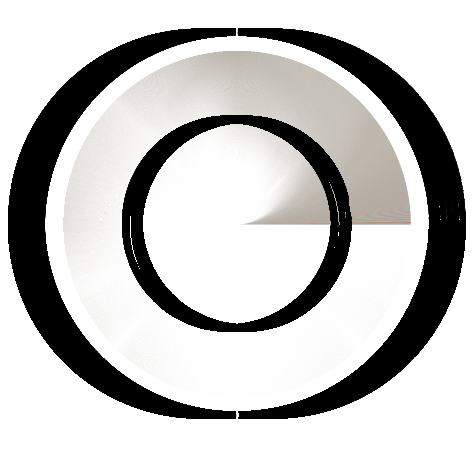

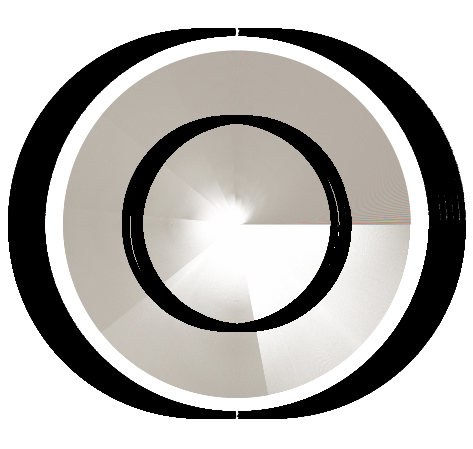

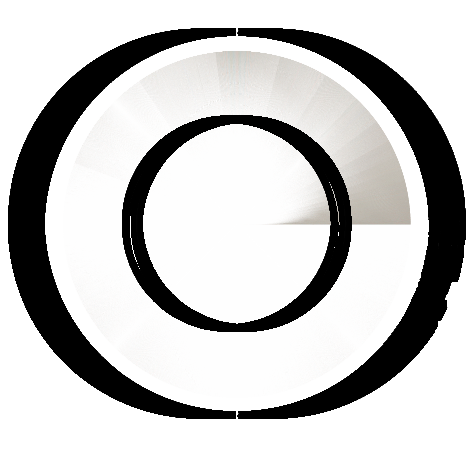

In [131]:
dimensions = ['user_id','item_id','cat_id','merchant_id','brand_id','label','age_range','gender']

for dimension in dimensions:
    for action in action_list:
        tmp_1 = df_1111.groupby([dimension])[action].sum().reset_index().sort_values(action, ascending=False)
        
        plt.figure(figsize=(8,8))
        plt.pie(x=tmp_1[action], labels=tmp_1[dimension].unique(), autopct='%.2f')
        plt.show();

plt.show();




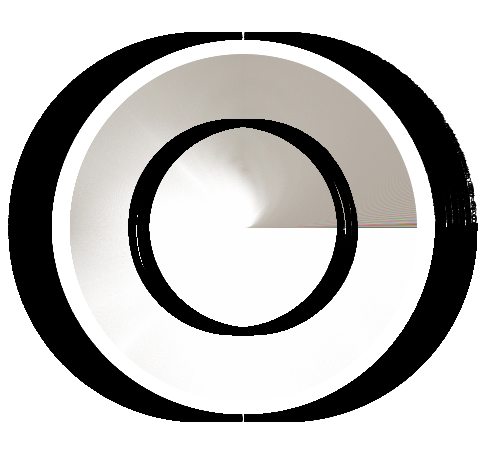

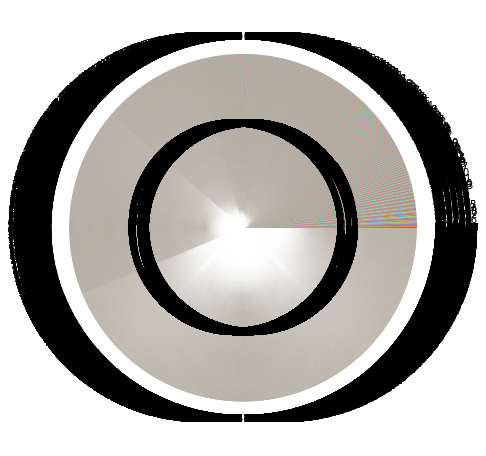

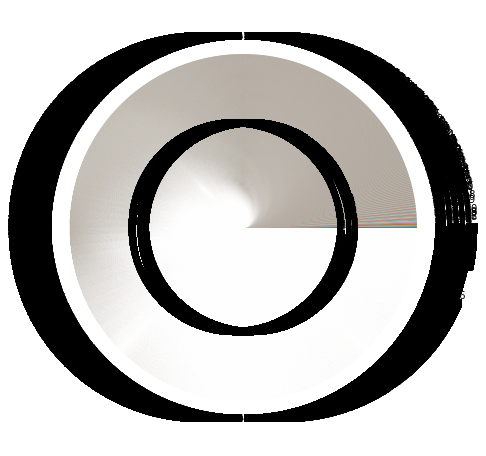

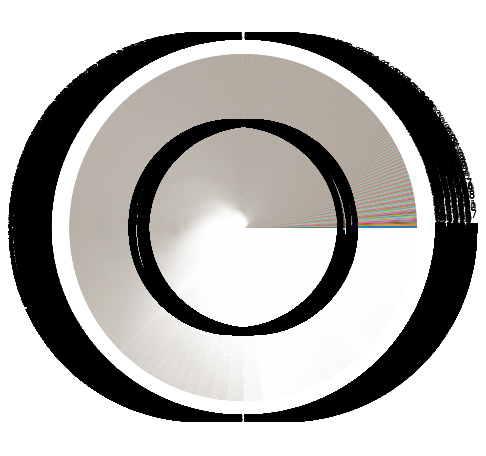

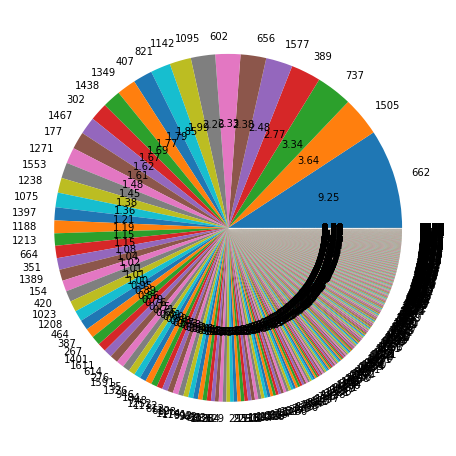

...

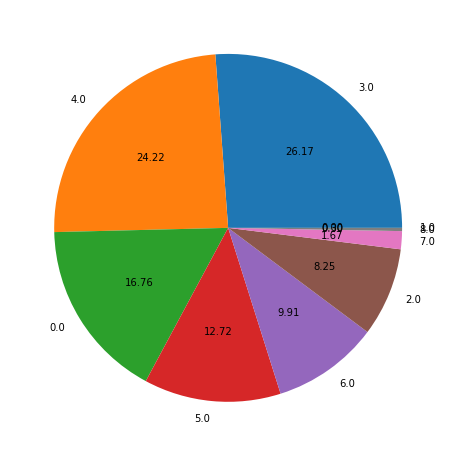

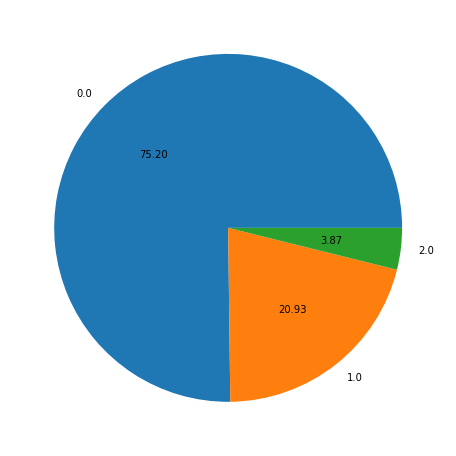

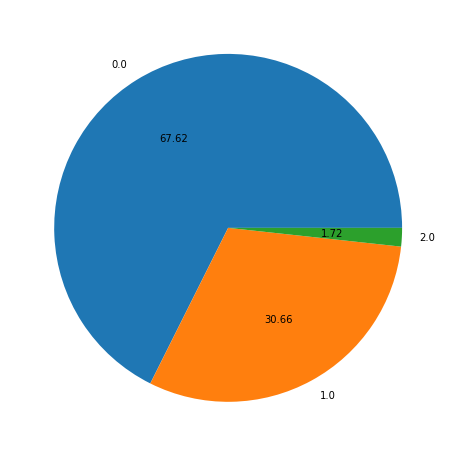

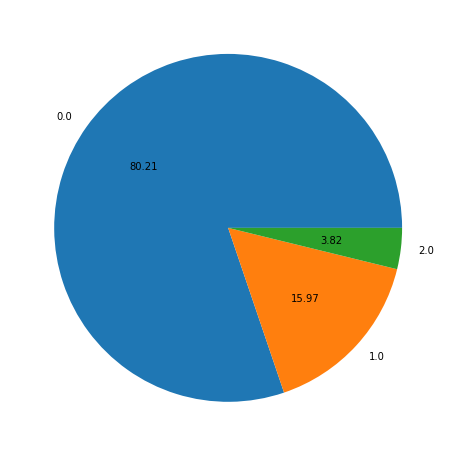

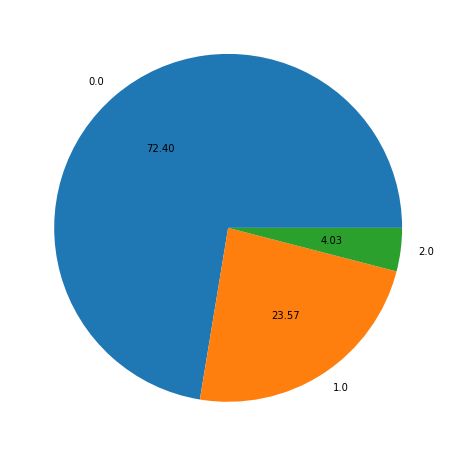

In [60]:
dimensions = ['item_id','cat_id','merchant_id','brand_id','label','age_range','gender']

for dimension in dimensions:
    for action in action_list:
        tmp_1 = df_non1111.groupby([dimension])[action].sum().reset_index().sort_values(action, ascending=False)
        
        plt.figure(figsize=(8,8))
        plt.pie(x=tmp_1[action], labels=tmp_1[dimension].unique(), autopct='%.2f')
        plt.show();

plt.show();


13.31
        item_id   click  purchase  cr_purchase  cr_purchase_compare
75110    191499  7930.0    2332.0    29.407314            16.097314
138623   353560  9680.0    2018.0    20.847107             7.537107
415749  1059899  6013.0    1851.0    30.783303            17.473303
279572   713695  4655.0    1659.0    35.639098            22.329098
407845  1039919  3620.0    1467.0    40.524862            27.214862
86989    221663  5094.0    1444.0    28.347075            15.037075
256949   655904  3302.0    1325.0    40.127196            26.817196
31739     81360  3676.0    1254.0    34.113166            20.803166
367135   936203  3801.0    1202.0    31.623257            18.313257
41924    107407  4258.0    1200.0    28.182245            14.872245


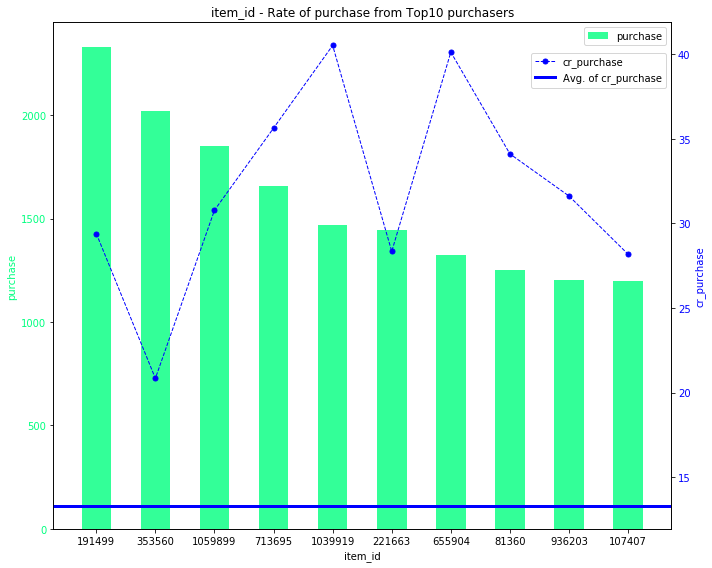

13.31
      cat_id     click  purchase  cr_purchase  cr_purchase_compare
555      656  424744.0   48687.0    11.462669            -1.847331
1014    1208  207044.0   41951.0    20.261877             6.951877
507      602  203200.0   29531.0    14.532972             1.222972
560      662  334926.0   28883.0     8.623696            -4.686304
625      737  242319.0   28530.0    11.773736            -1.536264
954     1142  373732.0   28097.0     7.517954            -5.792046
330      389  392985.0   27372.0     6.965151            -6.344849
146      177  173042.0   26264.0    15.177818             1.867818
1019    1213   95260.0   25851.0    27.137308            13.827308
1198    1438  160813.0   23519.0    14.625061             1.315061


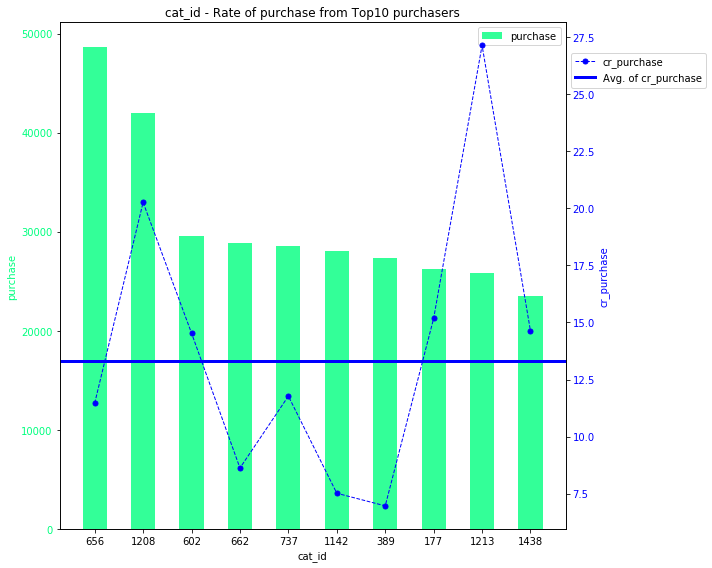

13.31
      merchant_id     click  purchase  cr_purchase  cr_purchase_compare
3826         3828   90086.0   10105.0    11.217059            -2.092941
4042         4044  122651.0   10075.0     8.214364            -5.095636
1891         1892   43358.0    8108.0    18.700125             5.390125
0               1   73496.0    7537.0    10.254980            -3.055020
1101         1102   88331.0    7311.0     8.276822            -5.033178
421           422   37199.0    6780.0    18.226296             4.916296
4171         4173   96541.0    6541.0     6.775360            -6.534640
3758         3760  110327.0    6519.0     5.908798            -7.401202
1534         1535   28312.0    6108.0    21.573891             8.263891
2384         2385   19591.0    5585.0    28.507988            15.197988


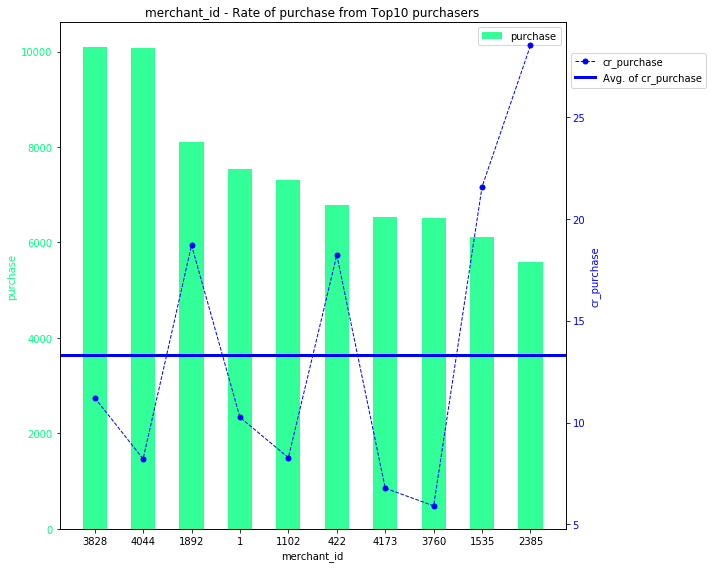

13.31
     brand_id     click  purchase  cr_purchase  cr_purchase_compare
1871     2276   93973.0   21895.0    23.299246             9.989246
6781     8235   88401.0   12909.0    14.602776             1.292776
1176     1446   90086.0   10105.0    11.217059            -2.092941
66         82  122651.0   10075.0     8.214364            -5.095636
5423     6585   51613.0    9272.0    17.964466             4.654466
986      1214   88331.0    7311.0     8.276822            -5.033178
1357     1662   70586.0    7242.0    10.259825            -3.050175
3530     4290   52550.0    6862.0    13.058040            -0.251960
3063     3738  112484.0    6640.0     5.903062            -7.406938
143       187       0.0    6586.0     0.000000           -13.310000


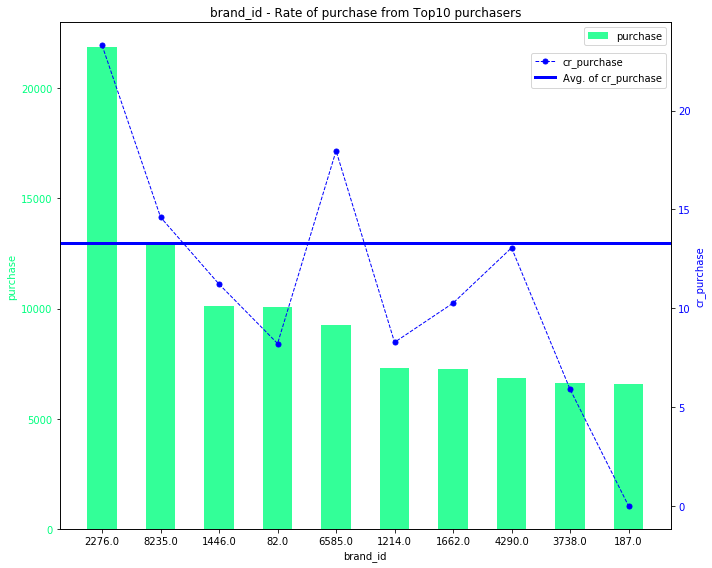

13.31
  label      click  purchase  cr_purchase  cr_purchase_compare
2     -  7903723.0  874009.0    11.058194            -2.251806
0     0  1172755.0  323452.0    27.580526            14.270526
1     1   111626.0   25893.0    23.196209             9.886209


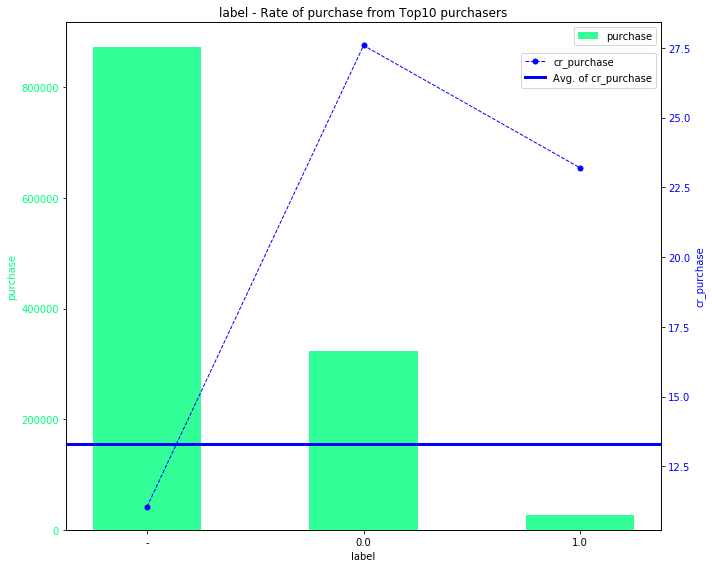

13.31
   age_range      click  purchase  cr_purchase  cr_purchase_compare
3        3.0  2618629.0  332439.0    12.695155            -0.614845
4        4.0  1967548.0  268549.0    13.648917             0.338917
0        0.0  1735227.0  237582.0    13.691696             0.381696
5        5.0   955971.0  133480.0    13.962767             0.652767
2        2.0   980796.0  124637.0    12.707739            -0.602261
6        6.0   749948.0  103774.0    13.837493             0.527493
7        7.0   153206.0   19363.0    12.638539            -0.671461
8        8.0    26498.0    3476.0    13.117971            -0.192029
1        1.0      281.0      54.0    19.217082             5.907082


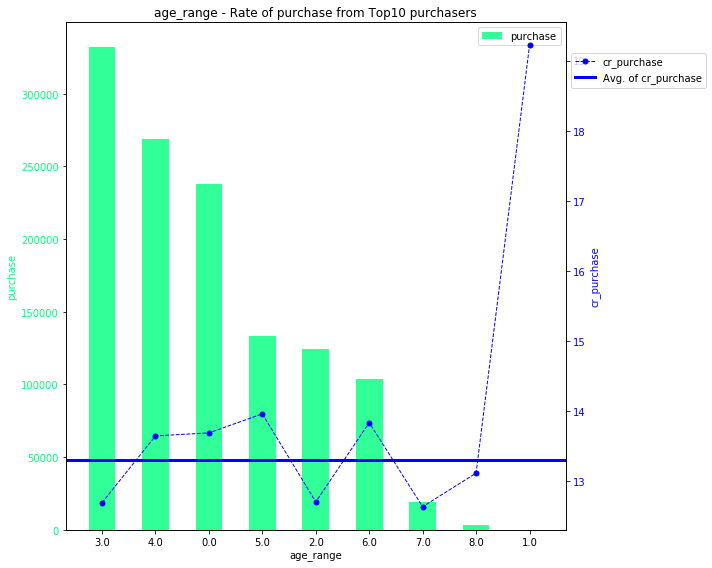

13.31
   gender      click  purchase  cr_purchase  cr_purchase_compare
0     0.0  6319190.0  860482.0    13.616967             0.306967
1     1.0  2574516.0  323725.0    12.574208            -0.735792
2     2.0   294398.0   39147.0    13.297305            -0.012695


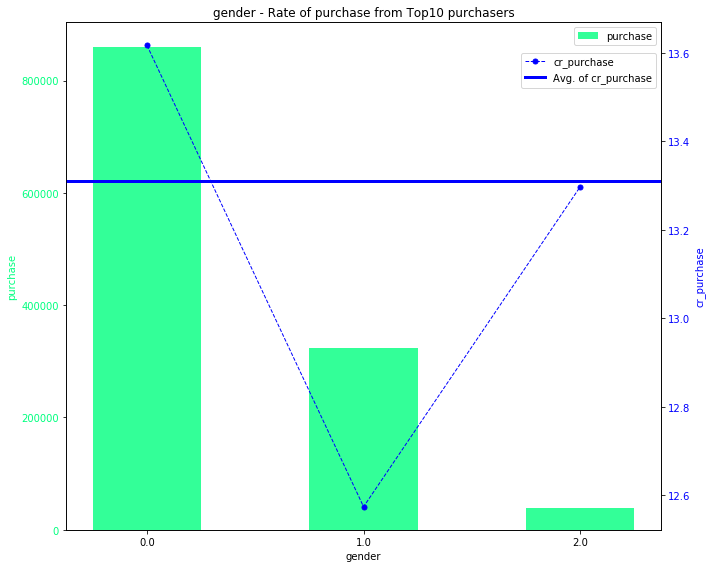

5.26
        item_id    click  purchase  cr_purchase  cr_purchase_compare
598378   631714  36478.0    4823.0    13.221668             7.961668
14392     15207  10005.0    3095.0    30.934533            25.674533
778688   822352  11869.0    2444.0    20.591457            15.331457
185398   195714   6667.0    2413.0    36.193190            30.933190
150927   159310   8375.0    2084.0    24.883582            19.623582
632951   668220   5460.0    1973.0    36.135531            30.875531
418288   441588   8708.0    1904.0    21.864952            16.604952
764021   806876   3567.0    1880.0    52.705355            47.445355
900477   951042   4978.0    1844.0    37.042989            31.782989
986233  1041507   7554.0    1683.0    22.279587            17.019587


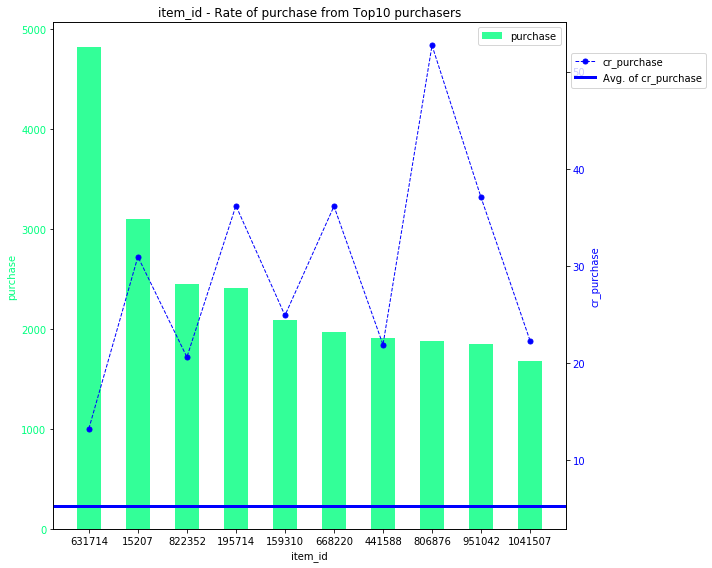

5.26
      cat_id      click  purchase  cr_purchase  cr_purchase_compare
264      267   339908.0   75018.0    22.070090            16.810090
1200    1213   451214.0   69502.0    15.403334            10.143334
656      662  3639417.0   60782.0     1.670103            -3.589897
403      407   705711.0   54326.0     7.698052             2.438052
1486    1505  1434414.0   52844.0     3.684013            -1.575987
596      602   916565.0   43859.0     4.785149            -0.474851
1372    1389   409806.0   41381.0    10.097705             4.837705
1421    1438   663885.0   40971.0     6.171400             0.911400
1195    1208   393688.0   40618.0    10.317307             5.057307
731      737  1315409.0   37377.0     2.841474            -2.418526


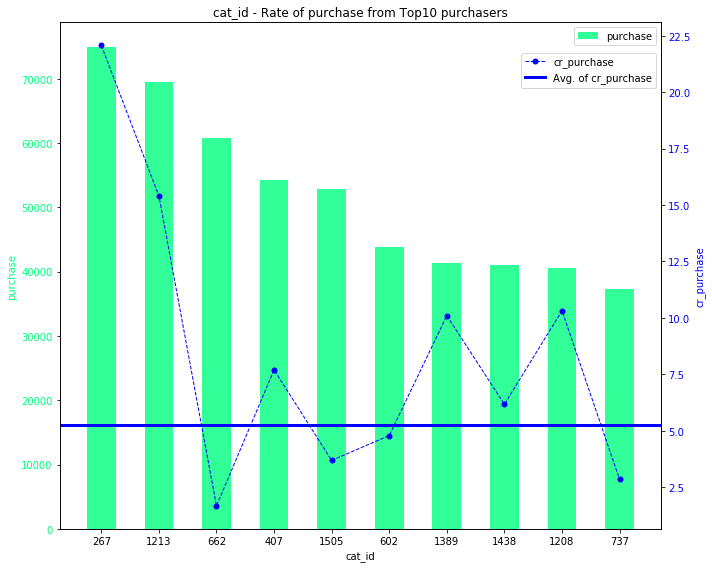

5.26
      merchant_id     click  purchase  cr_purchase  cr_purchase_compare
3662         3663  106740.0   13800.0    12.928612             7.668612
3759         3760  569376.0   11412.0     2.004299            -3.255701
0               1  234740.0   10168.0     4.331601            -0.928399
1199         1200   26932.0    9676.0    35.927521            30.667521
3827         3828  577870.0    8772.0     1.517988            -3.742012
3954         3955   77374.0    8675.0    11.211777             5.951777
1804         1805   25694.0    8596.0    33.455281            28.195281
4254         4255   24681.0    8145.0    33.001094            27.741094
3138         3139   44772.0    7783.0    17.383633            12.123633
4159         4160   36329.0    6702.0    18.448072            13.188072


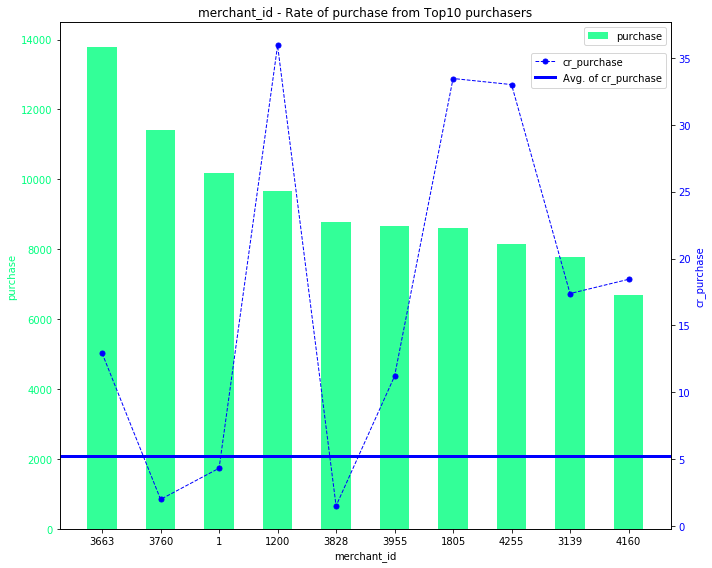

5.26
     brand_id     click  purchase  cr_purchase  cr_purchase_compare
2260     2276  307617.0   51895.0    16.870004            11.610004
1562     1573  119817.0   22163.0    18.497375            13.237375
8158     8235  265699.0   18882.0     7.106538             1.846538
4035     4073  225801.0   18876.0     8.359573             3.099573
6266     6326   67532.0   17204.0    25.475330            20.215330
3702     3738  586215.0   11816.0     2.015643            -3.244357
8399  unknown       0.0   11367.0     0.000000            -5.260000
1855     1866  103594.0   11195.0    10.806610             5.546610
1411     1422   93079.0   10566.0    11.351648             6.091648
1651     1662  232134.0   10191.0     4.390137            -0.869863


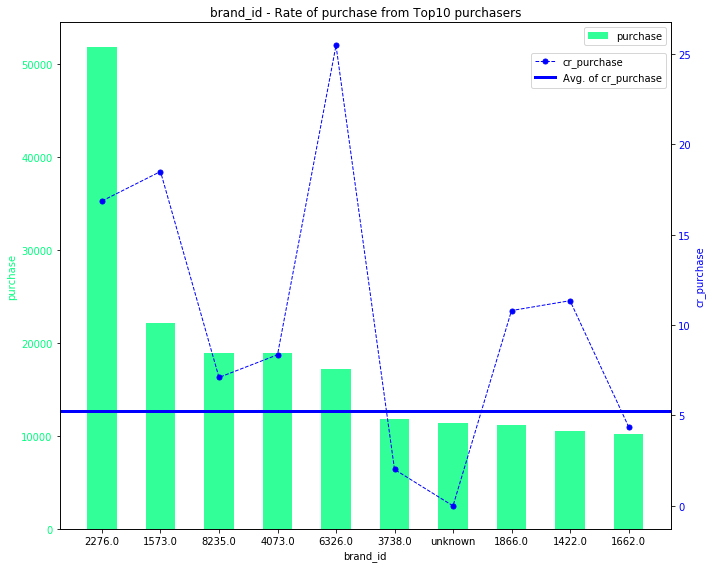

5.26
  label       click   purchase  cr_purchase  cr_purchase_compare
2     -  38279116.0  2068790.0     5.404487             0.144487
0     0    958624.0        0.0     0.000000            -5.260000
1     1    124869.0        0.0     0.000000            -5.260000


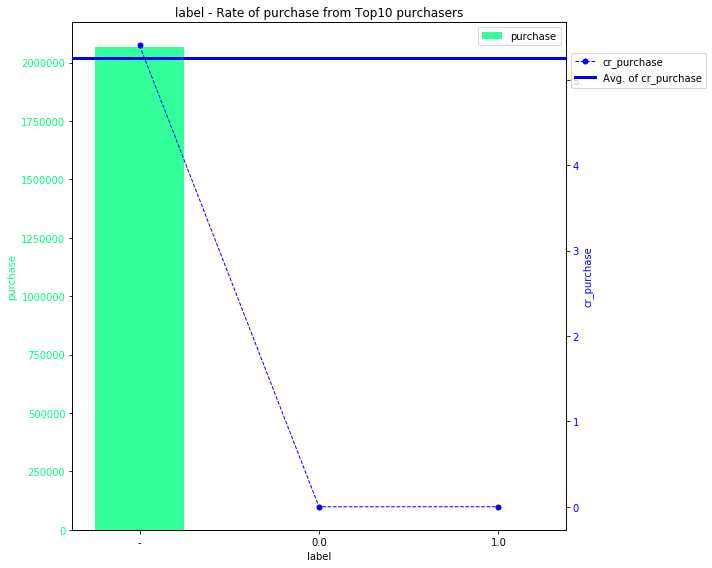

5.26
   age_range       click  purchase  cr_purchase  cr_purchase_compare
3        3.0  10574740.0  541473.0     5.120438            -0.139562
4        4.0   8444210.0  500992.0     5.932965             0.672965
0        0.0   7070687.0  346787.0     4.904573            -0.355427
5        5.0   4553947.0  263203.0     5.779668             0.519668
6        6.0   4093782.0  204944.0     5.006227            -0.253773
2        2.0   3713214.0  170625.0     4.595076            -0.664924
7        7.0    791840.0   34569.0     4.365655            -0.894345
8        8.0    118958.0    6155.0     5.174095            -0.085905
1        1.0      1231.0      42.0     3.411860            -1.848140


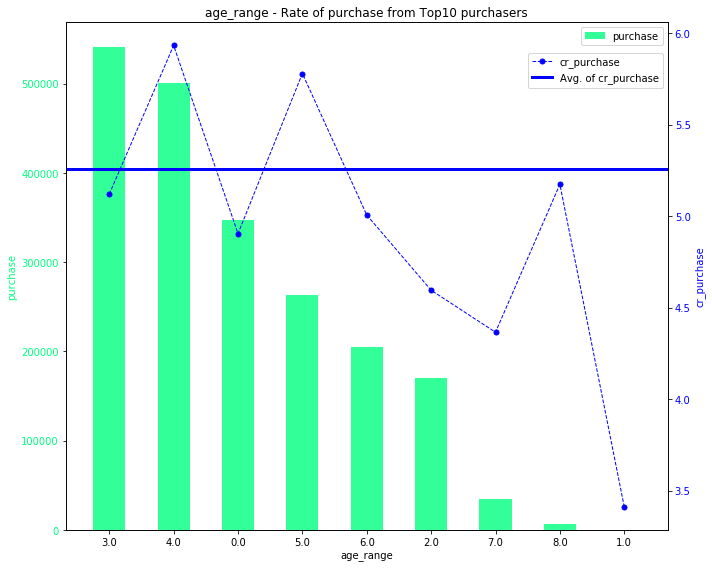

5.26
   gender       click   purchase  cr_purchase  cr_purchase_compare
0     0.0  29599991.0  1497842.0     5.060279            -0.199721
1     1.0   8239550.0   487617.0     5.918005             0.658005
2     2.0   1523068.0    83331.0     5.471259             0.211259


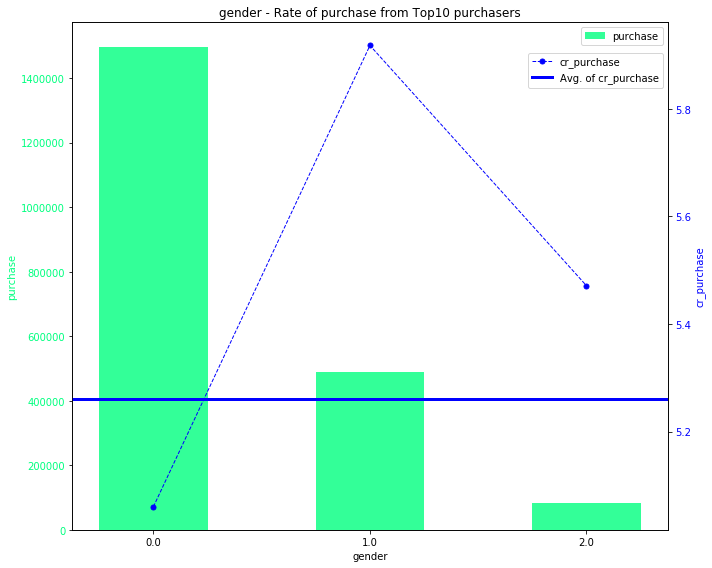

In [61]:
### 1. 雙11購買轉換率 by 品類／商家／品牌／用戶／用戶屬性

def top10_cr_plot(df_1111, dimensions, action, color):
    for dimension in dimensions:
        tmp_1 = df_1111.groupby([dimension])['click','purchase'].sum().reset_index()
    #     tmp_1['cr_favorite'] = tmp_1['add_to_favorite'] / tmp_1['click'] *100
        tmp_1['cr_purchase'] = tmp_1['purchase'] / tmp_1['click'] *100
        tmp_1 = tmp_1.replace(np.inf, 0.0)
        tmp_1 = tmp_1.fillna(0.0)

    #     avg_cr_favorite = round(tmp_1['add_to_favorite'].sum() / tmp_1['click'].sum() *100, 2)
    #     print(avg_cr_favorite)
        avg_cr_purchase = round(tmp_1['purchase'].sum() / tmp_1['click'].sum() *100, 2)
        print(avg_cr_purchase)
    #     tmp_1['cr_favorite_compare'] = tmp_1['cr_favorite'] - avg_cr_favorite  # 高(+)/低(-)於平均值多少
        tmp_1['cr_purchase_compare'] = tmp_1['cr_purchase'] - avg_cr_purchase  # 高(+)/低(-)於平均值多少
        tmp_1 = tmp_1.sort_values('purchase', ascending=False).head(10)
        print(tmp_1)


        ###更新：2020.10.20 照下面改成雙 y軸
        indexes = np.arange(len(tmp_1))
        fig, ax1 = plt.subplots(1, 1, figsize=(10,8))
        ax1.set_xlabel(str(dimension))
        ax1.set_ylabel(str(action), color=colors[0])
        ax1.bar(indexes, tmp_1[action], 0.5, alpha=0.8, color=colors[0])
        ax1.tick_params(axis='y', labelcolor=colors[0])
        ax1.legend([str(action)])

        ax2 = ax1.twinx()
        ax2.set_ylabel(f'cr_{action}', color=colors[1])
        ax2.plot(indexes, tmp_1[f'cr_{action}'], color=colors[1], marker='o', linestyle='dashed', linewidth=1, markersize=5)
        ax2.axhline(y=avg_cr_purchase, color=colors[1], linestyle='-', linewidth=3)
        ax2.tick_params(axis='y', labelcolor=colors[1])
        ax2.legend([f'cr_{action}', f'Avg. of cr_{action}'], bbox_to_anchor=(1,0.95))

        plt.title(f'{dimension} - Rate of {action} from Top10 purchasers')
        plt.xticks(indexes, [str(item) for item in tmp_1[dimension]])

        fig.tight_layout()
        plt.show();
    
    
        ###old version
    #     indexes = np.arange(len(tmp_2))
    #     plt.figure(figsize=(10,8))
    #     plt.bar(indexes, tmp_2['add_to_favorite'], 0.5, alpha=0.8, color='darkgreen')
    #     plt.plot(indexes, tmp_2['cr_favorite'], color='lightblue', marker='o', linestyle='dashed', linewidth=1, markersize=5)
    #     plt.axhline(y=avg_cr_favorite, color='lightblue', linestyle='-', linewidth=3)
    #     plt.title(f'{dimension} - Rate of Add_to_favorite')
    #     plt.xticks(indexes, [str(item) for item in tmp_2[dimension]])
    #     plt.legend(['cr_favorite', 'Avg. of cr_favorite', 'add_to_favorite'])
    #     plt.show();

    #     plt.figure(figsize=(10,8))
    #     plt.bar(indexes, tmp_2['purchase'], 0.5, alpha=0.8, color='springgreen')
    #     plt.plot(indexes, tmp_2['cr_purchase'], color='blue', marker='o', linestyle='dashed', linewidth=1, markersize=5)
    #     plt.axhline(y=avg_cr_purchase, color='blue', linestyle='-', linewidth=3)
    #     plt.title(f'{dimension} - Rate of Purchase')
    #     plt.xticks(indexes, [str(item) for item in tmp_2[dimension]])
    #     plt.legend(['cr_purchase', 'Avg. of cr_purchase', 'purchase'])
    #     plt.show();


action = 'purchase'
colors = ['springgreen','blue']
dimensions = ['item_id','cat_id','merchant_id','brand_id','label','age_range','gender']
top10_cr_plot(df_1111, dimensions, action, colors)
top10_cr_plot(df_non1111, dimensions, action, colors)


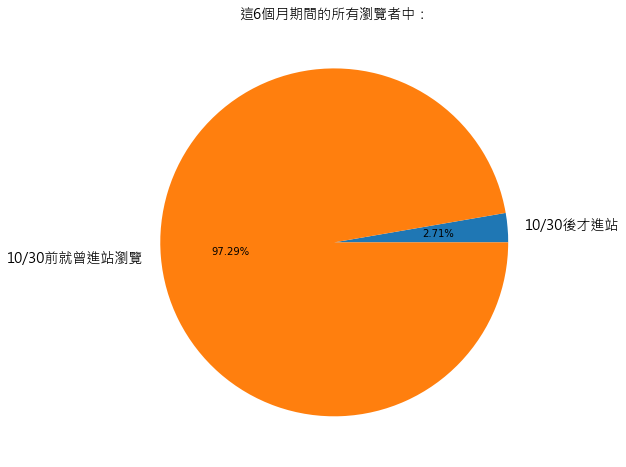

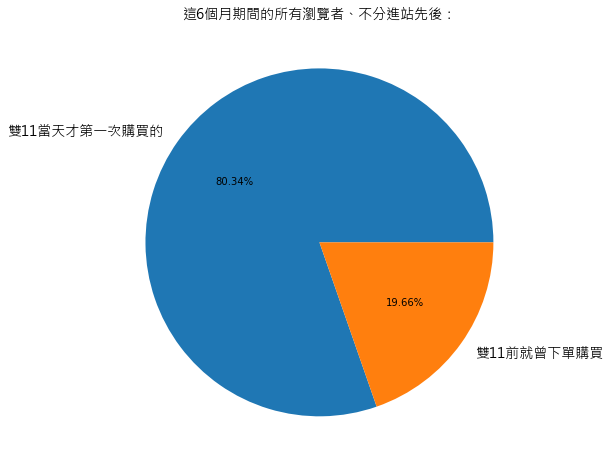

In [107]:
### 2. 有多少比例是雙11當天才進站瀏覽／購買

# 挑選
cut_date = 1030
df_user_action_sum_by_date = df.groupby(['user_id','time_stamp','day_stamp'])[action_list].sum().reset_index()
df_user_action_sum_by_date.head(5)

print('Total unique viewers: ', len(df_user_action_sum_by_date.user_id.unique()))
viewer_only_1111 = np.array(list(set(df_user_action_sum_by_date[df_user_action_sum_by_date['time_stamp']>=cut_date].user_id.unique()) - set(df_user_action_sum_by_date[df_user_action_sum_by_date['time_stamp']<cut_date].user_id.unique())))
viewer_notOnly_1111 = np.array(list(set(df_user_action_sum_by_date.user_id.unique()) - set(viewer_only_1111)))
print(len(viewer_only_1111), len(viewer_notOnly_1111), len(viewer_only_1111)+len(viewer_notOnly_1111))

#### in all viewers
tmp_2 = df_user_action_sum_by_date[df_user_action_sum_by_date['time_stamp']!=1111].groupby(['user_id'])['purchase'].sum().reset_index()
purchaser_only_1111 = np.array(list(set(df_user_action_sum_by_date[(df_user_action_sum_by_date['time_stamp']==1111)&(df_user_action_sum_by_date['purchase']>0)].user_id.unique()) - set(tmp_2[tmp_2['purchase']==0].user_id.unique())))
purchaser_notOnly_1111 = np.array(list(set(df_user_action_sum_by_date[df_user_action_sum_by_date['purchase']>0].user_id.unique()) - set(purchaser_only_1111)))
print(len(purchaser_only_1111), len(purchaser_notOnly_1111), len(purchaser_only_1111)+len(purchaser_notOnly_1111))


plt.figure(figsize=(8,8))
patches, l_text, p_text = plt.pie(x=[len(viewer_only_1111), len(viewer_notOnly_1111)], 
        labels=['10/30後才進站', '10/30前就曾進站瀏覽'], 
        autopct='%1.2f%%')
for l in l_text:
    l.set_fontproperties(fontproperties)
    
plt.title('這6個月期間的所有瀏覽者中：', fontproperties=fontproperties)
plt.show();

plt.figure(figsize=(8,8))
patches, l_text, p_text = plt.pie(x=[len(purchaser_only_1111), len(purchaser_notOnly_1111)], 
                                  labels=['雙11當天才第一次購買的', '雙11前就曾下單購買'], 
                                  autopct='%1.2f%%')
for l in l_text:
    l.set_fontproperties(fontproperties)
plt.title('這6個月期間的所有瀏覽者、不分進站先後：', fontproperties=fontproperties)
plt.show();



viewer_only_1111: 
avg_cr_add_to_favorite:  3.18
avg_cr_purchase:  7.39


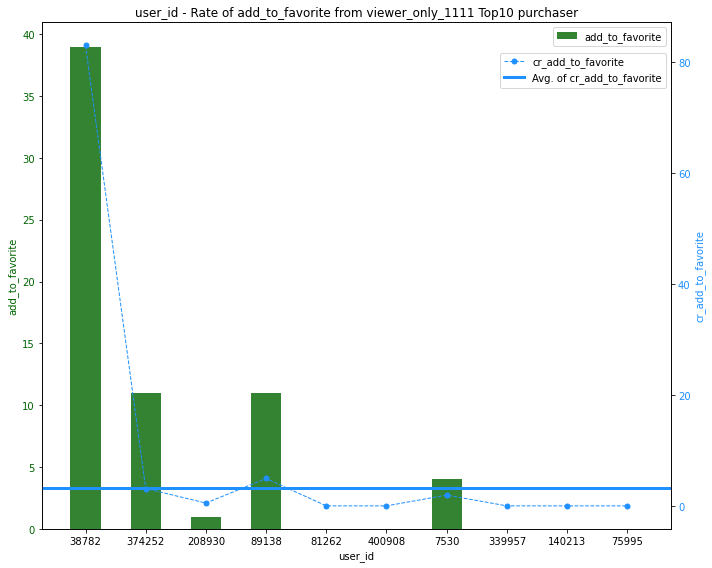

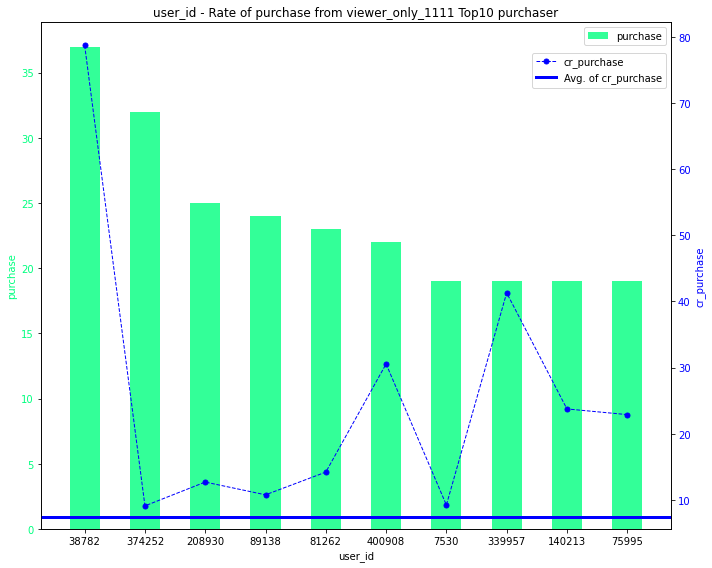

viewer_only_1111: 
avg_cr_add_to_favorite:  3.18
avg_cr_purchase:  7.39


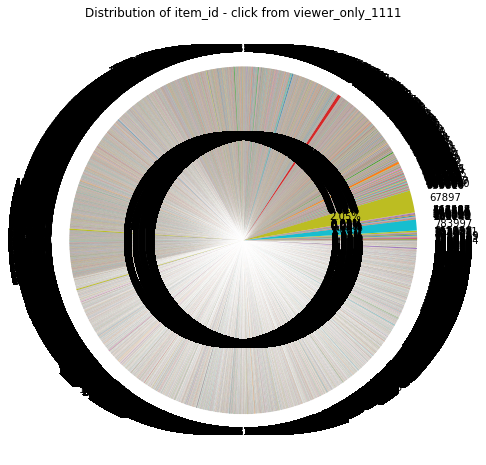

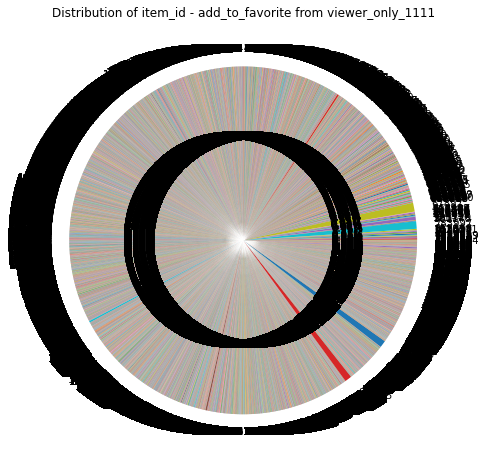

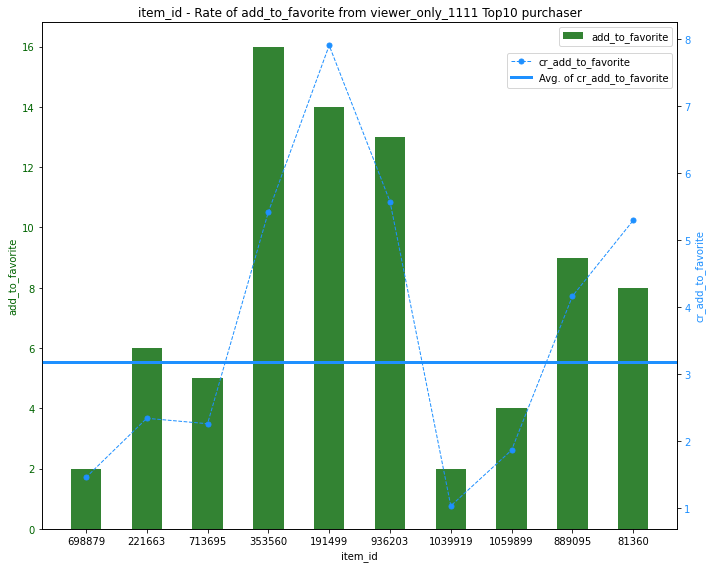

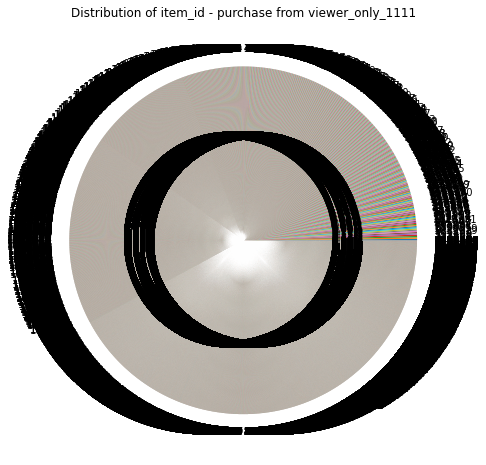

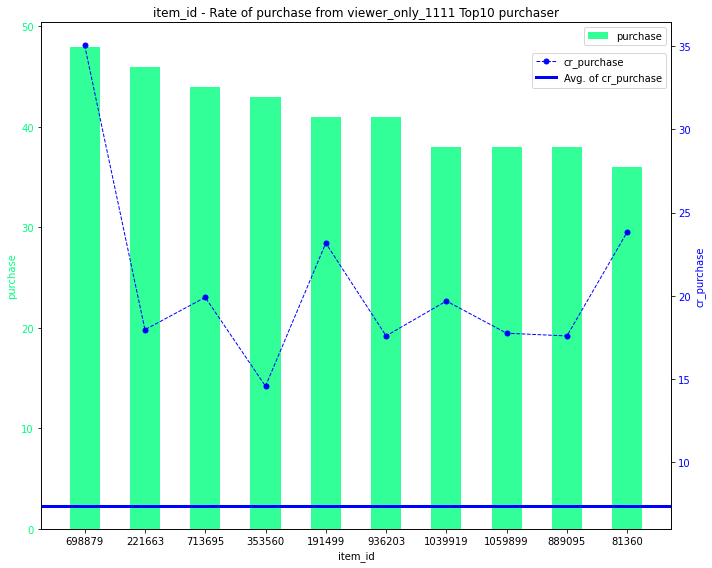

viewer_only_1111: 
avg_cr_add_to_favorite:  3.18
avg_cr_purchase:  7.39


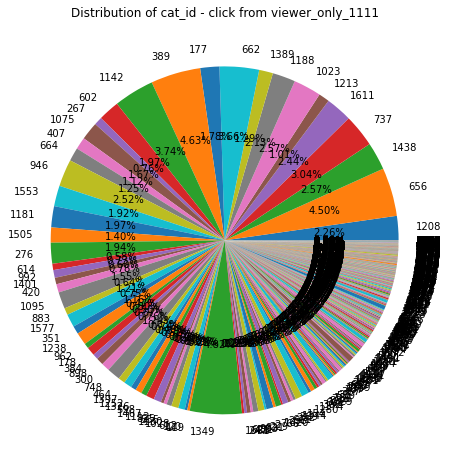

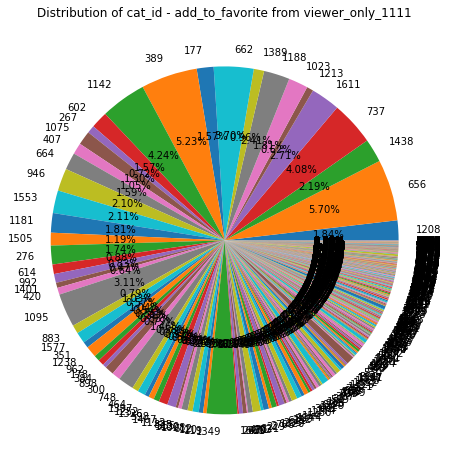

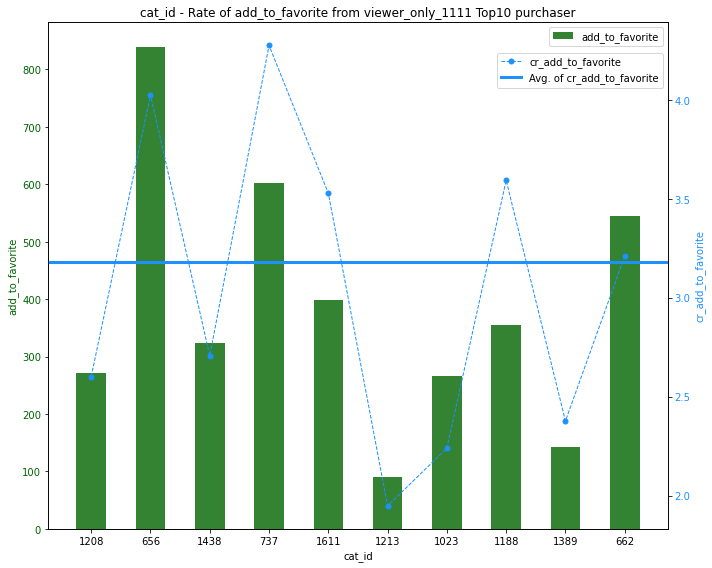

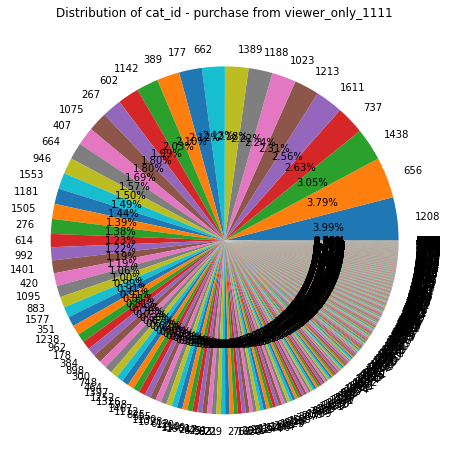

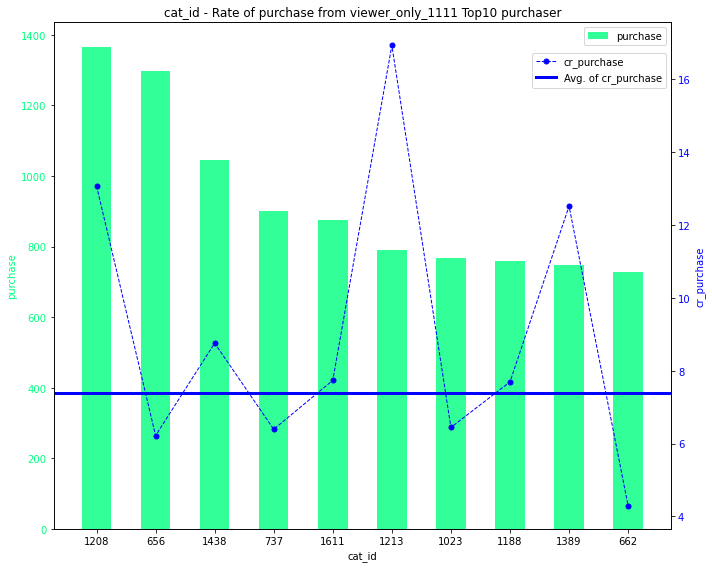

viewer_only_1111: 
avg_cr_add_to_favorite:  3.18
avg_cr_purchase:  7.39


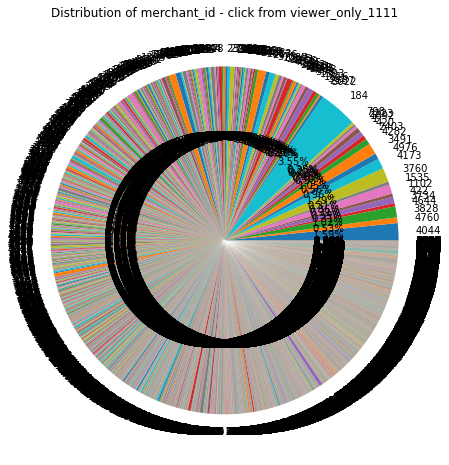

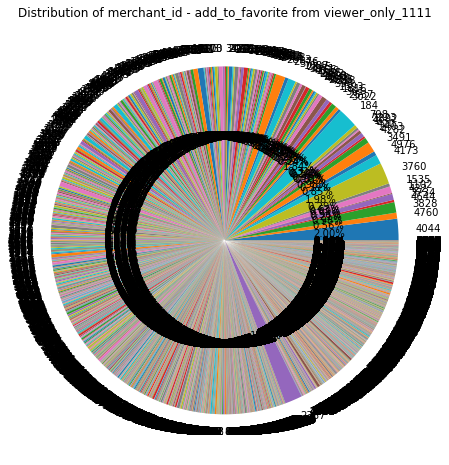

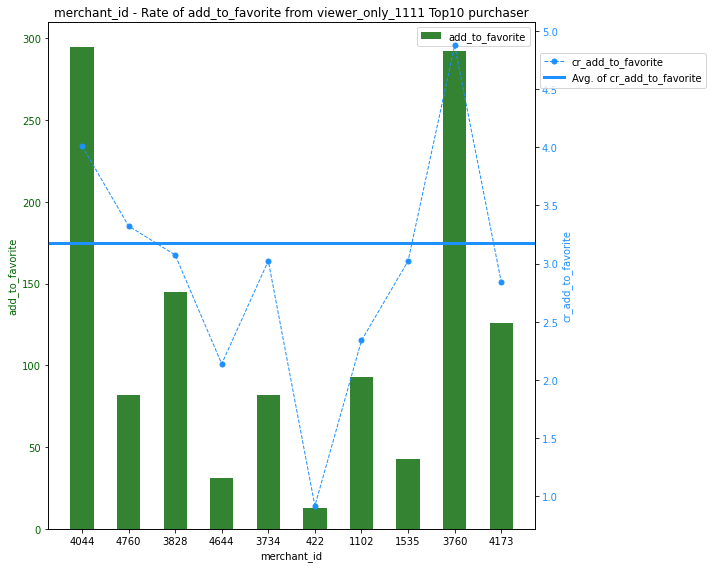

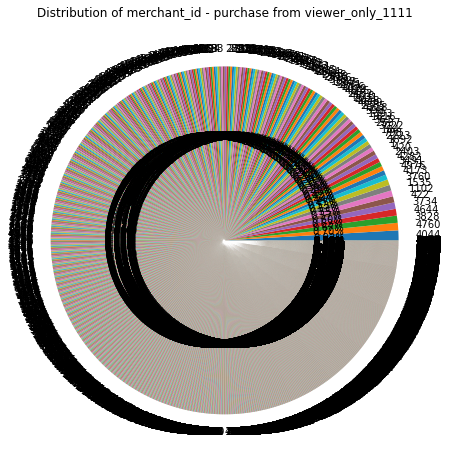

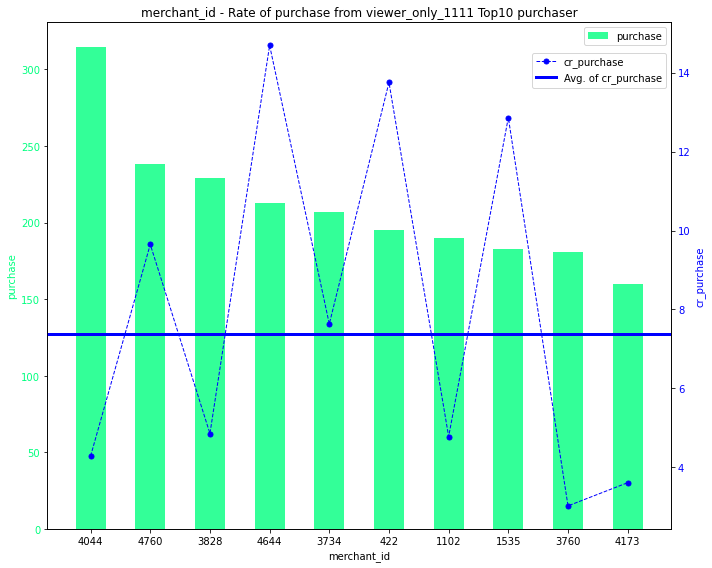

viewer_only_1111: 
avg_cr_add_to_favorite:  3.18
avg_cr_purchase:  7.39


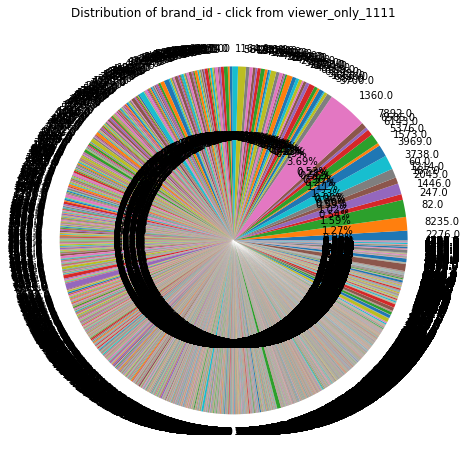

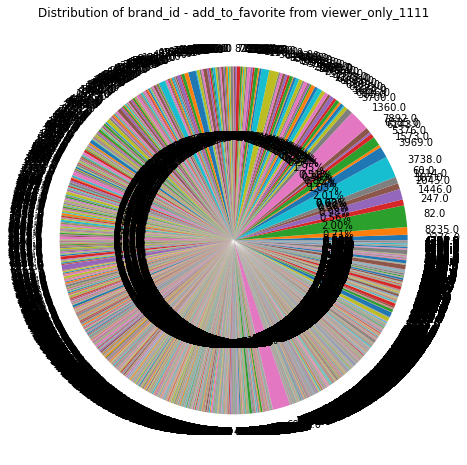

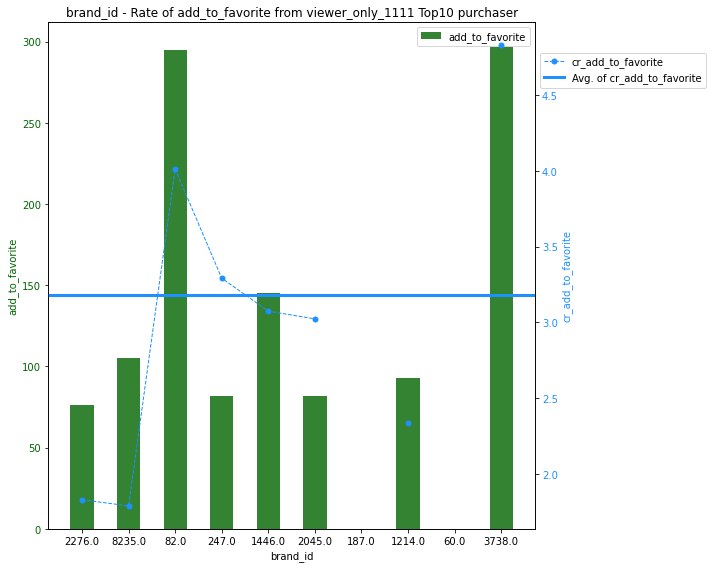

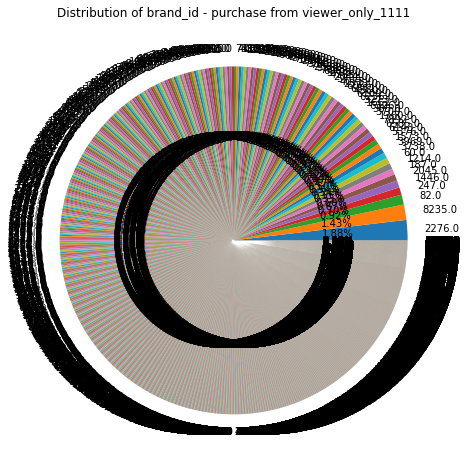

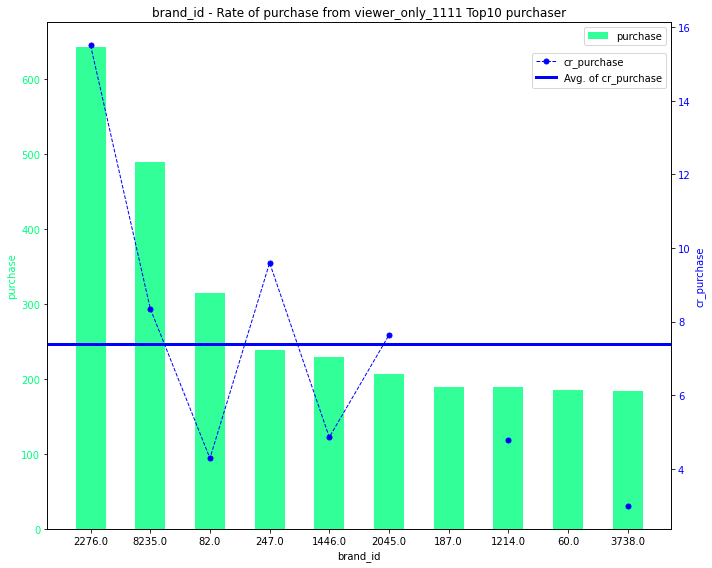

viewer_only_1111: 
avg_cr_add_to_favorite:  3.18
avg_cr_purchase:  7.39


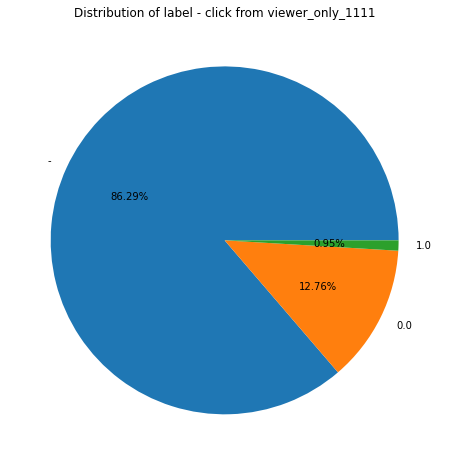

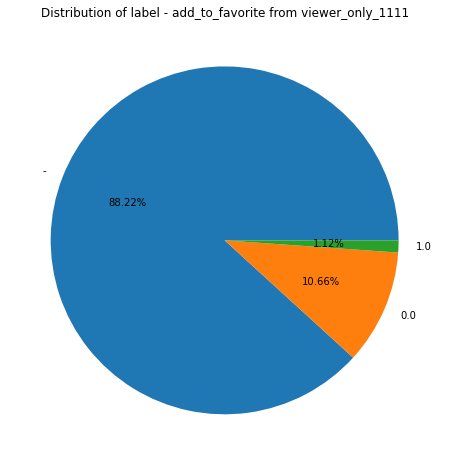

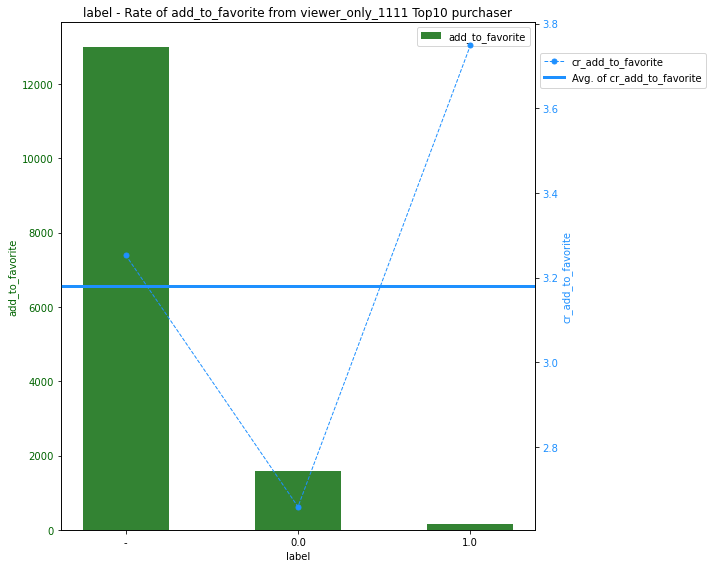

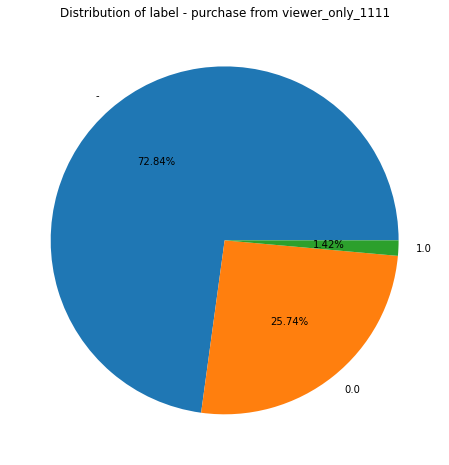

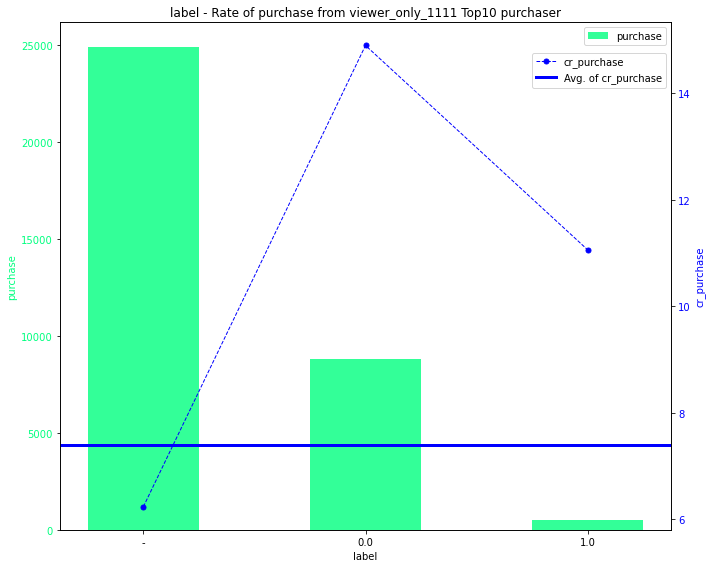

viewer_only_1111: 
avg_cr_add_to_favorite:  3.18
avg_cr_purchase:  7.39


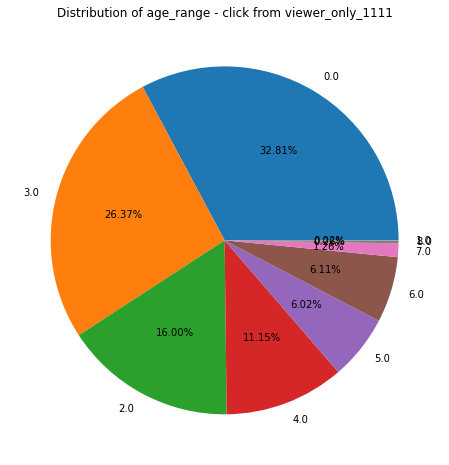

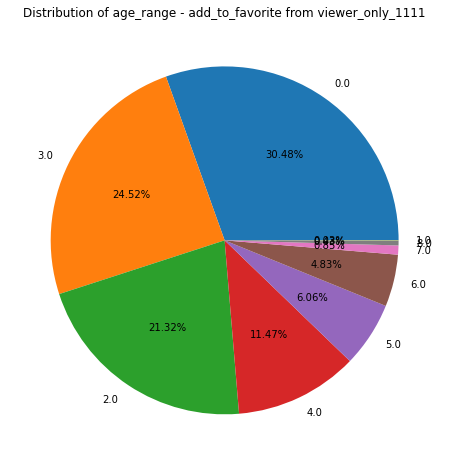

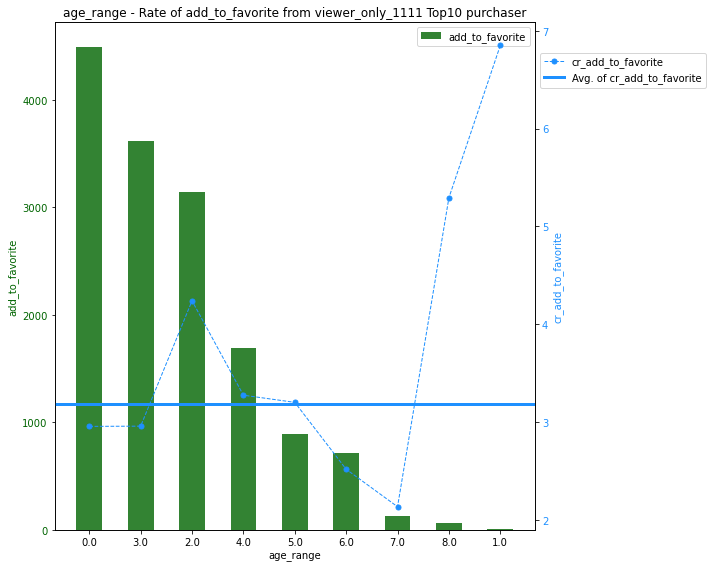

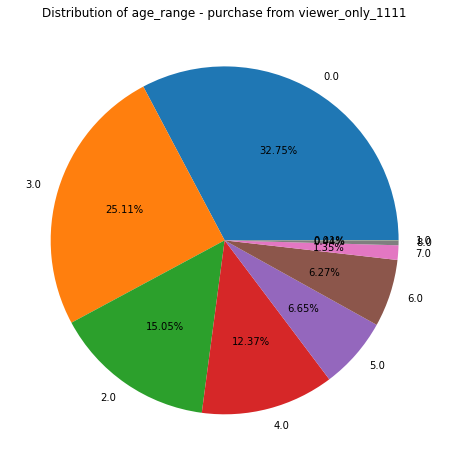

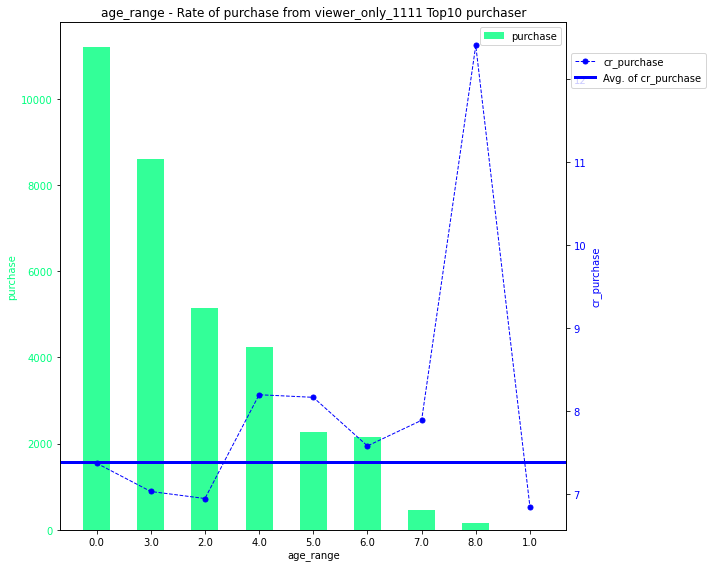

viewer_only_1111: 
avg_cr_add_to_favorite:  3.18
avg_cr_purchase:  7.39


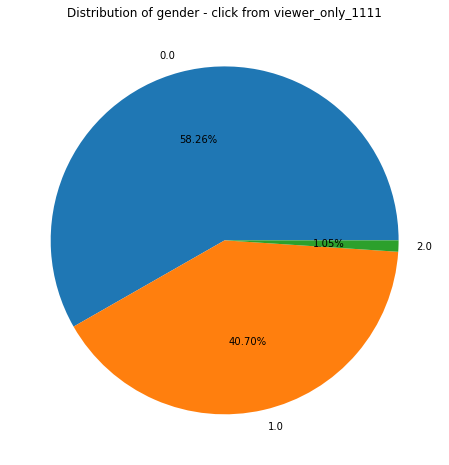

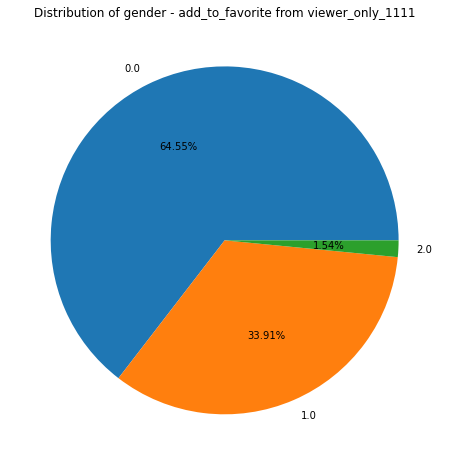

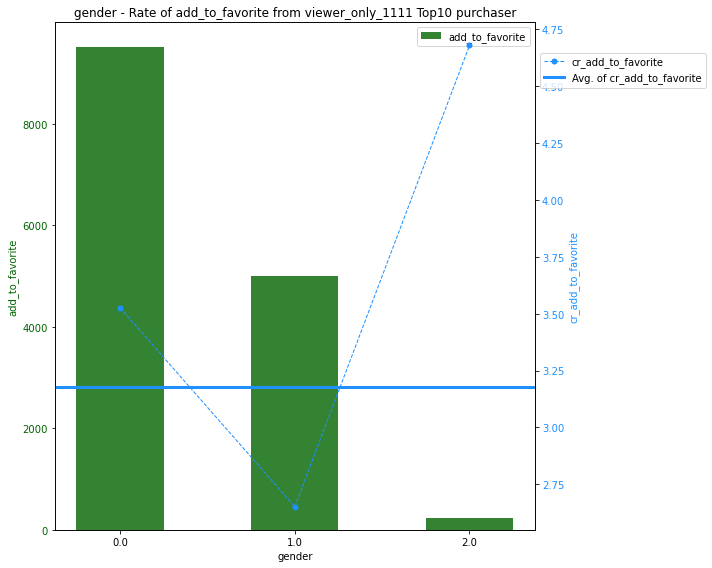

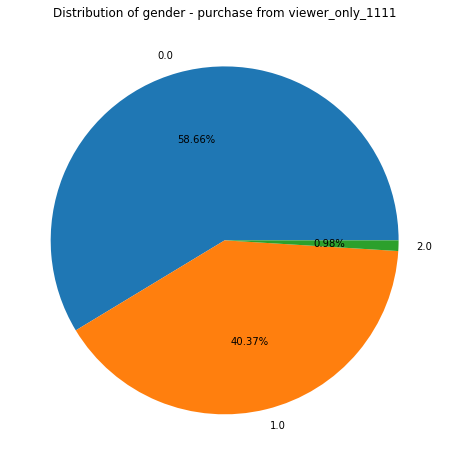

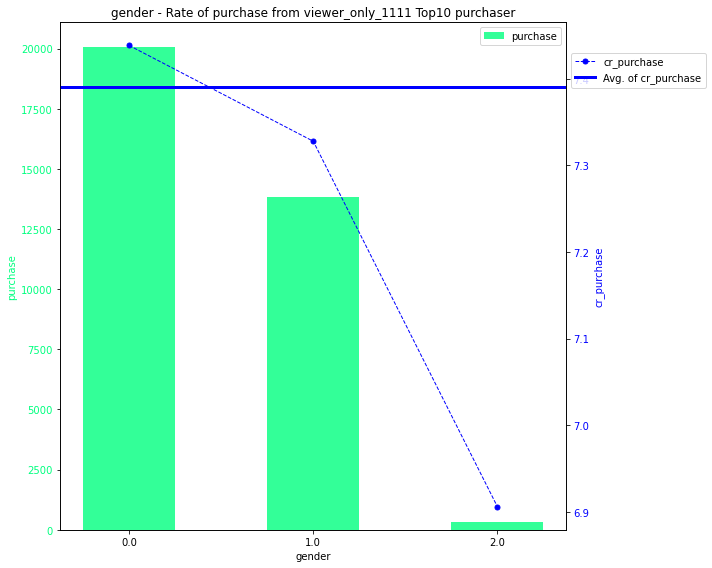

viewer_notOnly_1111: 
avg_cr_add_to_favorite:  6.22
avg_cr_purchase:  6.77


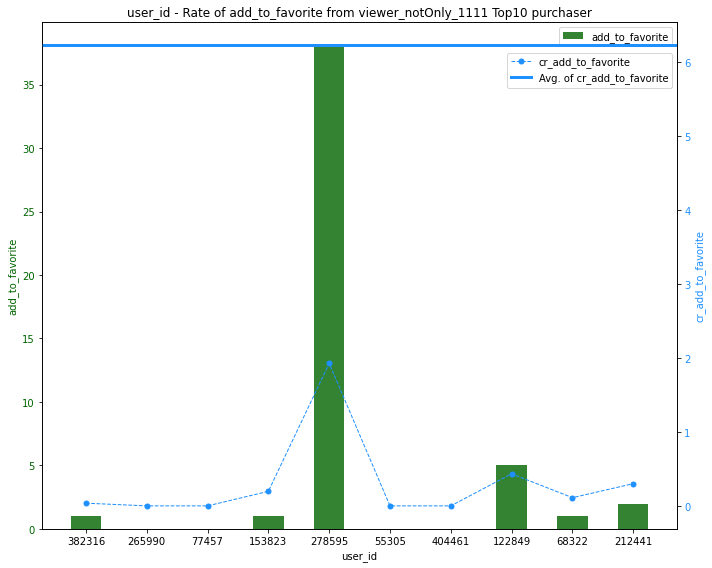

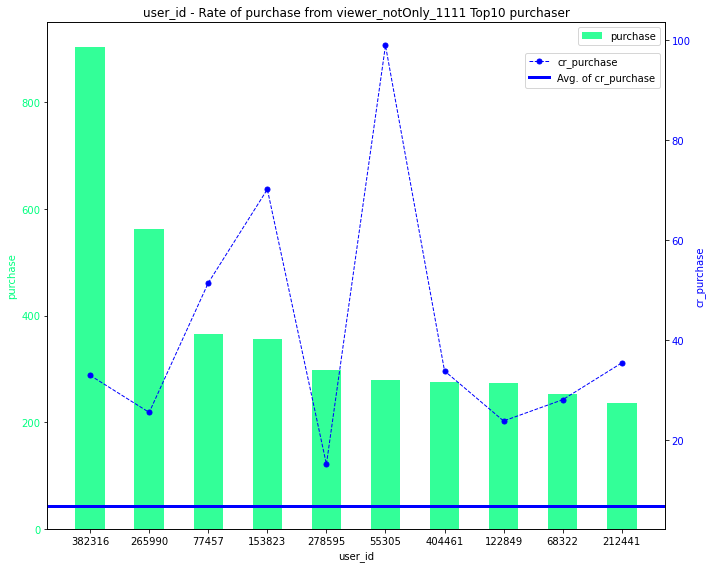

viewer_notOnly_1111: 
avg_cr_add_to_favorite:  6.22
avg_cr_purchase:  6.77


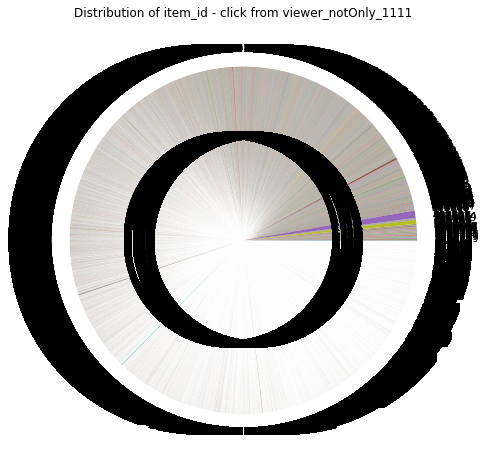

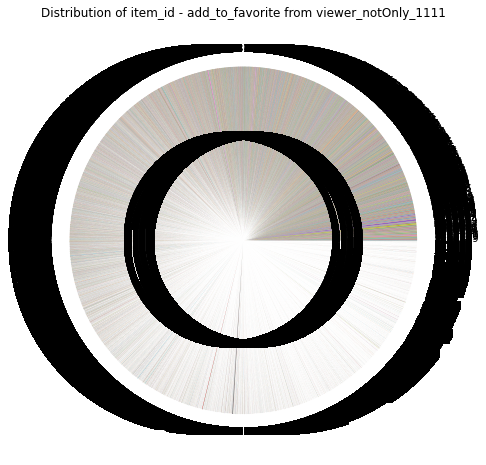

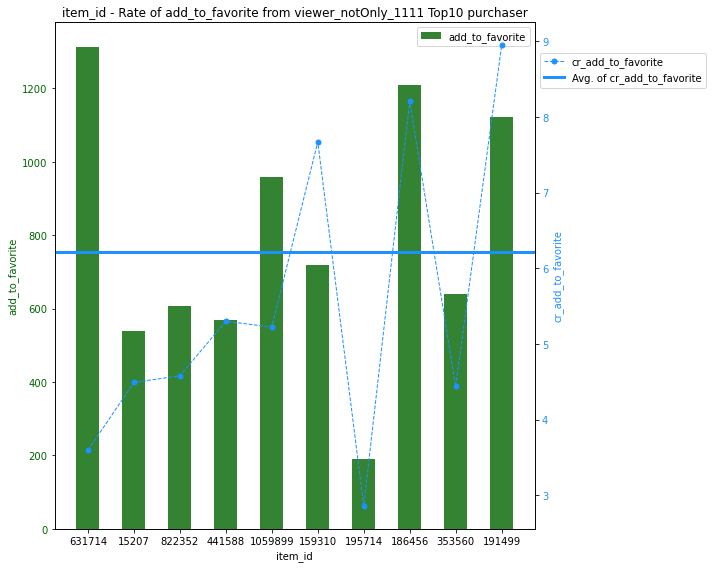

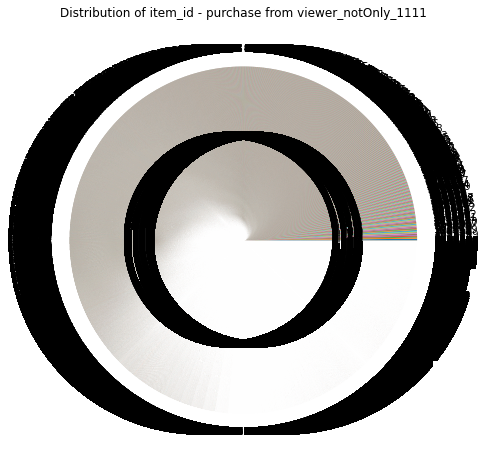

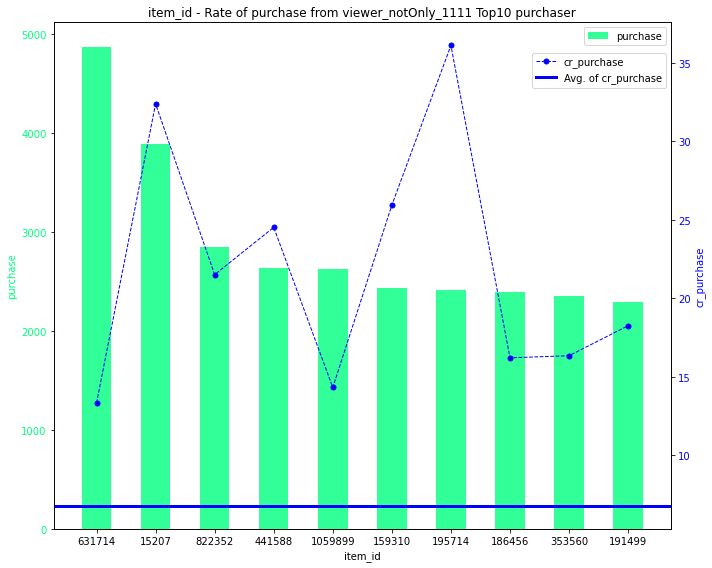

viewer_notOnly_1111: 
avg_cr_add_to_favorite:  6.22
avg_cr_purchase:  6.77


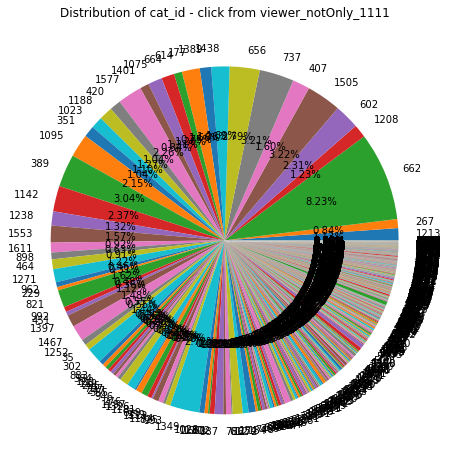

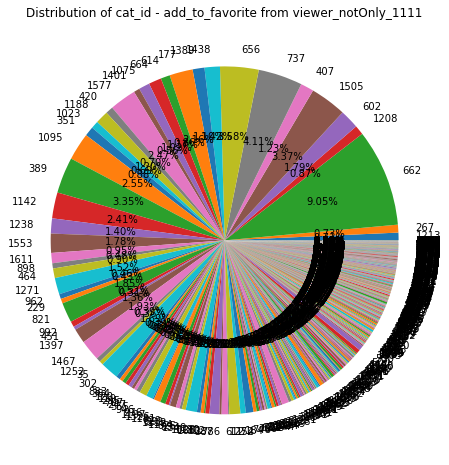

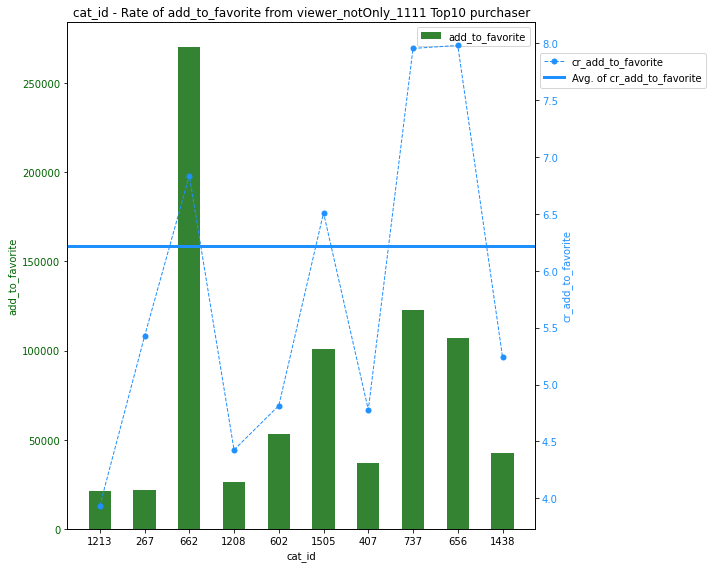

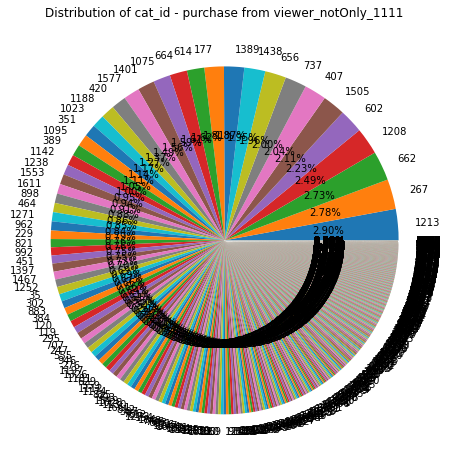

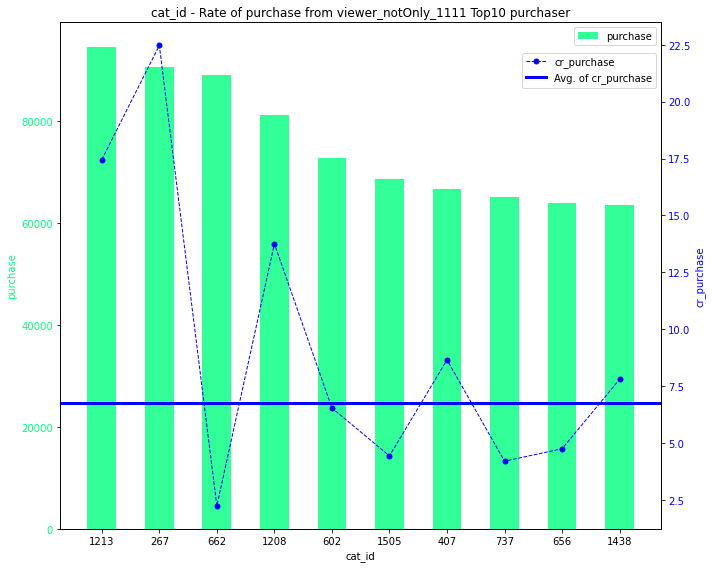

viewer_notOnly_1111: 
avg_cr_add_to_favorite:  6.22
avg_cr_purchase:  6.77


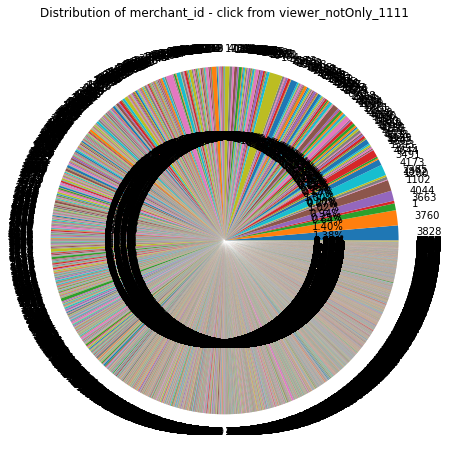

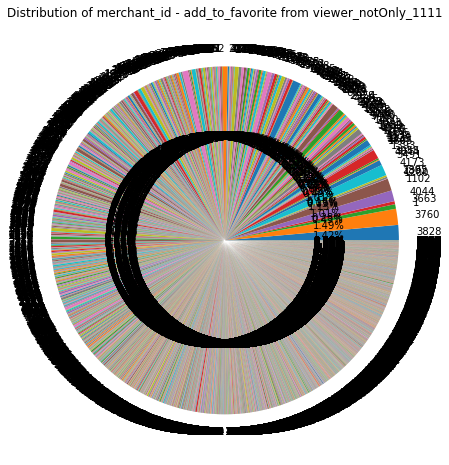

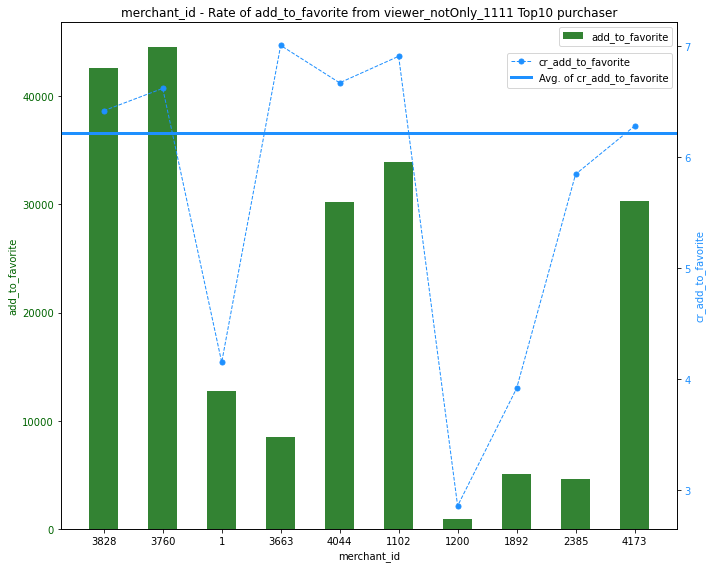

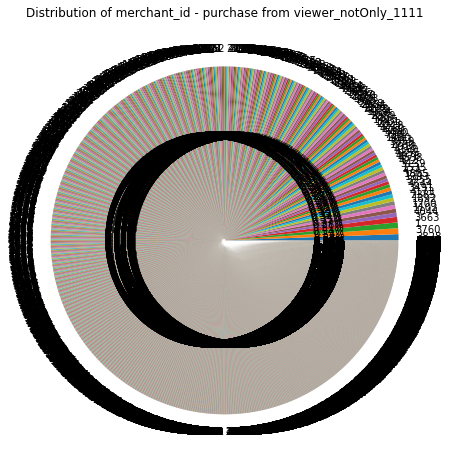

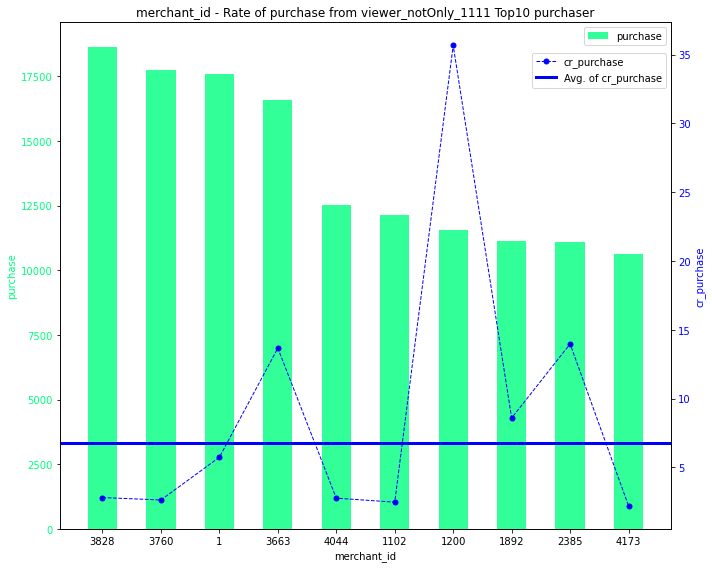

viewer_notOnly_1111: 
avg_cr_add_to_favorite:  6.22
avg_cr_purchase:  6.77


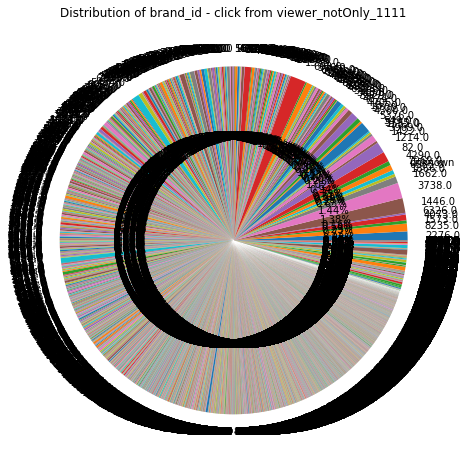

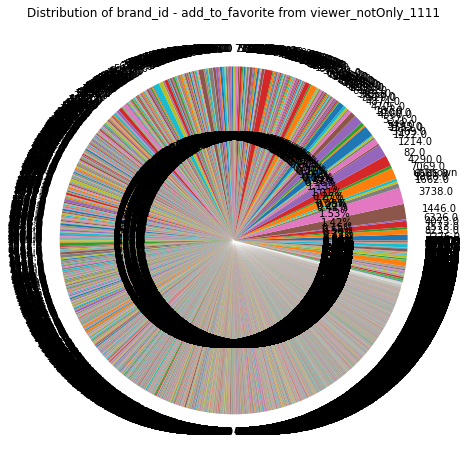

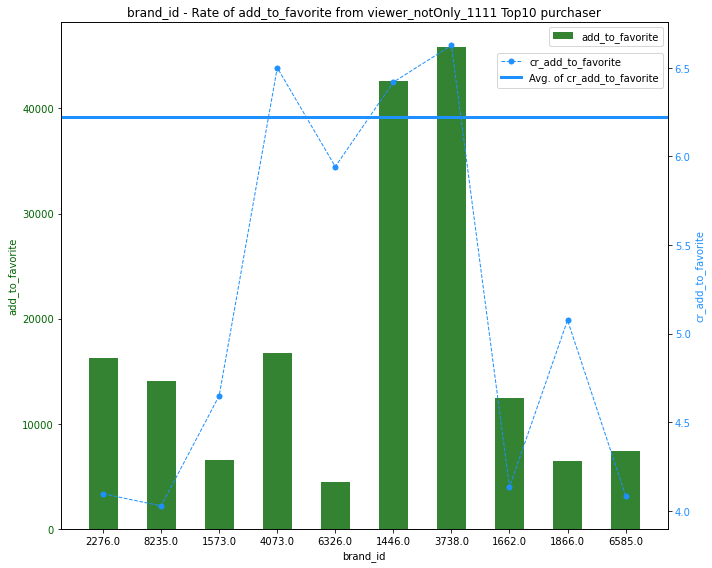

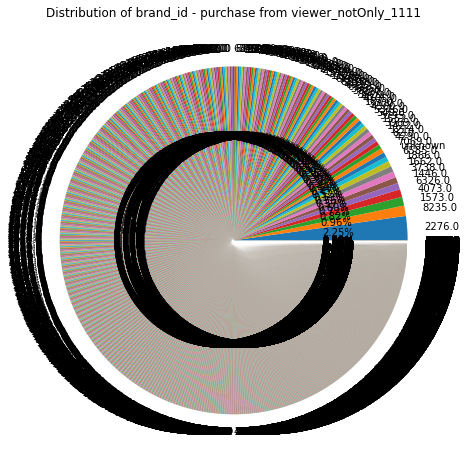

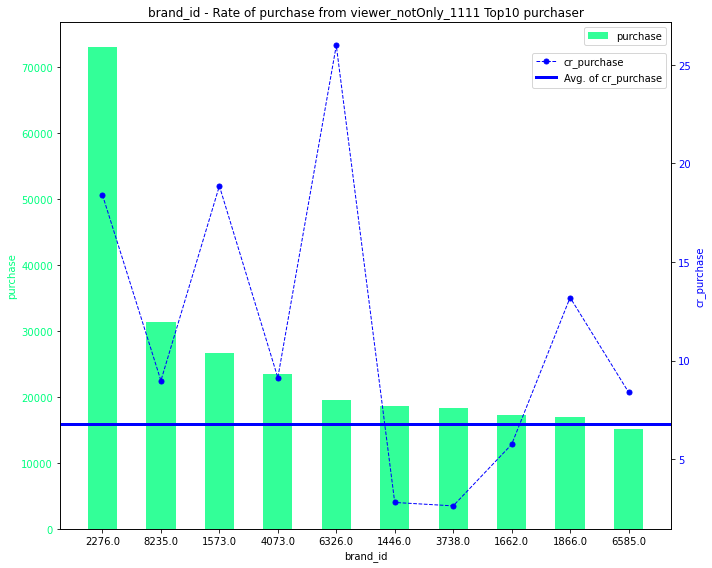

viewer_notOnly_1111: 
avg_cr_add_to_favorite:  6.22
avg_cr_purchase:  6.77


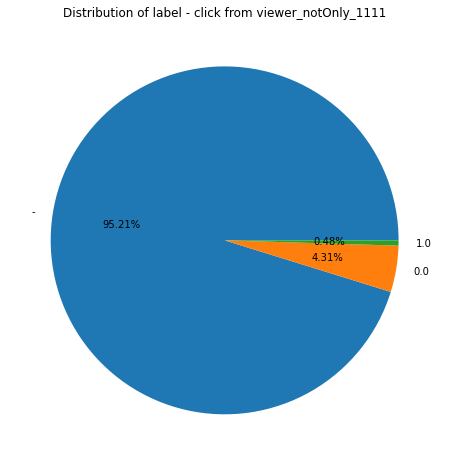

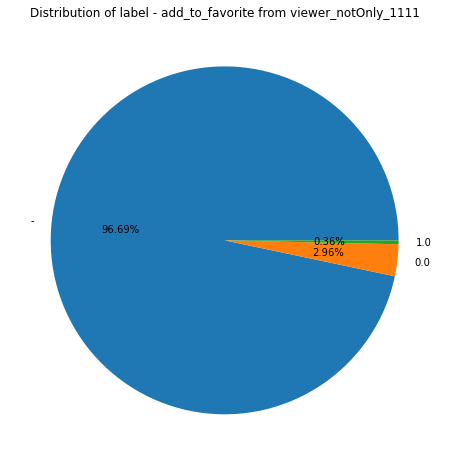

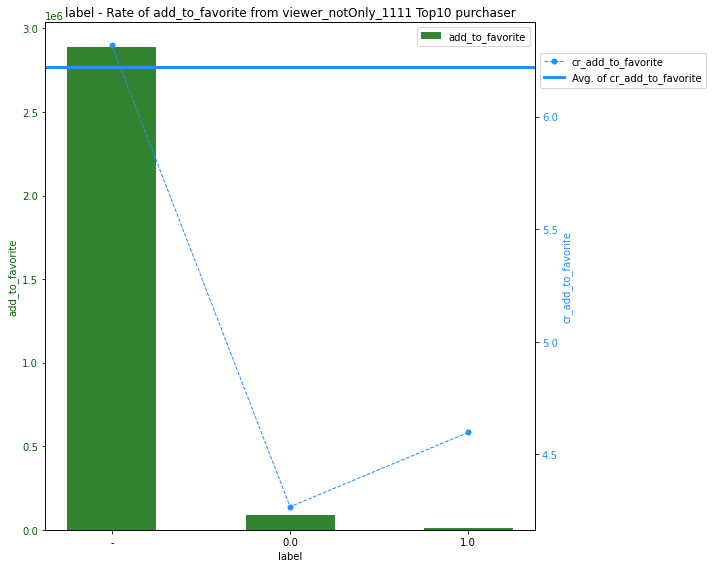

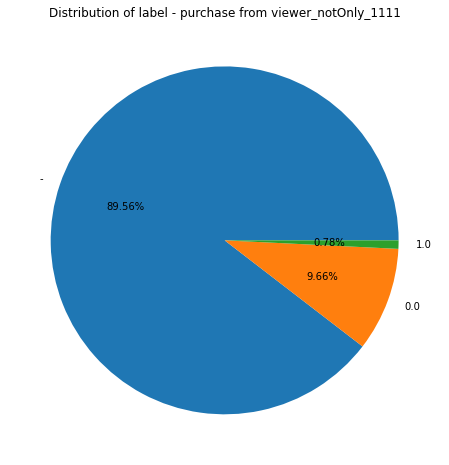

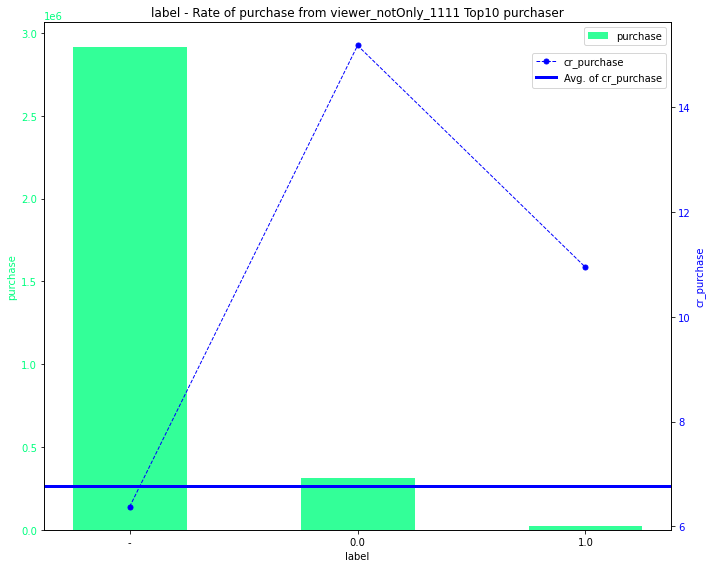

viewer_notOnly_1111: 
avg_cr_add_to_favorite:  6.22
avg_cr_purchase:  6.77


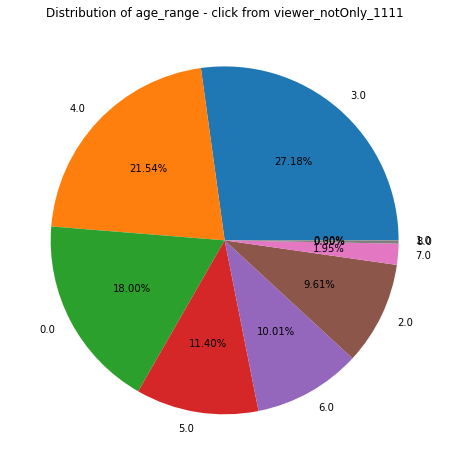

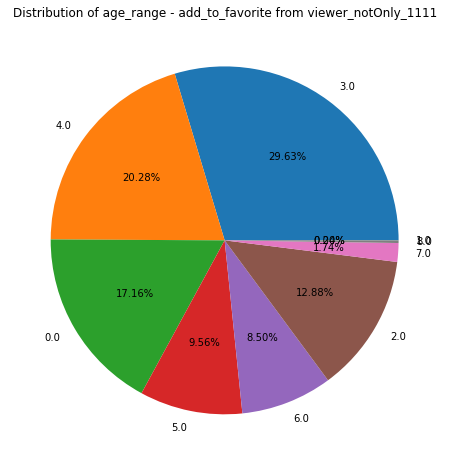

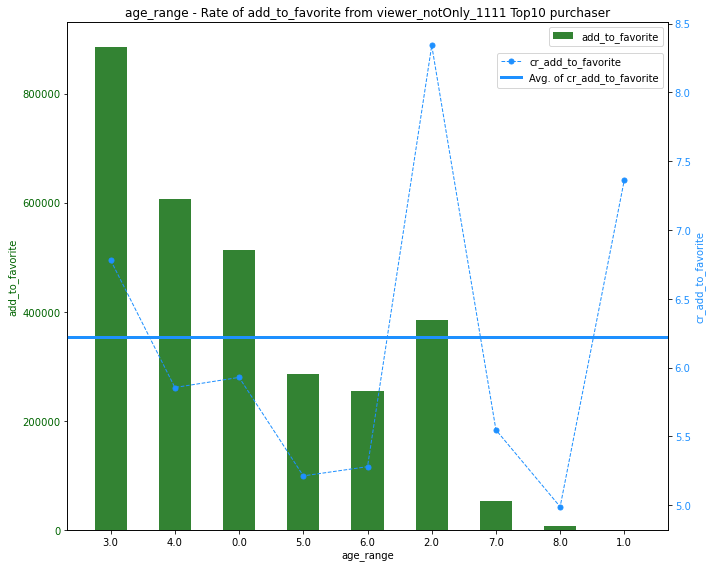

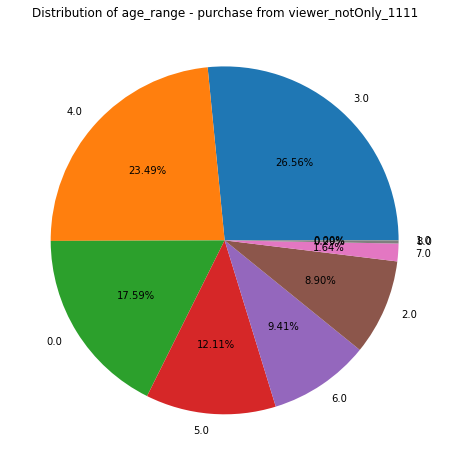

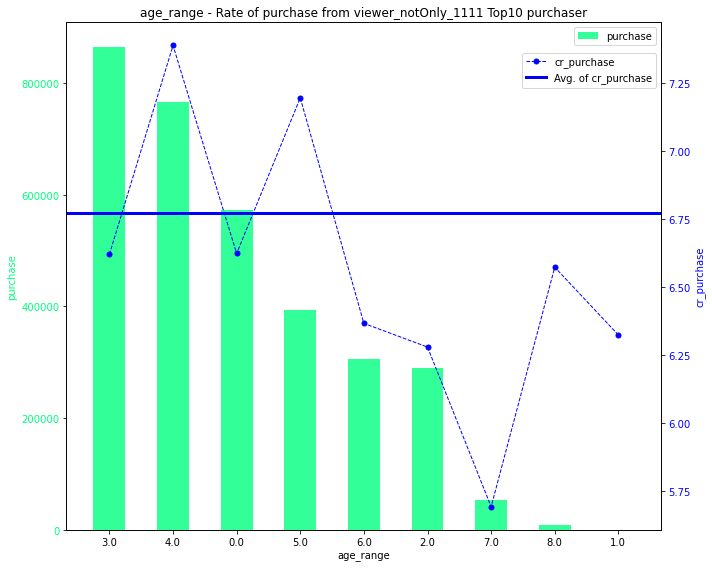

viewer_notOnly_1111: 
avg_cr_add_to_favorite:  6.22
avg_cr_purchase:  6.77


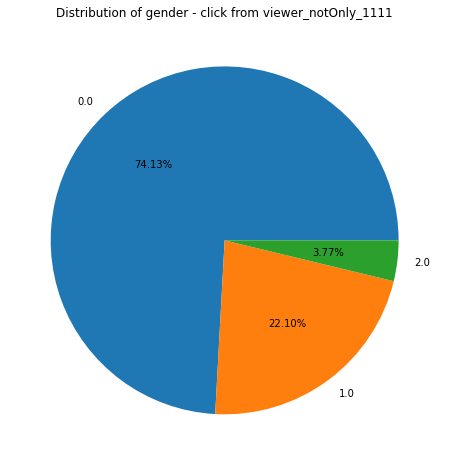

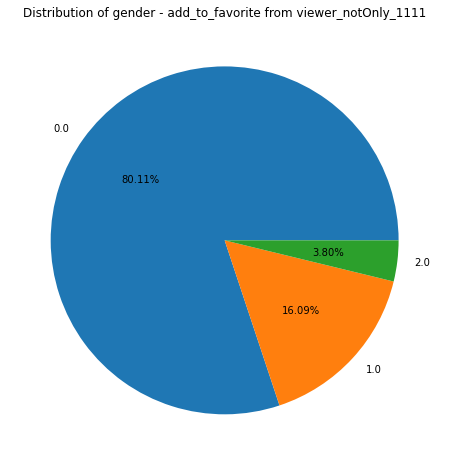

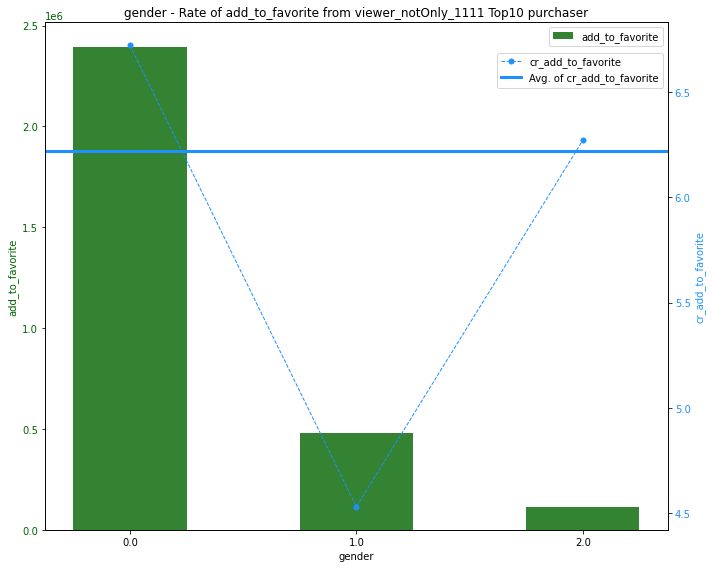

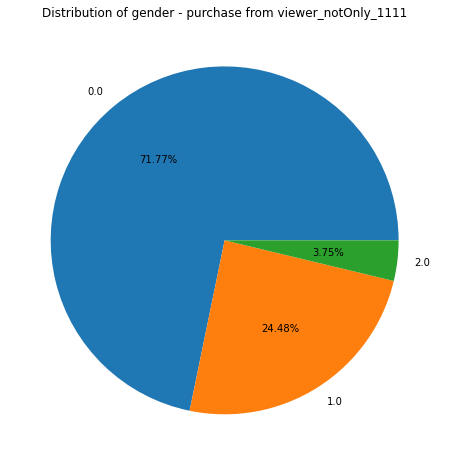

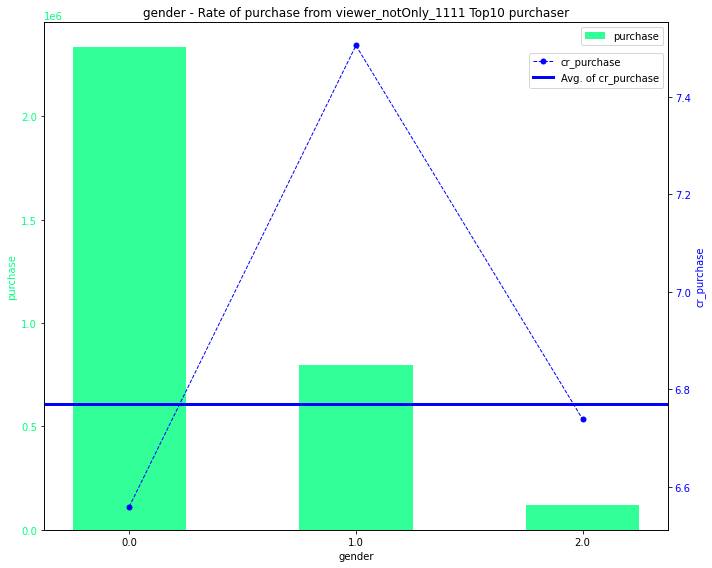

purchaser_only_1111: 
avg_cr_add_to_favorite:  6.2
avg_cr_purchase:  7.02


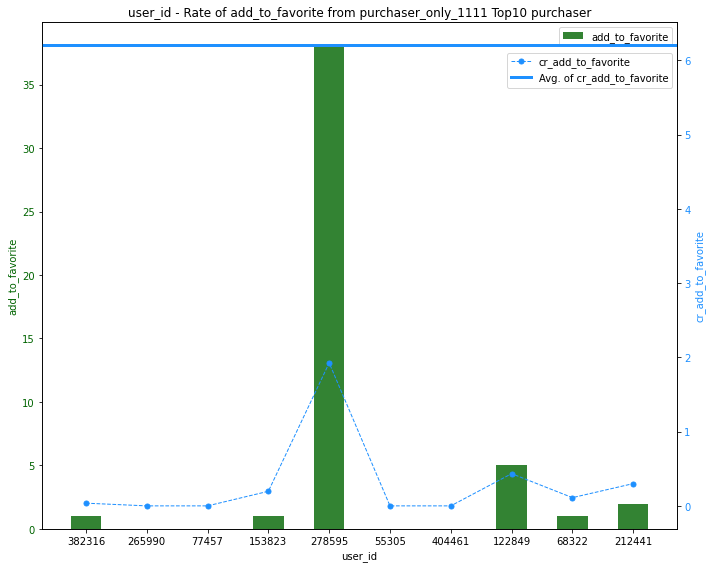

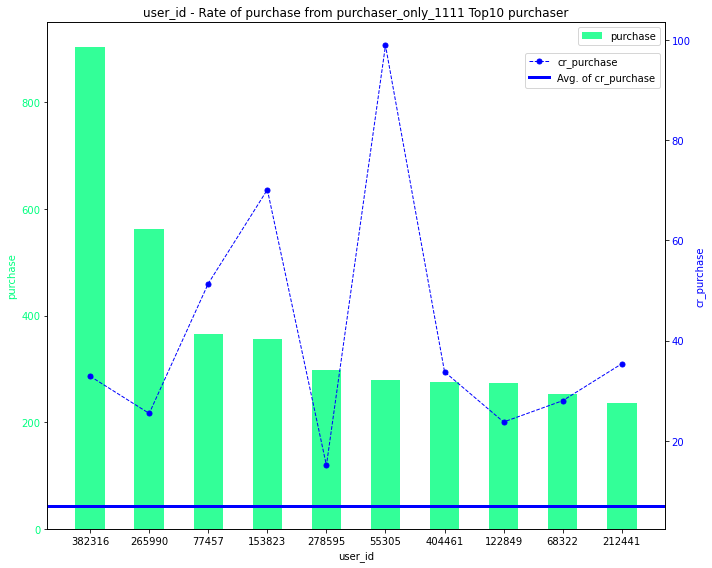

purchaser_only_1111: 
avg_cr_add_to_favorite:  6.2
avg_cr_purchase:  7.02


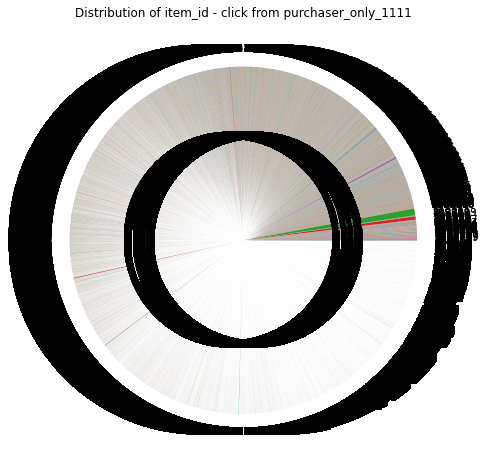

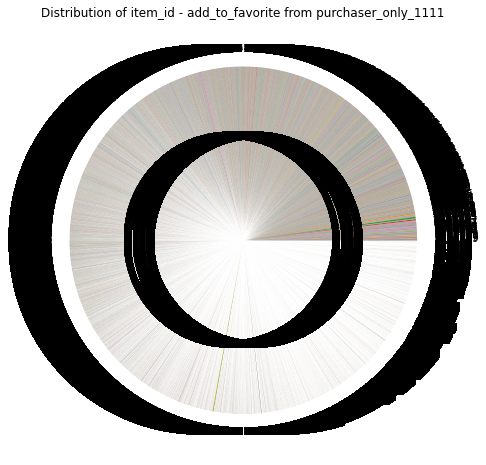

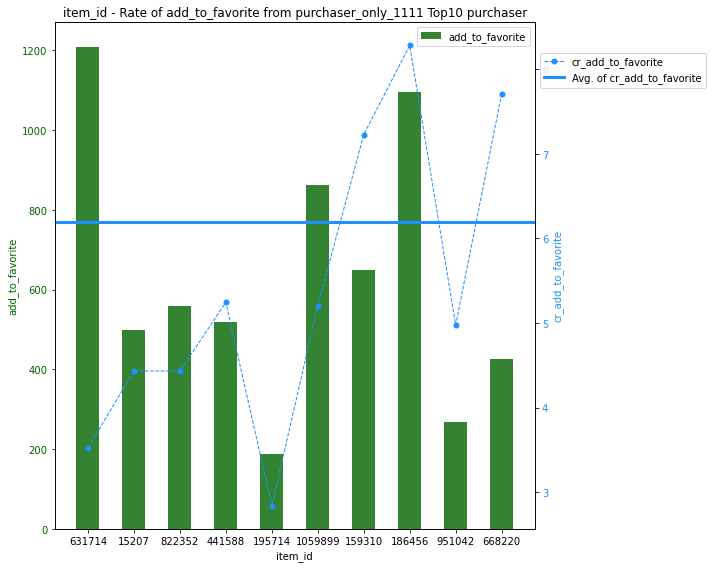

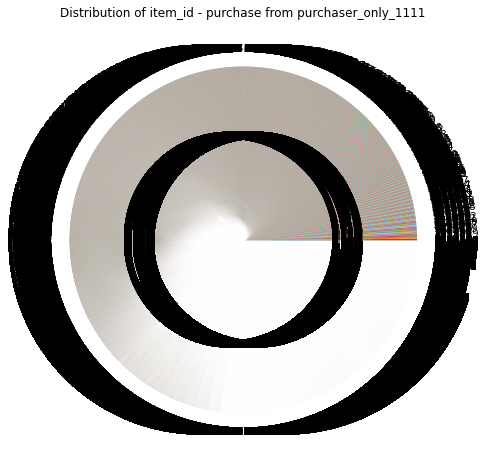

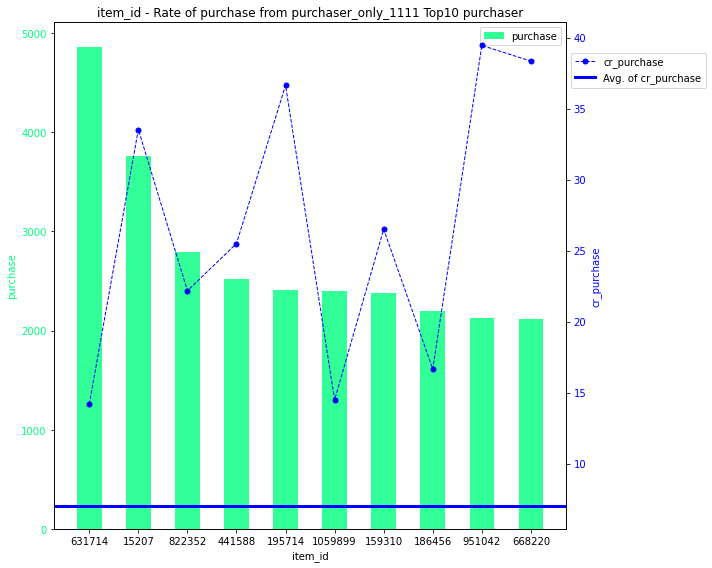

purchaser_only_1111: 
avg_cr_add_to_favorite:  6.2
avg_cr_purchase:  7.02


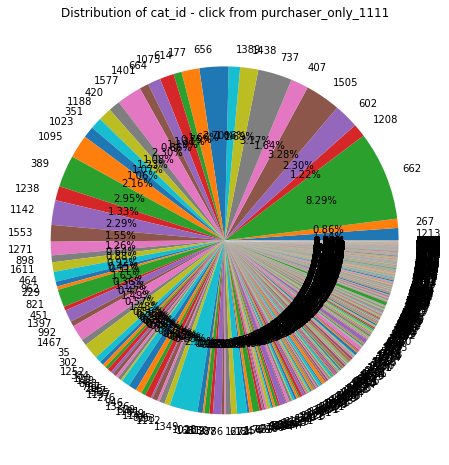

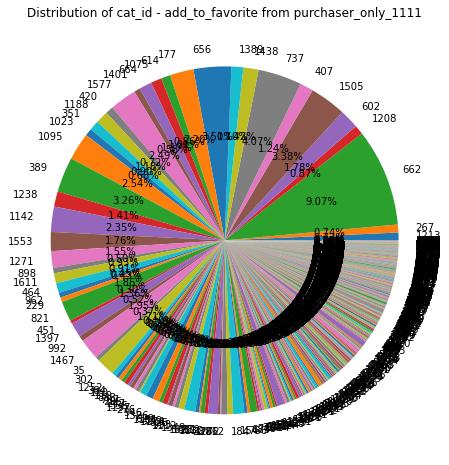

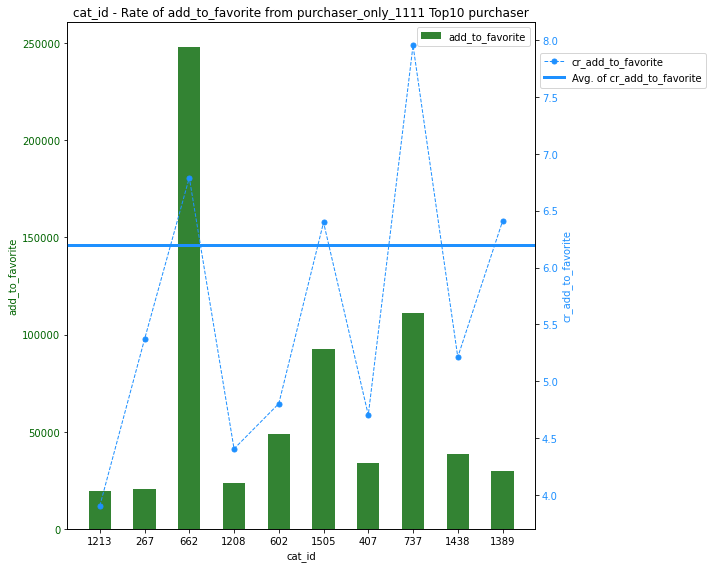

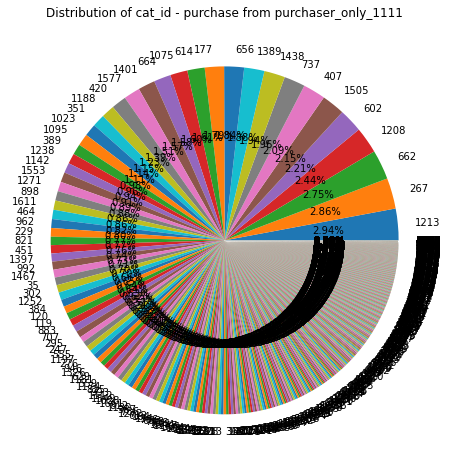

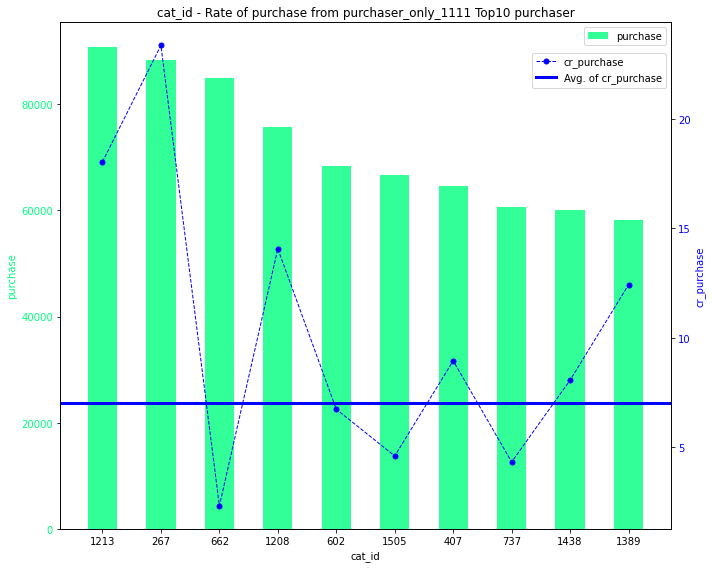

purchaser_only_1111: 
avg_cr_add_to_favorite:  6.2
avg_cr_purchase:  7.02


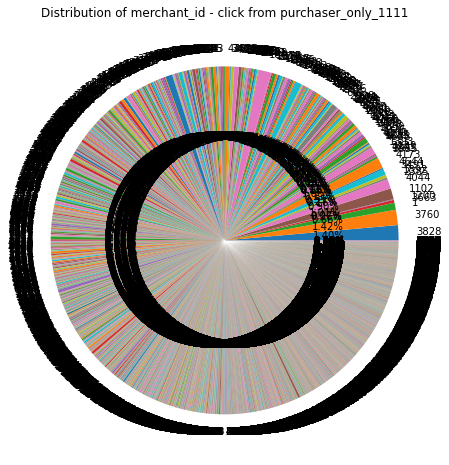

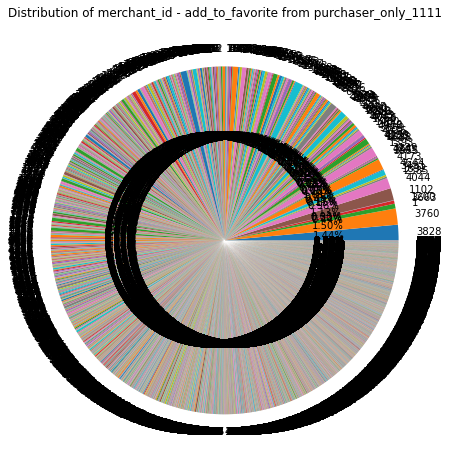

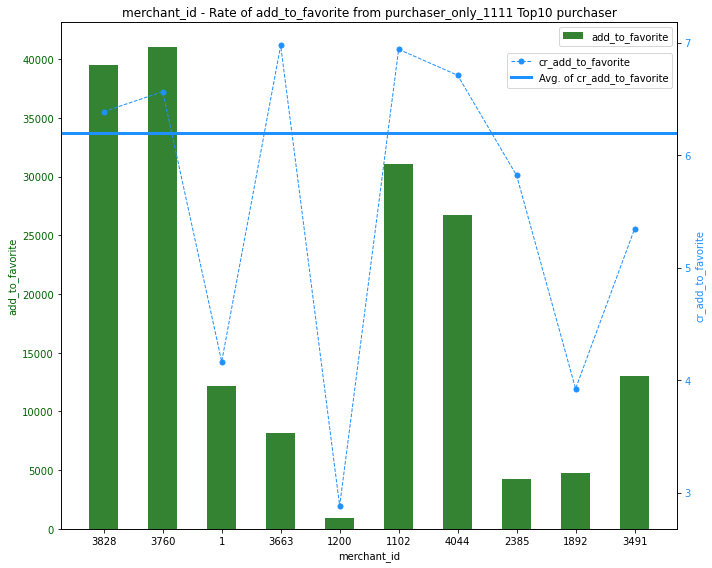

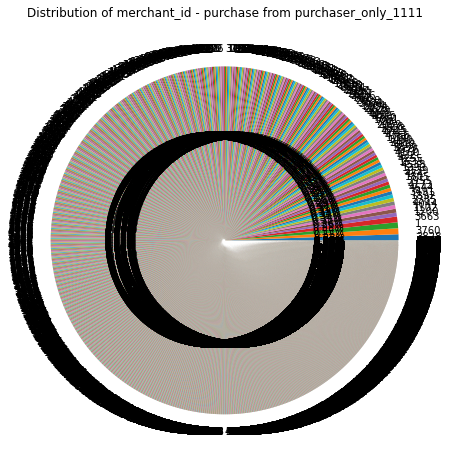

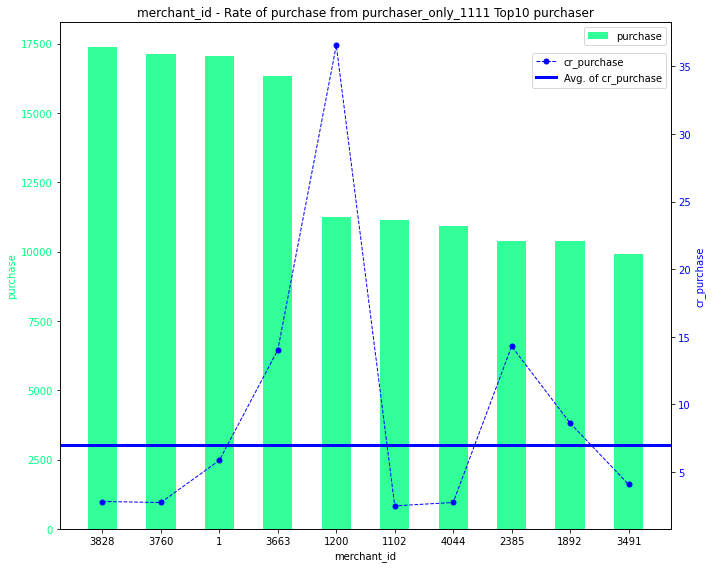

purchaser_only_1111: 
avg_cr_add_to_favorite:  6.2
avg_cr_purchase:  7.02


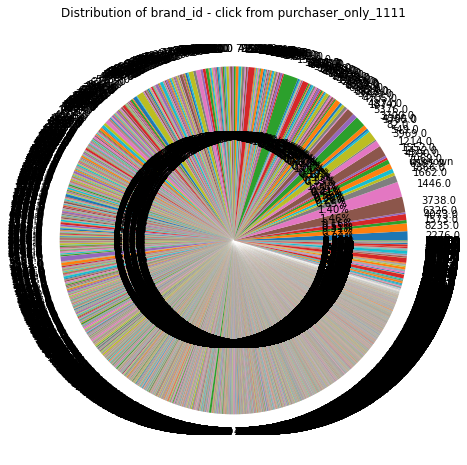

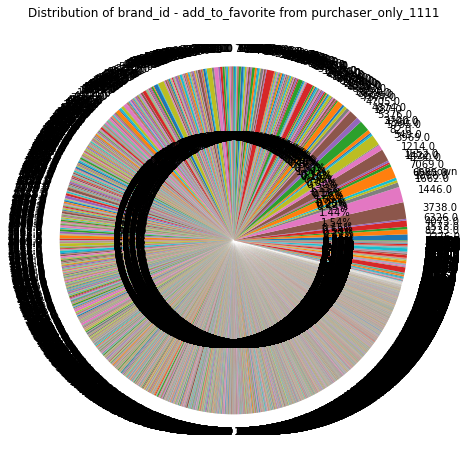

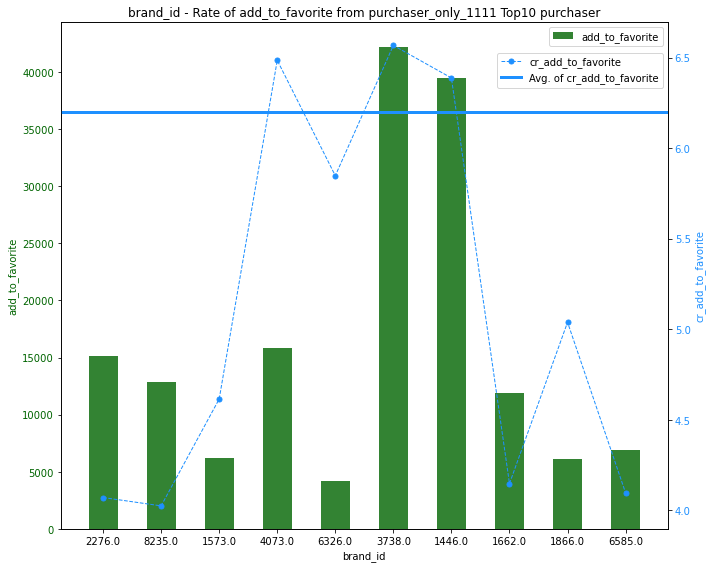

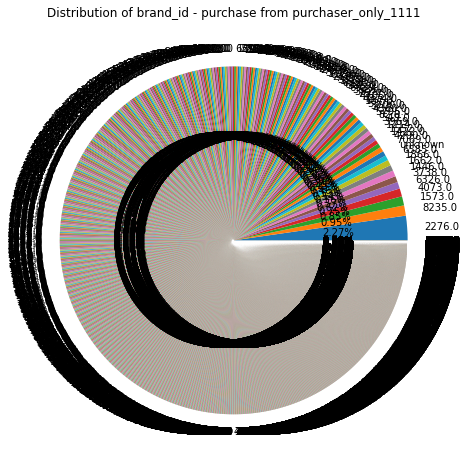

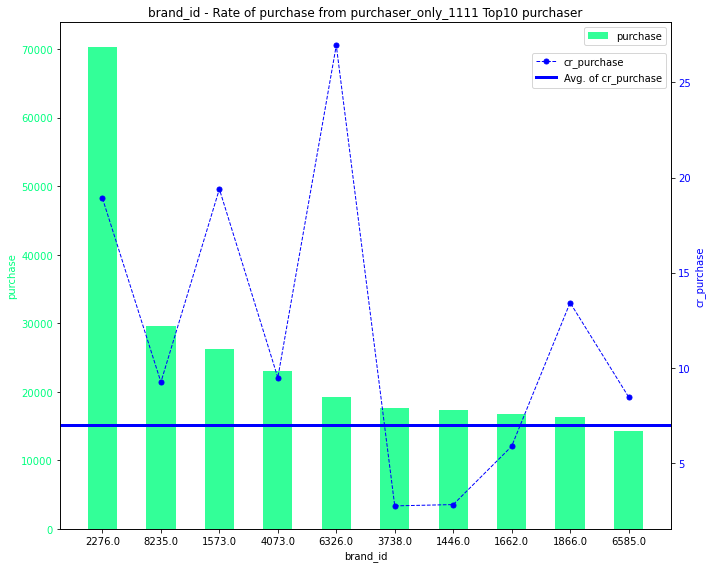

purchaser_only_1111: 
avg_cr_add_to_favorite:  6.2
avg_cr_purchase:  7.02


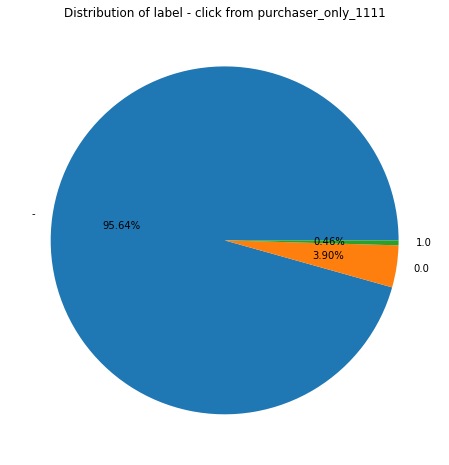

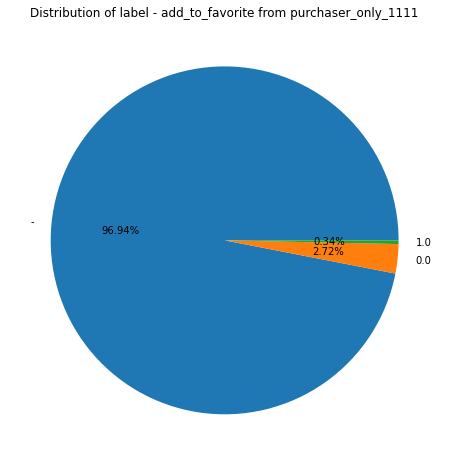

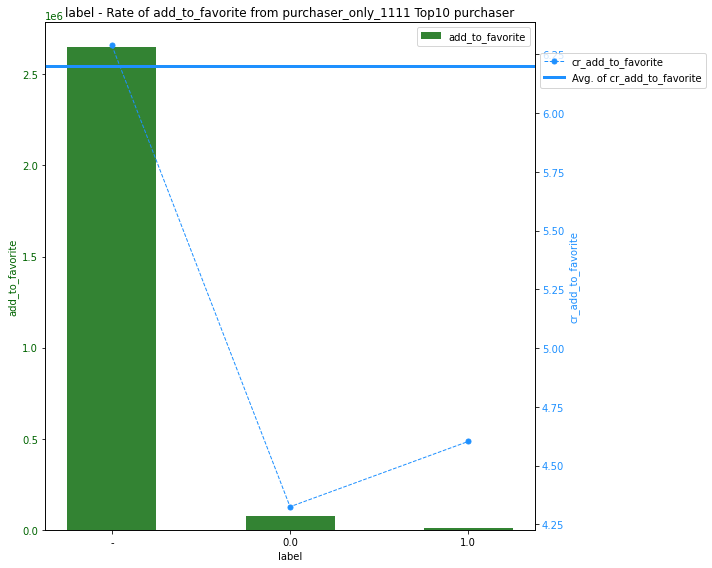

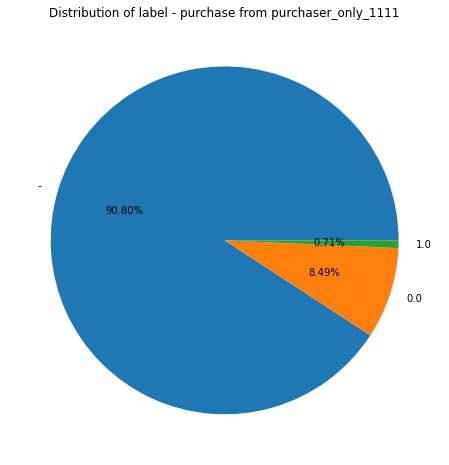

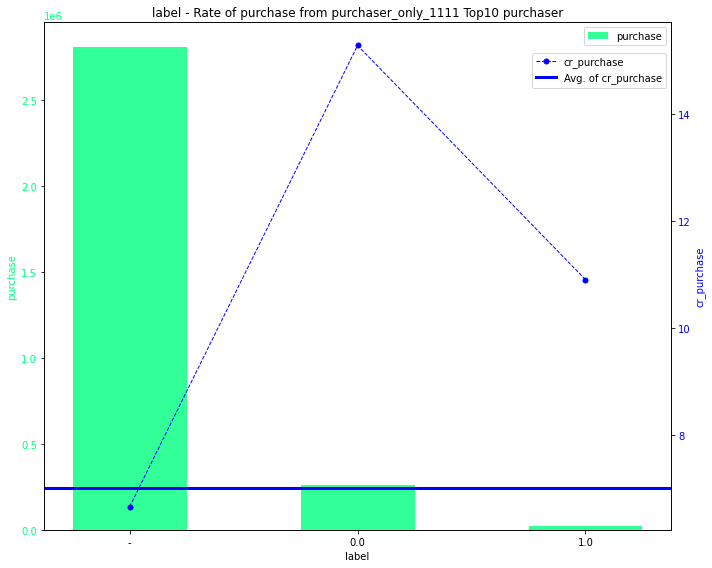

purchaser_only_1111: 
avg_cr_add_to_favorite:  6.2
avg_cr_purchase:  7.02


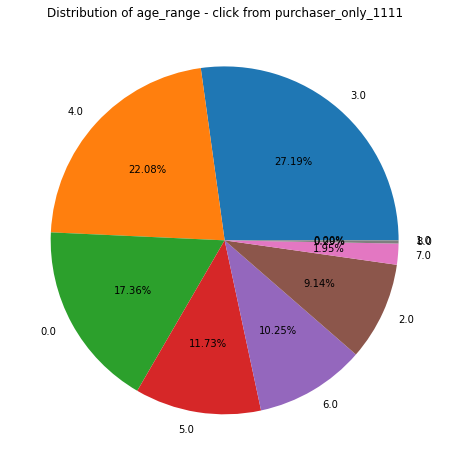

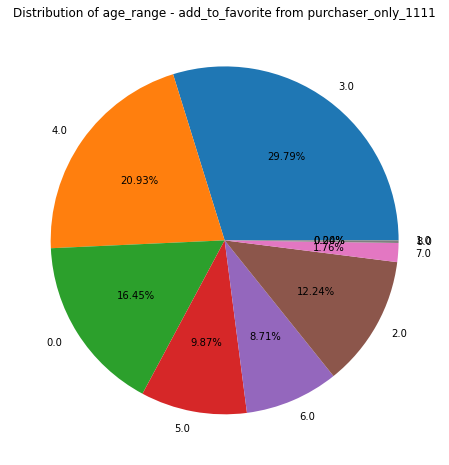

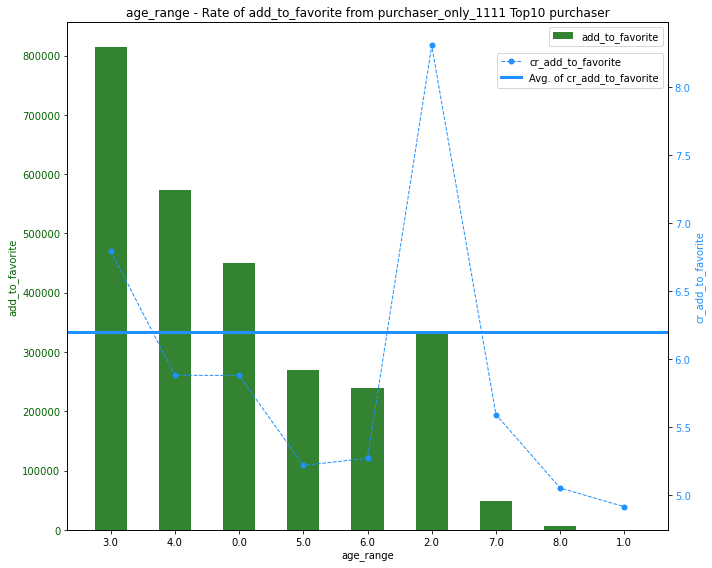

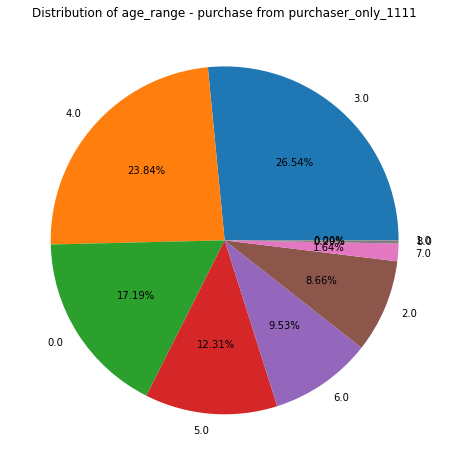

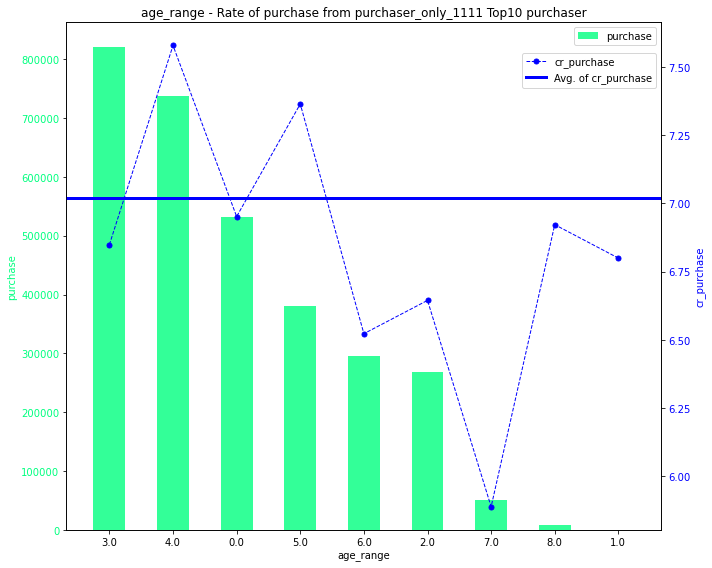

purchaser_only_1111: 
avg_cr_add_to_favorite:  6.2
avg_cr_purchase:  7.02


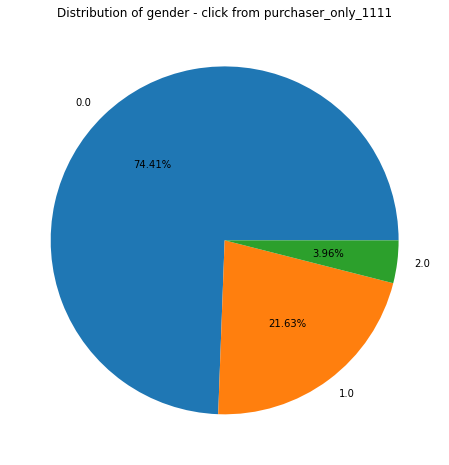

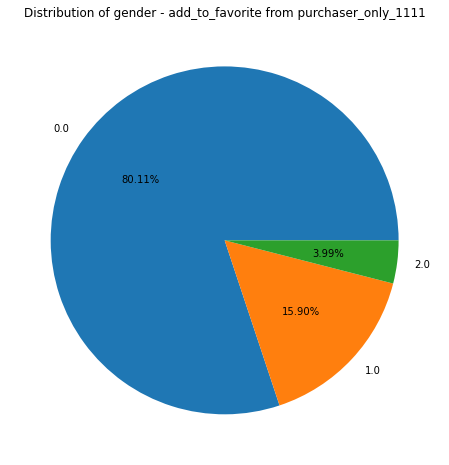

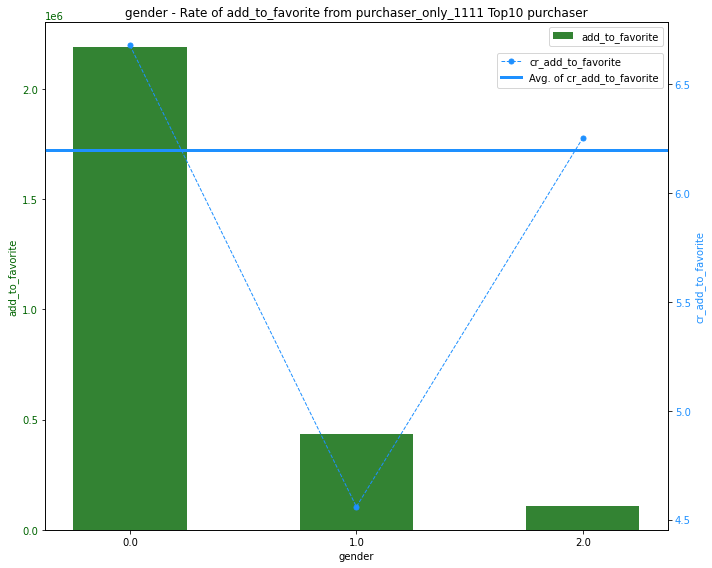

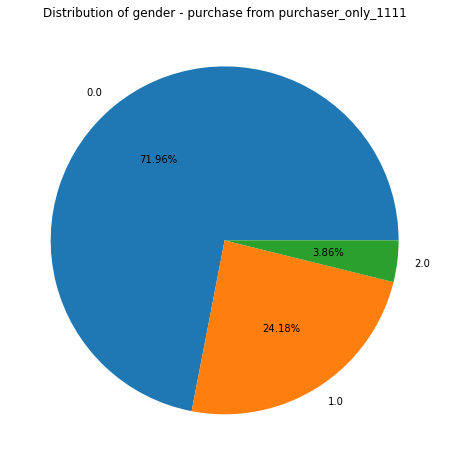

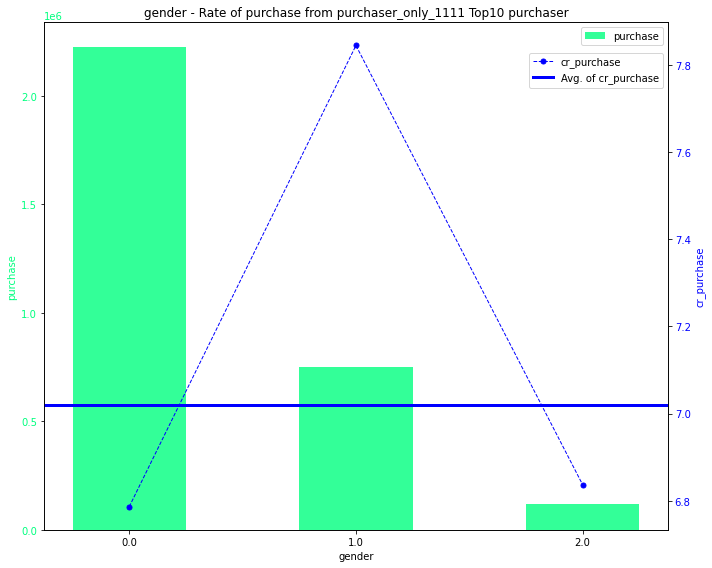

purchaser_notOnly_1111: 
avg_cr_add_to_favorite:  6.07
avg_cr_purchase:  4.43


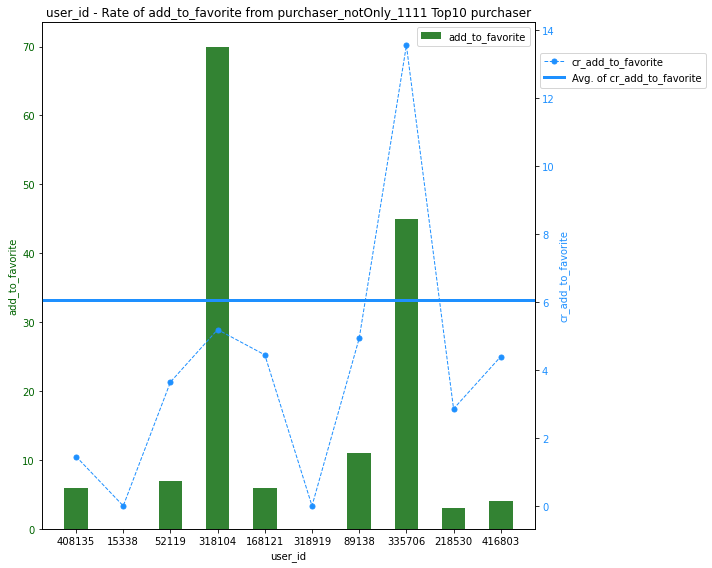

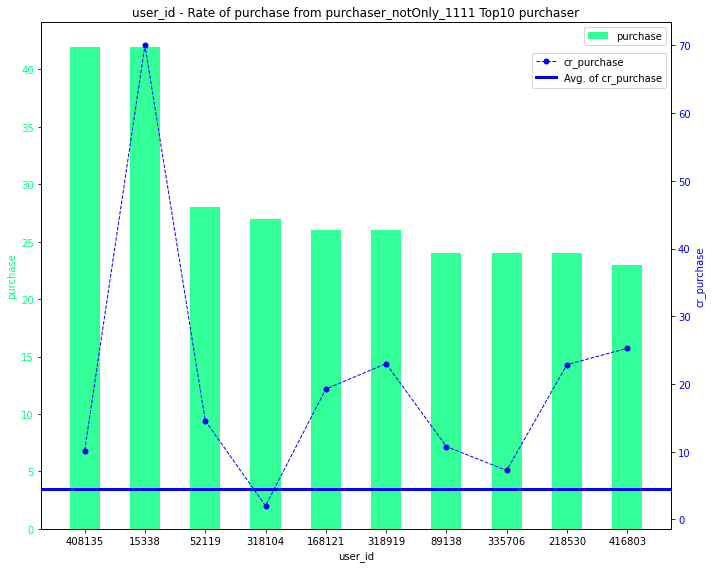

purchaser_notOnly_1111: 
avg_cr_add_to_favorite:  6.07
avg_cr_purchase:  4.43


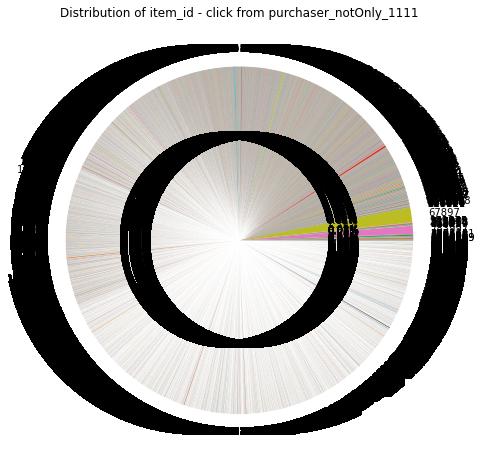

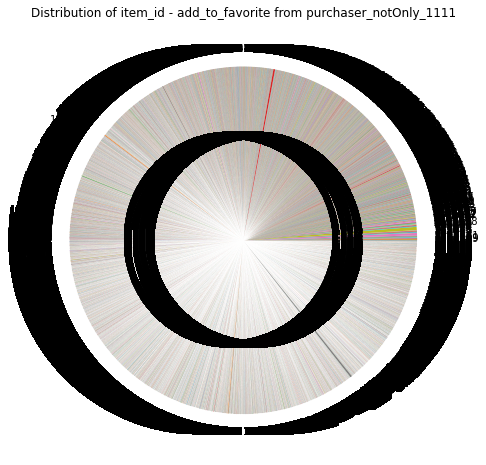

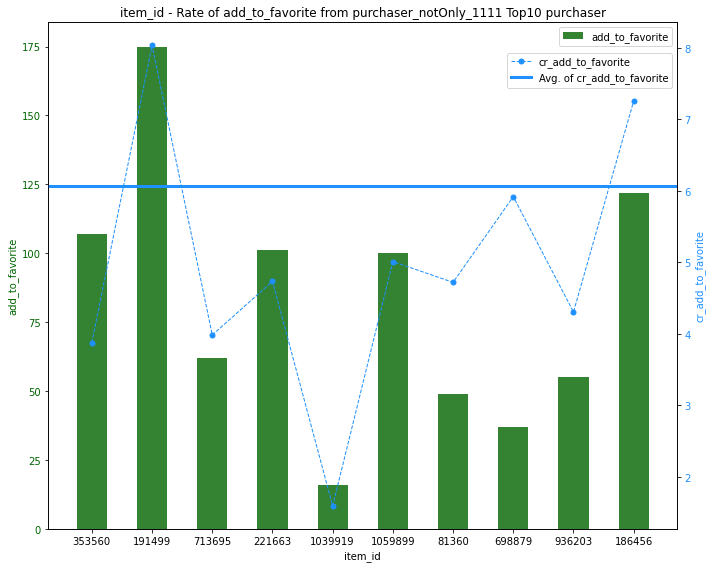

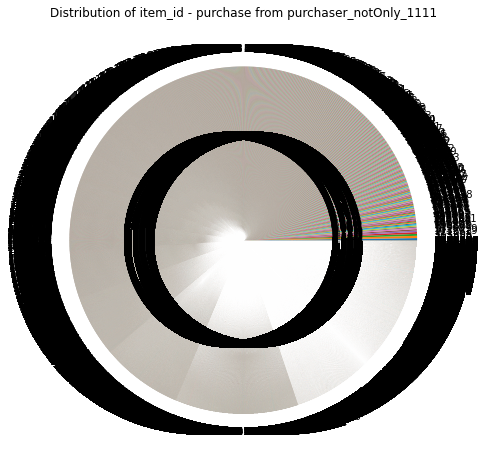

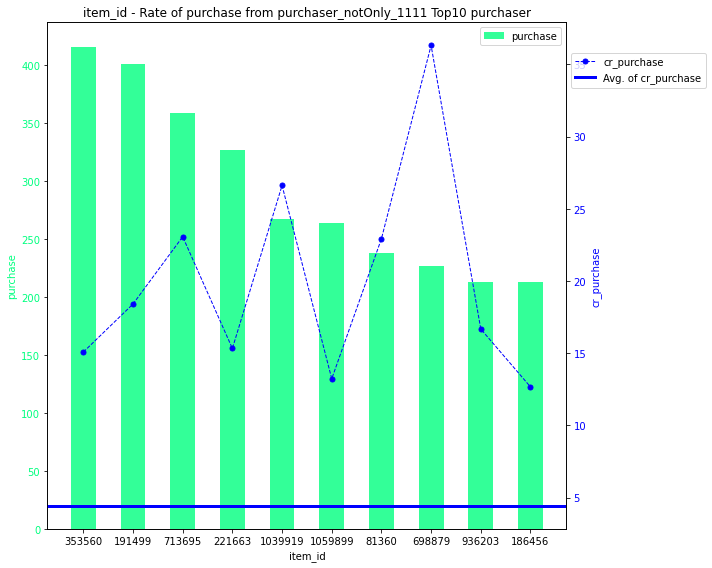

purchaser_notOnly_1111: 
avg_cr_add_to_favorite:  6.07
avg_cr_purchase:  4.43


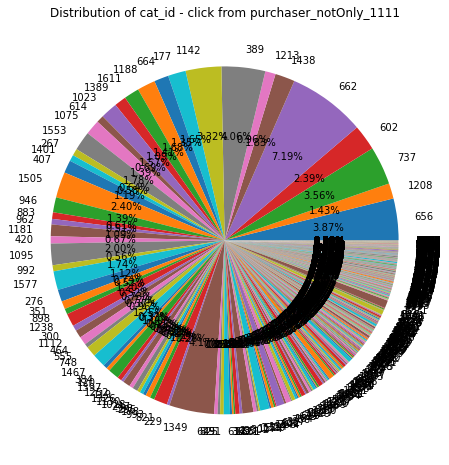

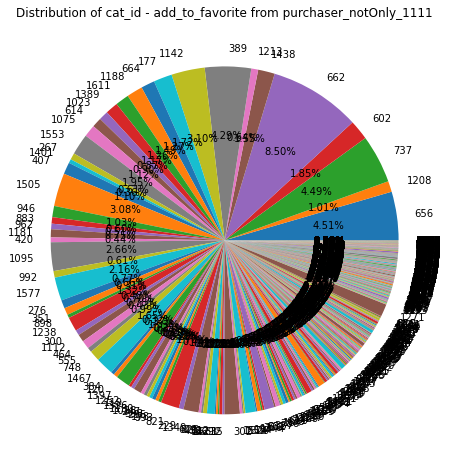

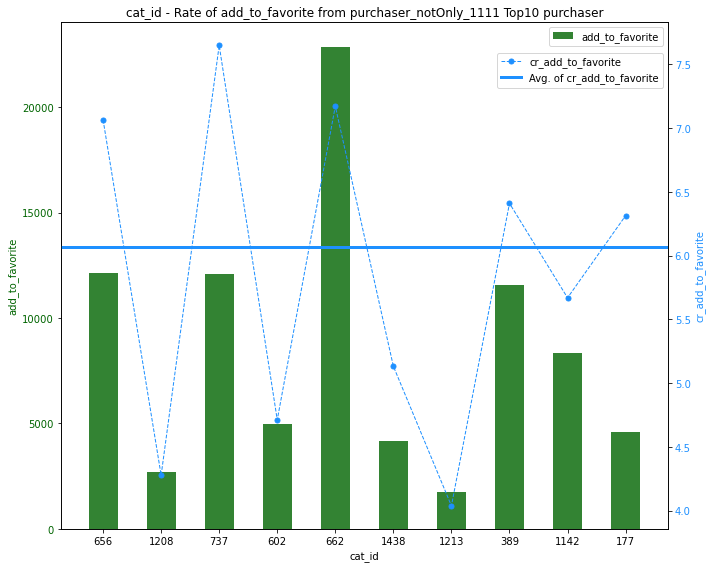

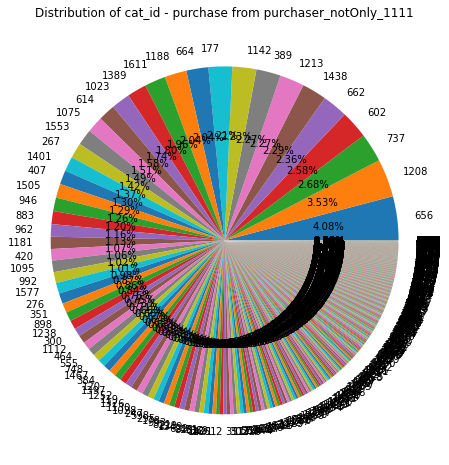

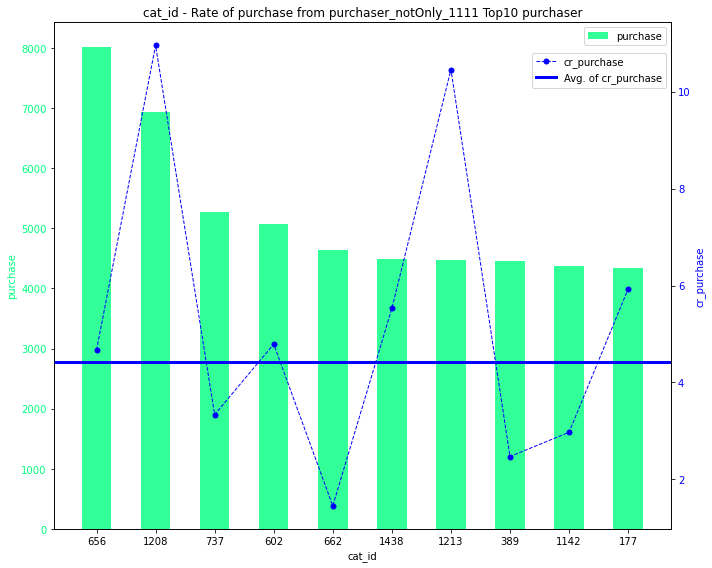

purchaser_notOnly_1111: 
avg_cr_add_to_favorite:  6.07
avg_cr_purchase:  4.43


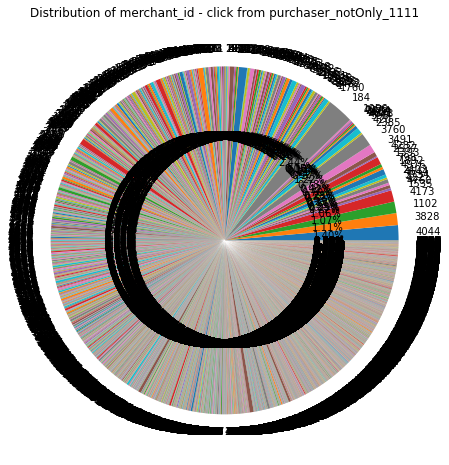

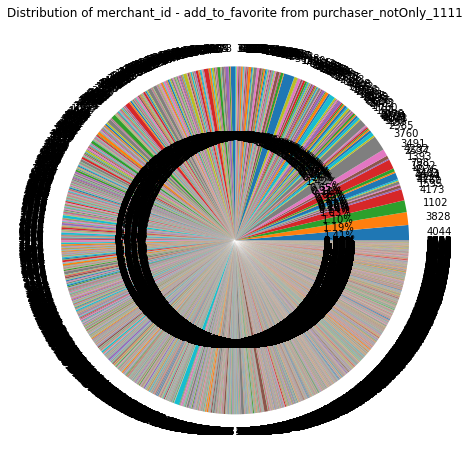

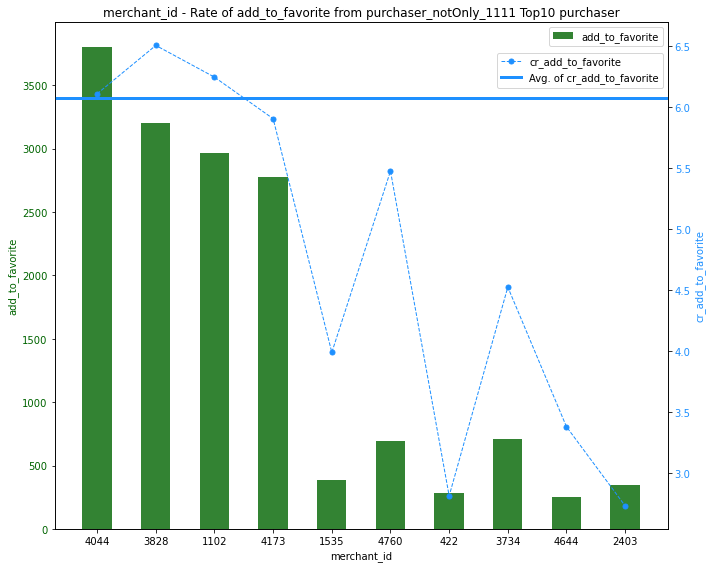

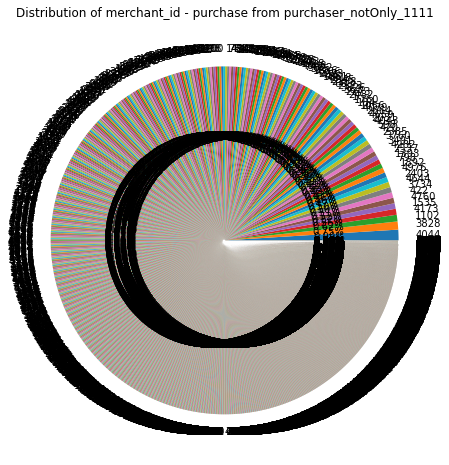

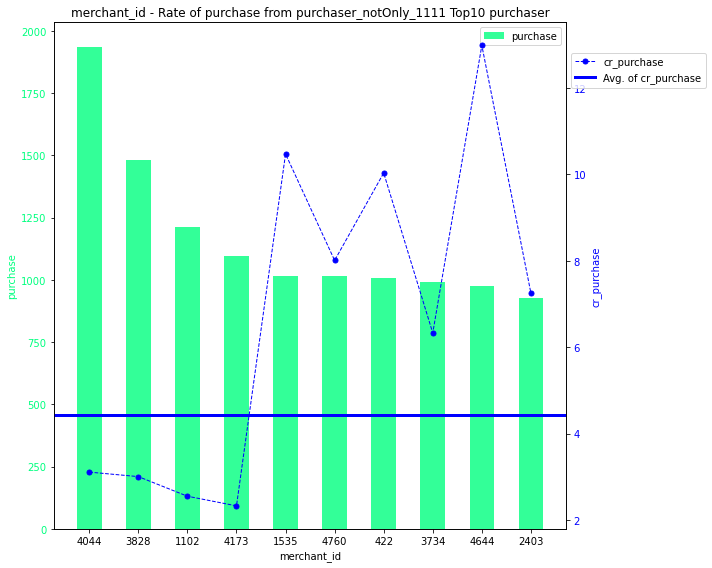

purchaser_notOnly_1111: 
avg_cr_add_to_favorite:  6.07
avg_cr_purchase:  4.43


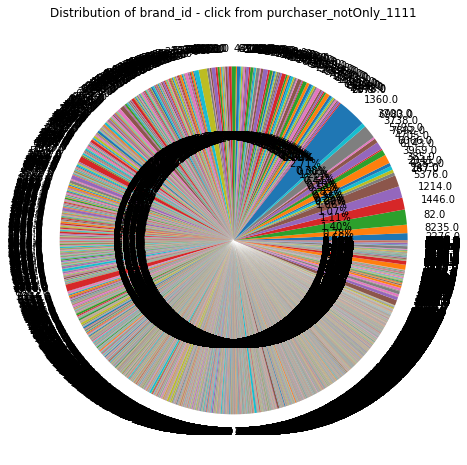

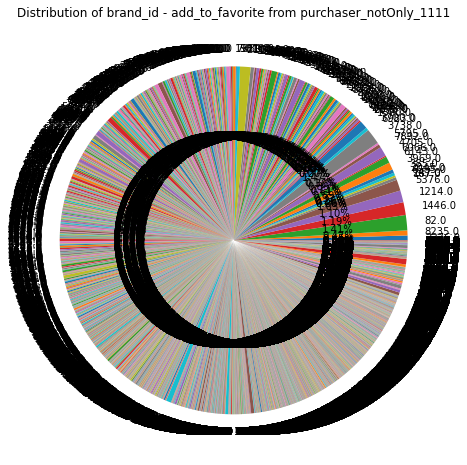

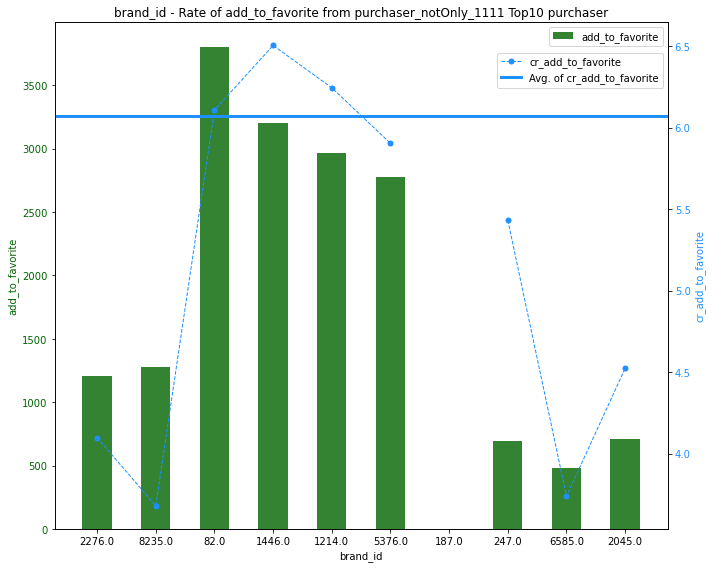

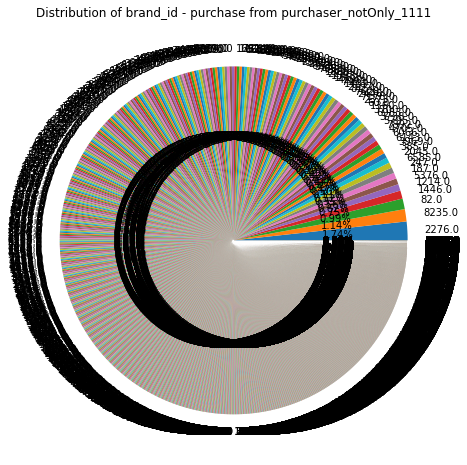

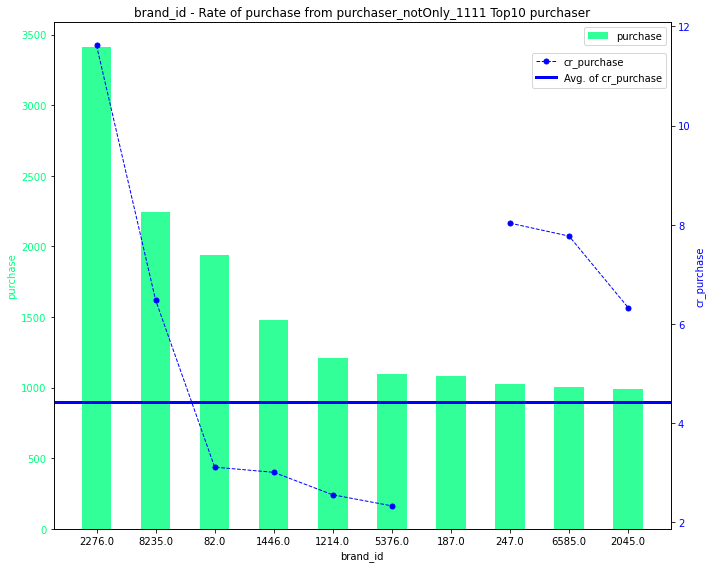

purchaser_notOnly_1111: 
avg_cr_add_to_favorite:  6.07
avg_cr_purchase:  4.43


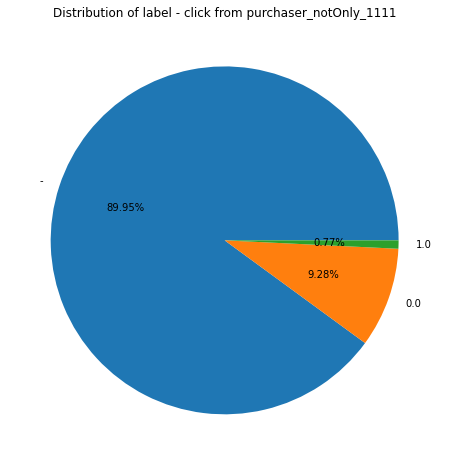

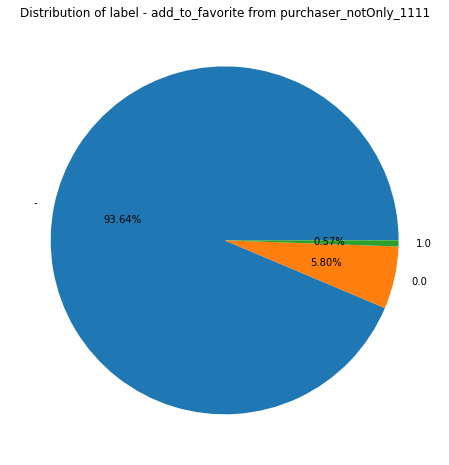

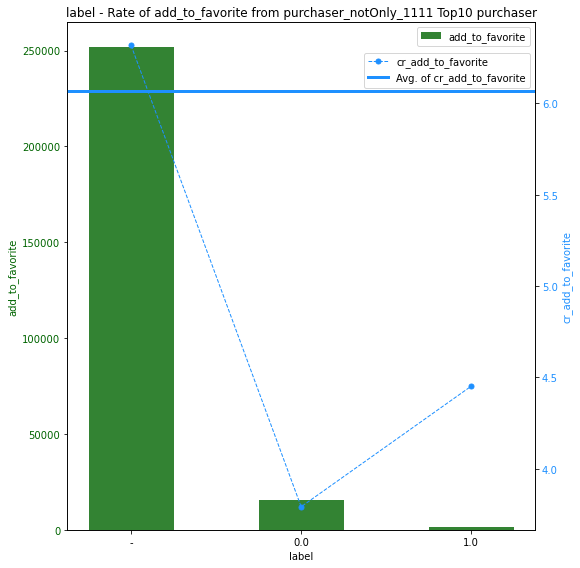

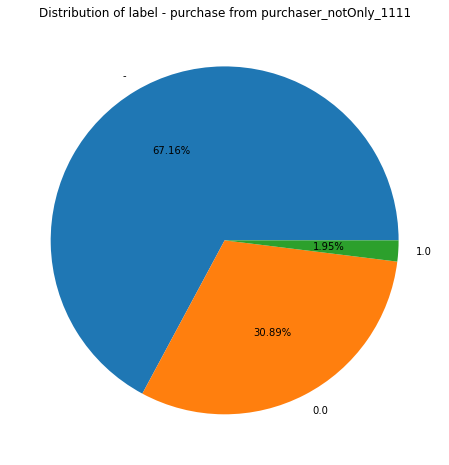

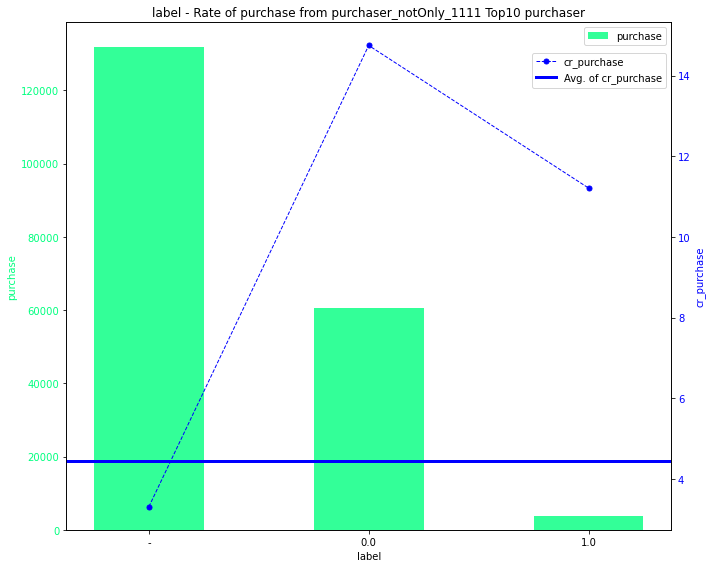

purchaser_notOnly_1111: 
avg_cr_add_to_favorite:  6.07
avg_cr_purchase:  4.43


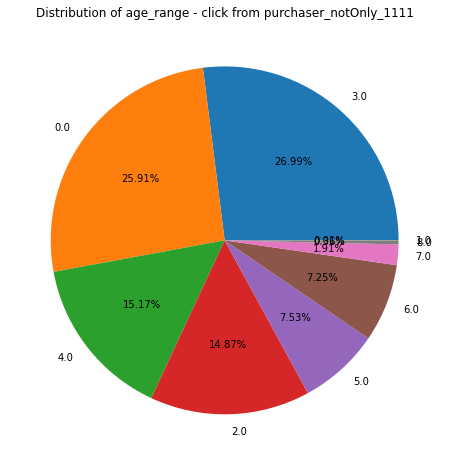

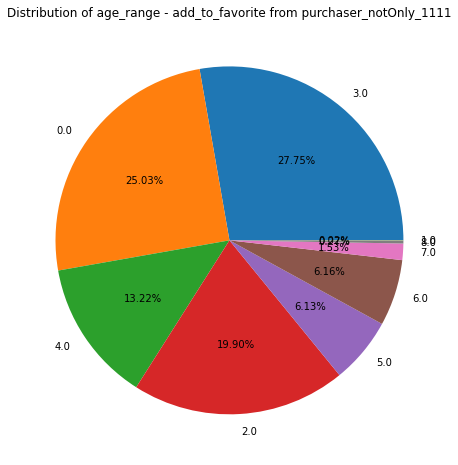

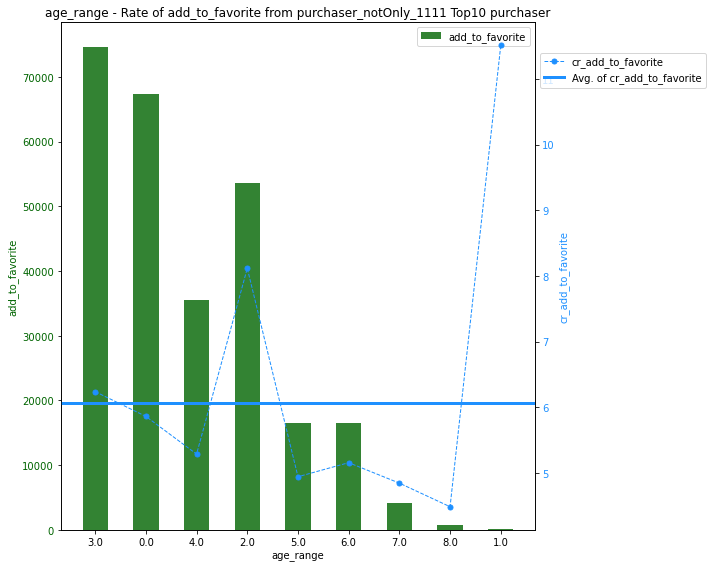

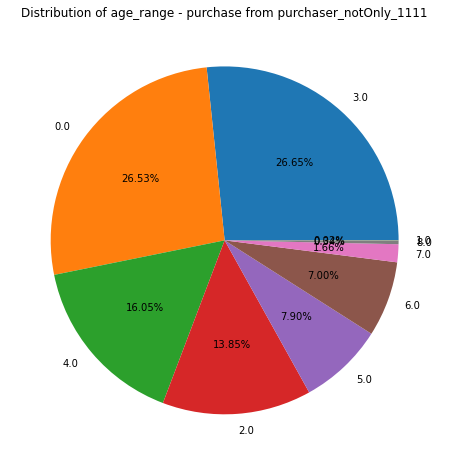

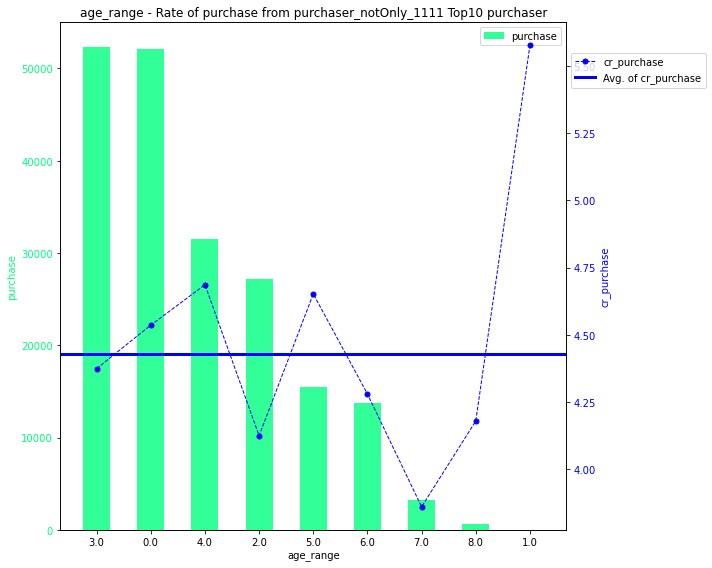

purchaser_notOnly_1111: 
avg_cr_add_to_favorite:  6.07
avg_cr_purchase:  4.43


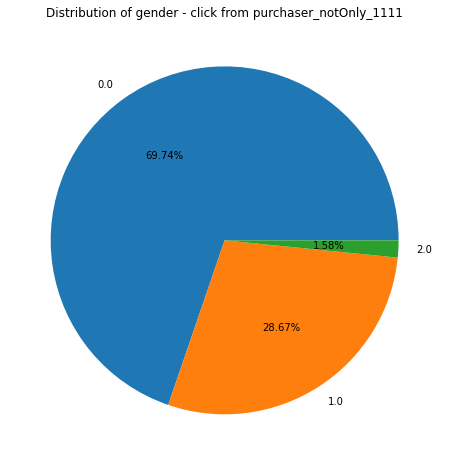

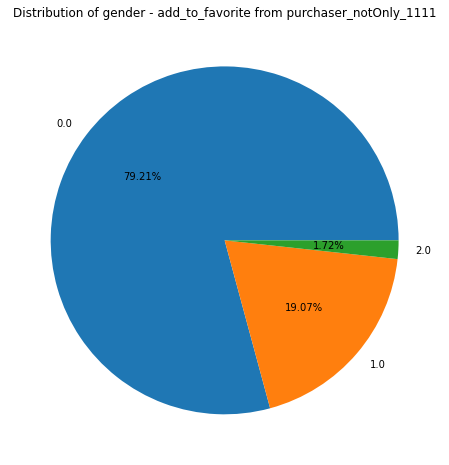

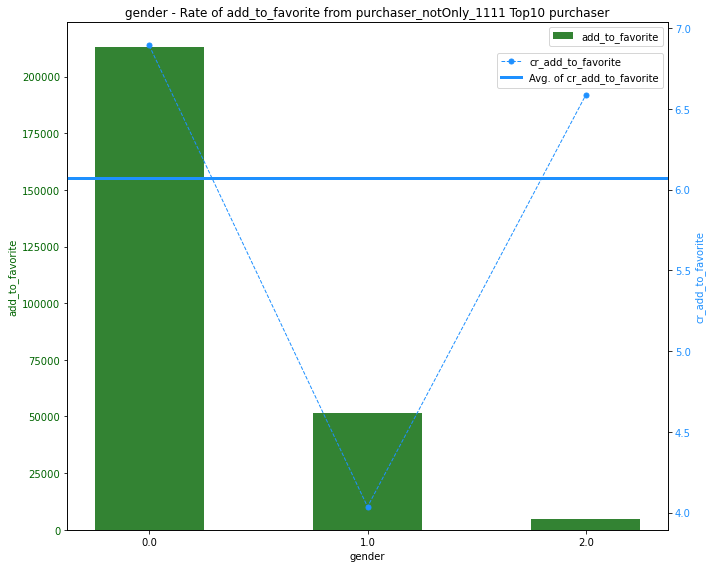

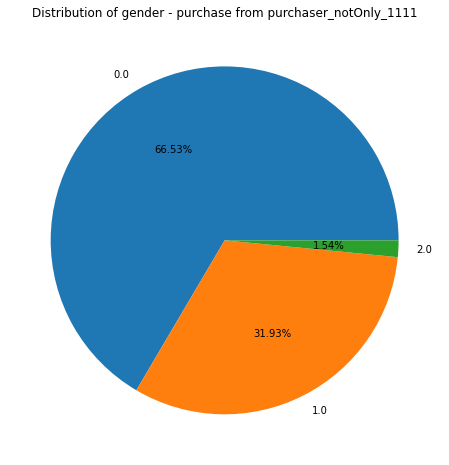

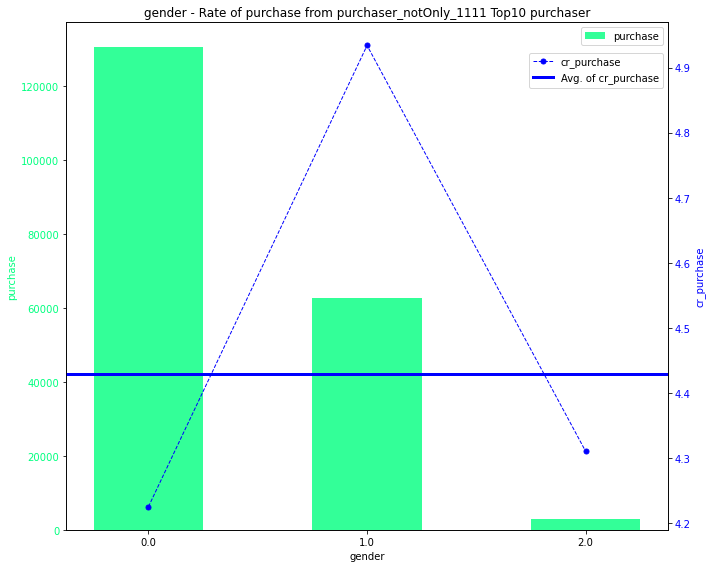

In [130]:
### 2. 這群人銃著雙11而來的人，和非雙11才來的人，購買的品類／商家／品牌、以及用戶屬性的不同點

user_groups = [viewer_only_1111, viewer_notOnly_1111, purchaser_only_1111, purchaser_notOnly_1111]
user_group_labels = ['viewer_only_1111', 'viewer_notOnly_1111', 'purchaser_only_1111', 'purchaser_notOnly_1111']
dimensions = ['user_id','item_id','cat_id','merchant_id','brand_id','label','age_range','gender']
action_list = ['click','add_to_favorite','purchase']

for group_id in range(0, len(user_groups)):

    for dimension in dimensions:

        print(f'{user_group_labels[group_id]}: ')
        tmp_3 = df[df['user_id'].isin(user_groups[group_id])].groupby([dimension])['click','add_to_favorite','purchase'].sum().reset_index().sort_values('purchase', ascending=False)
    #     tmp_3[f'{action}_percentage'] = tmp_3[action] / tmp_3[action].sum() *100
    #     tmp_3['compare_to_avg'] = tmp_3['percentage'] - np.mean(tmp_3['percentage'].values)  # 高(+)/低(-)於平均值多少
        tmp_3['cr_add_to_favorite'] = tmp_3['add_to_favorite'] / tmp_3['click'] *100
        tmp_3['cr_purchase'] = tmp_3['purchase'] / tmp_3['click'] *100
        avg_cr_add_to_favorite = round(tmp_3['add_to_favorite'].sum() / tmp_3['click'].sum() *100, 2)
        print('avg_cr_add_to_favorite: ', avg_cr_add_to_favorite)
        avg_cr_purchase = round(tmp_3['purchase'].sum() / tmp_3['click'].sum() *100, 2)
        print('avg_cr_purchase: ', avg_cr_purchase)
        tmp_3['cr_add_to_favorite_compare'] = tmp_3['cr_add_to_favorite'] - avg_cr_add_to_favorite  # 高(+)/低(-)於平均值多少
        tmp_3['cr_purchase_compare'] = tmp_3['cr_purchase'] - avg_cr_purchase  # 高(+)/低(-)於平均值多少
        tmp_3.head(10)

        for action in action_list:

            if dimension not in ['user_id','item_id','merchant_id','brand_id']:
                
                plt.figure(figsize=(8,8))
                plt.pie(x=tmp_3[action], labels=tmp_3[dimension].unique(), autopct='%1.2f%%')
                plt.title(f'Distribution of {dimension} - {action} from {user_group_labels[group_id]}')
                plt.show();

            if action in ['add_to_favorite', 'purchase']:
                
                if action == 'add_to_favorite':
                    color = ['darkgreen','dodgerblue']
                else:
                    color = ['springgreen','blue']

                avg_cr = round(tmp_3[action].sum() / tmp_3['click'].sum() *100, 2)
                tmp_4 = tmp_3.sort_values('purchase', ascending=False).head(10)
#                 print(tmp_4)

                indexes = np.arange(len(tmp_4))
                # https://matplotlib.org/gallery/api/two_scales.html
                fig, ax1 = plt.subplots(1, 1, figsize=(10,8))
                ax1.set_xlabel(str(dimension))
                ax1.set_ylabel(str(action), color=color[0])
                ax1.bar(indexes, tmp_4[action], 0.5, alpha=0.8, color=color[0])
                ax1.tick_params(axis='y', labelcolor=color[0])
                ax1.legend([str(action)])
                
                ax2 = ax1.twinx()
                ax2.set_ylabel(f'cr_{action}', color=color[1])
                ax2.plot(indexes, tmp_4[f'cr_{action}'], color=color[1], marker='o', linestyle='dashed', linewidth=1, markersize=5)
                ax2.axhline(y=avg_cr, color=color[1], linestyle='-', linewidth=3)
                ax2.tick_params(axis='y', labelcolor=color[1])
                ax2.legend([f'cr_{action}', f'Avg. of cr_{action}'], bbox_to_anchor=(1,0.95))
                
                plt.title(f'{dimension} - Rate of {action} from {user_group_labels[group_id]} Top10 purchaser')
                plt.xticks(indexes, [str(item) for item in tmp_4[dimension]])
                
                fig.tight_layout()
                plt.show();


plt.show();


[敘述性分析]
0. 整個時間軸的流量及銷售消長（確認有沒有沒 catch 到的活動日）
    - 617/618 理想生活狂歡季
    - 626 年中大促
    - 909 天貓99大促
    - 10月中感覺有帶狀活動，每日銷售比7,8月高一點點
    - 1111 天貓雙11
1. 雙11當天的銷售／轉換率在 品類／商家／品牌／用戶屬性 中的分布
2. 有多少比例是雙11當天才進站瀏覽／購買；這群人，和非雙11才來的人，購買的品類／商家／品牌、以及用戶屬性的不同點
3. 雙11的這前6個月，隨月份／星期幾／月初月中月底 的 流量／銷售消長或規律
4. 雙11的這前6個月，銷售／轉換率在 品類／商家／品牌／用戶屬性 中的分布

[爆款主題]
0. 平日／雙11當天，是否在單一商品有流量／銷售高點
1. 平日的爆款和時間點能夠被預測嗎？
2. 雙11的爆款能夠被預測嗎？
